# Muller-Brown potential: analysis of the BERT models

# Import

In [1]:
import copy

In [2]:
import joblib

In [3]:
# IMPORT PACKAGES
import numpy as np
import torch
import lightning as pl

In [4]:
import warnings
warnings.filterwarnings('ignore', category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

In [5]:
import seaborn as sns

In [6]:
import pandas as pd

In [7]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, mean_squared_error, mean_absolute_error

In [8]:
import sys
sys.path.append("../../mlcolvar/")

In [9]:
from mlcolvar.utils.plot import plot_metrics

In [10]:
# IMPORT HELPER FUNCTIONS
from mlcolvar.utils.plot import muller_brown_potential, plot_isolines_2D, \
    plot_metrics, plot_gradient_2D

In [11]:
from mlcolvar.utils.io import create_dataset_from_files
from mlcolvar.data import DictModule

In [12]:
from mlcolvar.utils.trainer import MetricsCallback

In [13]:
from mlcolvar.utils.fes import compute_fes

In [14]:
from typing import Optional


In [15]:
from torch.utils.data import DataLoader, Dataset


In [16]:
sys.path.append("../src/")
sys.path.append("../src/transformers/src/")

In [17]:
from transformers import BertConfig

In [18]:
import modelling_md as modelling
import utils
import plotting

In [19]:
import bertviz

In [20]:
from bertviz import head_view, model_view

## Matplotlib settings

Poster:

In [21]:
# import matplotlib.pyplot as plt
# import matplotlib as mpl

# """Set matplotlib parameters for high-quality poster figures"""
# plt.style.use('default')  # Start with default style

# # Figure size and DPI
# mpl.rcParams['figure.figsize'] = (10, 8)  # Large figure size
# mpl.rcParams['figure.dpi'] = 300  # High DPI for clarity
# mpl.rcParams['savefig.dpi'] = 300  # High DPI for saving

# # Font sizes
# mpl.rcParams['font.size'] = 16  # Base font size
# mpl.rcParams['axes.titlesize'] = 20  # Title font size
# mpl.rcParams['axes.labelsize'] = 18  # Axis label size
# mpl.rcParams['xtick.labelsize'] = 16  # X-tick labels size
# mpl.rcParams['ytick.labelsize'] = 16  # Y-tick labels size
# mpl.rcParams['legend.fontsize'] = 16  # Legend font size

# # Font family and style
# # mpl.rcParams['font.family'] = 'sans-serif'
# # mpl.rcParams['font.sans-serif'] = ['Arial']  # Use Arial
# mpl.rcParams['pdf.fonttype'] = 42  # Ensure text is editable in PDF
# mpl.rcParams['ps.fonttype'] = 42  # Ensure text is editable in PS

# # Line widths and marker sizes
# mpl.rcParams['lines.linewidth'] = 2.5  # Thicker lines
# mpl.rcParams['lines.markersize'] = 10  # Larger markers
# mpl.rcParams['axes.linewidth'] = 2  # Thicker axis lines

# # Grid and spines
# mpl.rcParams['axes.grid'] = True  # Show grid
# mpl.rcParams['grid.alpha'] = 0.3  # Light grid
# mpl.rcParams['grid.linewidth'] = 1  # Thin grid lines

# # Legend
# mpl.rcParams['legend.frameon'] = True  # Box around legend
# mpl.rcParams['legend.framealpha'] = 1.0  # Opaque legend box
# mpl.rcParams['legend.edgecolor'] = 'black'  # Black edge on legend box

# # Ticks
# mpl.rcParams['xtick.major.width'] = 2  # Thicker ticks
# mpl.rcParams['ytick.major.width'] = 2
# mpl.rcParams['xtick.major.size'] = 8  # Longer ticks
# mpl.rcParams['ytick.major.size'] = 8

# # Export settings
# mpl.rcParams['savefig.bbox'] = 'tight'  # Tight layout when saving
# mpl.rcParams['savefig.pad_inches'] = 0.1  # Small padding

Paper:

In [22]:
import matplotlib.pyplot as plt
import matplotlib as mpl

"""Set matplotlib parameters for publication-quality article figures"""
plt.style.use('default')  # Start with default style

# Figure size and DPI
mpl.rcParams['figure.figsize'] = (6, 4)  # Standard article figure size
mpl.rcParams['figure.dpi'] = 300  # Keep high DPI for clarity
mpl.rcParams['savefig.dpi'] = 300  # Keep high DPI for saving

# Font sizes
mpl.rcParams['font.size'] = 10  # Base font size
mpl.rcParams['axes.titlesize'] = 12  # Title font size
mpl.rcParams['axes.labelsize'] = 11  # Axis label size
mpl.rcParams['xtick.labelsize'] = 10  # X-tick labels size
mpl.rcParams['ytick.labelsize'] = 10  # Y-tick labels size
mpl.rcParams['legend.fontsize'] = 9  # Legend font size

# Font family and style
# mpl.rcParams['font.family'] = 'serif'  # Most journals prefer serif fonts
# mpl.rcParams['font.serif'] = ['Times New Roman']  # Times New Roman is common in articles
mpl.rcParams['pdf.fonttype'] = 42  # Keep text editable in PDF
mpl.rcParams['ps.fonttype'] = 42  # Keep text editable in PS

# Line widths and marker sizes
mpl.rcParams['lines.linewidth'] = 1.5  # Thinner lines
mpl.rcParams['lines.markersize'] = 6  # Smaller markers
mpl.rcParams['axes.linewidth'] = 1  # Thinner axis lines

# Grid and spines
mpl.rcParams['axes.grid'] = True  # Keep grid
mpl.rcParams['grid.alpha'] = 0.2  # Lighter grid
mpl.rcParams['grid.linewidth'] = 0.5  # Thinner grid lines

# Legend
mpl.rcParams['legend.frameon'] = True  # Keep box around legend
mpl.rcParams['legend.framealpha'] = 0.9  # Slightly transparent legend box
mpl.rcParams['legend.edgecolor'] = 'black'  # Keep black edge on legend box

# Ticks
mpl.rcParams['xtick.major.width'] = 1  # Thinner ticks
mpl.rcParams['ytick.major.width'] = 1
mpl.rcParams['xtick.major.size'] = 4  # Shorter ticks
mpl.rcParams['ytick.major.size'] = 4

# Export settings
mpl.rcParams['savefig.bbox'] = 'tight'  # Keep tight layout
mpl.rcParams['savefig.pad_inches'] = 0.05  # Smaller padding

# Functions

In [23]:
def fix_prefix_and_load_model(checkpoint_path, model, prefix_to_remove="_forward_module."):
    """
    Fixes the prefix in the checkpoint keys and loads the weights into the model.
    
    Args:
        checkpoint_path (str): Path to the DeepSpeed checkpoint.
        model (torch.nn.Module): The model to load the weights into.
        prefix_to_remove (str): The prefix to remove from the keys in the state_dict.
    
    Returns:
        torch.nn.Module: The model with the loaded weights.
    """
    # Load the checkpoint
    checkpoint = torch.load(checkpoint_path, map_location="cpu")

    # Extract the state_dict from the checkpoint
    state_dict = checkpoint["module"]  # Adjust this key if necessary

    # Remove the prefix from keys
    new_state_dict = {}
    for key in state_dict.keys():
        if key.startswith(prefix_to_remove):
            new_key = key[len(prefix_to_remove):]  # Remove the prefix
            new_state_dict[new_key] = state_dict[key]
        else:
            new_state_dict[key] = state_dict[key]  # Keep keys without the prefix

    # Load the updated state_dict into the model
    model.load_state_dict(new_state_dict, strict=False)
    print("Checkpoint loaded successfully with fixed prefixes!")
    return model

In [24]:
def analyze_trajectory_prediction(
    model: torch.nn.Module,
    test_trajectories: torch.Tensor,  # Shape: [n_traj, traj_length, n_features]
    initial_sequence_length: int = 100,
    prediction_length: int = 200,
    stride: int = 1,
    means: Optional[torch.Tensor] = None,  # Shape: [n_traj, n_features]
    stds: Optional[torch.Tensor] = None,   # Shape: [n_traj, n_features]
    device: str = 'cuda',
    ):
    """
    Analyze model predictions against actual trajectories for a batch.

    Args:
        model: Trained MDTrajectoryTransformer model
        test_trajectories: Batch of trajectories to test against
        initial_sequence_length: Number of initial frames to use for prediction
        prediction_length: Number of frames to predict forward
        stride: Prediction stride
        means: Optional means for normalization
        stds: Optional stds for normalization
        device: Device to run prediction on

    Returns:
        actual: Actual trajectory sequences
        predicted: Predicted trajectory sequences
        avg_metrics: Dictionary of averaged error metrics
        per_traj_metrics: Dictionary of per-trajectory metrics as numpy arrays
    """
    model.eval()
    model = model.to(device)

    # Get initial sequences and ground truth
    initial_sequences = test_trajectories[:, :initial_sequence_length].to(device)
    actual = test_trajectories[:, initial_sequence_length:initial_sequence_length + prediction_length].cpu()

    # Generate predictions
    with torch.no_grad():
        predicted = model.predict_trajectory(
            initial_frames=initial_sequences,
            n_steps=prediction_length,
            means=means,
            stds=stds,
            stride=stride
        )
        predicted = predicted[:, initial_sequence_length:].cpu()  # Remove initial sequence

    # Initialize metrics storage
    n_traj = test_trajectories.shape[0]
    mse_per_traj = np.zeros(n_traj)
    rmse_per_traj = np.zeros(n_traj)
    mae_per_traj = np.zeros(n_traj)
    rel_error_per_traj = np.zeros(n_traj)

    # Compute per-trajectory metrics
    for i in range(n_traj):
        mse_per_traj[i] = mean_squared_error(actual[i], predicted[i])
        rmse_per_traj[i] = mean_squared_error(actual[i], predicted[i], squared=False)
        mae_per_traj[i] = mean_absolute_error(actual[i], predicted[i])
        rel_error_per_traj[i] = (torch.norm(predicted[i] - actual[i]) / torch.norm(actual[i])).item()

    # Compute average metrics
    avg_metrics = {
        'mse': np.mean(mse_per_traj),
        'rmse': np.mean(rmse_per_traj),
        'mae': np.mean(mae_per_traj),
        'relative_error': np.mean(rel_error_per_traj)
    }

    # Store per-trajectory metrics
    per_traj_metrics = {
        'mse': mse_per_traj,
        'rmse': rmse_per_traj,
        'mae': mae_per_traj,
        'relative_error': rel_error_per_traj
    }

    return actual, predicted, avg_metrics, per_traj_metrics

In [25]:
def evaluate_segments(trajectories, test_state, model, segment_length=50, n_segments=10):
    """
    Evaluate model accuracy on multiple segments from each trajectory
    
    Args:
        trajectories: Tensor of shape (n_traj, traj_length, n_features)
        test_state: Tensor of true states for each trajectory
        model: Model with classify_state method
        segment_length: Length of each segment to classify
        n_segments: Number of segments to take from each trajectory
        
    Returns:
        mean_accuracy: Overall accuracy across all segments
        segment_accuracies: Dict mapping start_idx to accuracy for that position
        all_predictions: List of predictions for each segment
    """
    n_traj, traj_length, _ = trajectories.shape
    
    # Ensure data is on the correct device
    device = next(model.parameters()).device
    trajectories = trajectories.to(device)
    
    # Generate evenly spaced start indices
    max_start = traj_length - segment_length
    start_indices = torch.linspace(0, max_start, n_segments, dtype=torch.long)
    
    # Store accuracies for each start position
    segment_accuracies = {}
    all_predictions = []
    
    for start_idx in start_indices:
        # Take segment starting at start_idx from all trajectories
        segments = trajectories[:, start_idx:start_idx+segment_length, :]
        
        # Get predictions
        pred_states = model.classify_state(segments)["predictions"].cpu()
        all_predictions.append(pred_states)
        
        # Calculate accuracy using sklearn's accuracy_score
        accuracy = accuracy_score(test_state.cpu(), pred_states)
        segment_accuracies[start_idx.item()] = accuracy
    
    # Calculate mean accuracy across all segments
    mean_accuracy = sum(segment_accuracies.values()) / len(segment_accuracies)
    
    return mean_accuracy, segment_accuracies, all_predictions

In [26]:
def get_attention_maps(
    model,
    trajectory: torch.Tensor,  # Shape: [seq_length, n_features] or [batch, seq_length, n_features]
    return_hiddens: bool = False
):
    """
    Get attention maps from model for visualization.
    """
    model.eval()
    
    # Add batch dimension if needed
    if len(trajectory.shape) == 2:
        trajectory = trajectory.unsqueeze(0)
    
    # Get outputs with attention
    with torch.no_grad():
        outputs = model.forward(
            trajectory,
            output_attentions=True,
            return_dict=True
        )
        
        # Debug print
        print("Output keys:", outputs.keys())
        if 'attentions' in outputs:
            print("Attention tensor shape:", [att.shape for att in outputs['attentions']])
    
    # Get attention weights and reshape if needed
    attention = outputs['attentions']  # This is a tuple of tensors
    
    # Reshape attention to required format: [n_layers, batch_size, n_heads, seq_length, seq_length]
    formatted_attention = []
    for layer_attention in attention:
        # Add batch dimension if missing
        if len(layer_attention.shape) == 3:
            layer_attention = layer_attention.unsqueeze(0)
        formatted_attention.append(layer_attention.cpu().numpy())
    
    attention_data = {
        'all_head_outputs': {
            'attn': formatted_attention
        }
    }
    
    if return_hiddens:
        attention_data['hidden_states'] = outputs.get('hidden_states')
    
    return attention_data

In [27]:
def visualize_attention(
    model,
    trajectory: torch.Tensor,
    tokens=None,
    layer_id: int = 0,
    window_size: int = 100,  # Only visualize this many timesteps
    start_idx: int = 0       # Start from this index
):
    """
    Visualize attention patterns for a specific layer.
    """
    attention_data = get_attention_maps(model, trajectory)
    
    # Get attention for specified layer
    attention = attention_data['all_head_outputs']['attn'][layer_id]  # [batch, heads, seq, seq]
    
    # Take a window of the attention matrix
    end_idx = min(start_idx + window_size, attention.shape[2])
    attention = attention[:, :, start_idx:end_idx, start_idx:end_idx]
    
    # Create tokens for the window if not provided
    if tokens is None:
        tokens = [f"t{i}" for i in range(start_idx, end_idx)]
    else:
        tokens = tokens[start_idx:end_idx]
    
    # Instead of bertviz, let's use matplotlib directly
    n_heads = attention.shape[1]
    fig, axes = plt.subplots(2, n_heads//2, figsize=(20, 8))
    
    for head_idx, ax in enumerate(axes.flat):
        # Get attention weights for this head
        head_attention = attention[0, head_idx]#.cpu().numpy()
        
        # Plot heatmap
        sns.heatmap(head_attention, ax=ax, cmap='viridis')
        ax.set_title(f'Head {head_idx}')
        
        # Only show ticks every 10 steps
        step = max(window_size // 10, 1)
        ax.set_xticks(range(0, window_size, step))
        ax.set_yticks(range(0, window_size, step))
        ax.set_xticklabels(range(start_idx, end_idx, step))
        ax.set_yticklabels(range(start_idx, end_idx, step))
        
    plt.suptitle(f'Attention Patterns - Layer {layer_id}')
    plt.tight_layout()
    plt.show()
    
    return attention

In [28]:
# Additional function to plot average attention pattern
def plot_average_attention(
    model,
    trajectory: torch.Tensor,
    window_size: int = 100,
    start_idx: int = 0,
    layer_id: int = 0
):
    """Plot average attention pattern across all heads for a given layer."""
    attention_data = get_attention_maps(model, trajectory)
    attention = attention_data['all_head_outputs']['attn'][layer_id]
    
    # Take window
    end_idx = min(start_idx + window_size, attention.shape[2])
    attention = attention[:, :, start_idx:end_idx, start_idx:end_idx]
    
    # Average across batch and heads
    avg_attention = attention[0].mean(axis=0)#.cpu().numpy()
    
    # Plot
    plt.figure(figsize=(10, 8))
    sns.heatmap(avg_attention, cmap='viridis')
    plt.title(f'Average Attention Pattern - Layer {layer_id}')
    
    # Only show ticks every 10 steps
    step = max(window_size // 10, 1)
    plt.xticks(range(0, window_size, step), range(start_idx, end_idx, step))
    plt.yticks(range(0, window_size, step), range(start_idx, end_idx, step))
    plt.xlabel('Target Timestep')
    plt.ylabel('Source Timestep')
    plt.show()
    
    return avg_attention

In [29]:
def plot_attention_with_time_diff(
    model,
    trajectory: torch.Tensor,
    window_size: int = 100,
    start_idx: int = 0,
    layer_id: int = 0,
    head_id: Optional[int] = None,  # If None, shows average across heads
    figsize= (15, 12)
):
    """
    Plot attention pattern with time difference visualization.
    Shows how far back in time each timestep is looking.
    """
    attention_data = get_attention_maps(model, trajectory)
    attention = attention_data['all_head_outputs']['attn'][layer_id]
    
    # Take window
    end_idx = min(start_idx + window_size, attention.shape[2])
    attention = attention[:, :, start_idx:end_idx, start_idx:end_idx]
    
    if head_id is not None:
        # Single head
        attn_pattern = attention[0, head_id]
        title_prefix = f'Head {head_id}'
    else:
        # Average across heads
        attn_pattern = attention[0].mean(axis=0)
        title_prefix = 'Average'
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)
    
    # Plot 1: Standard attention heatmap
    sns.heatmap(attn_pattern, ax=ax1, cmap='viridis')
    ax1.set_title(f'{title_prefix} Attention Pattern - Layer {layer_id}')
    
    # Only show ticks every 10 steps
    step = max(window_size // 10, 1)
    ax1.set_xticks(range(0, window_size, step))
    ax1.set_yticks(range(0, window_size, step))
    ax1.set_xticklabels(range(start_idx, end_idx, step))
    ax1.set_yticklabels(range(start_idx, end_idx, step))
    ax1.set_xlabel('Target Timestep')
    ax1.set_ylabel('Source Timestep')
    
    # Plot 2: Time difference perspective
    time_diffs = np.zeros_like(attn_pattern)
    for i in range(attn_pattern.shape[0]):
        for j in range(attn_pattern.shape[1]):
            time_diffs[i, j] = attn_pattern[i, j] * (i - j)
    
    im = ax2.imshow(time_diffs, cmap='RdBu', aspect='auto')
    plt.colorbar(im, ax=ax2, label='Attention-weighted Time Difference')
    ax2.set_title(f'Time Difference Analysis\nRed = Looking Forward, Blue = Looking Back')
    
    # Set ticks
    ax2.set_xticks(range(0, window_size, step))
    ax2.set_yticks(range(0, window_size, step))
    ax2.set_xticklabels(range(start_idx, end_idx, step))
    ax2.set_yticklabels(range(start_idx, end_idx, step))
    ax2.set_xlabel('Target Timestep')
    ax2.set_ylabel('Source Timestep')
    
    plt.tight_layout()
    plt.show()

def analyze_attention_across_trajectory(
    model,
    trajectory: torch.Tensor,
    n_sections: int = 4,
    window_size: int = 50,
    layer_id: int = 0,
    head_id: Optional[int] = None
):
    """
    Analyze attention patterns across different parts of the trajectory.
    """
    traj_length = trajectory.shape[0]
    section_starts = np.linspace(0, traj_length - window_size, n_sections, dtype=int)
    
    fig, axes = plt.subplots(2, n_sections, figsize=(20, 10))
    
    attention_data = get_attention_maps(model, trajectory)
    attention = attention_data['all_head_outputs']['attn'][layer_id]
    
    # For storing average statistics
    time_diff_stats = []
    attention_stats = []
    
    for i, start_idx in enumerate(section_starts):
        # Get attention window
        end_idx = start_idx + window_size
        attn_window = attention[:, :, start_idx:end_idx, start_idx:end_idx]
        
        if head_id is not None:
            attn_pattern = attn_window[0, head_id]
        else:
            attn_pattern = attn_window[0].mean(axis=0)
            
        # Plot attention pattern
        sns.heatmap(attn_pattern, ax=axes[0, i], cmap='viridis')
        axes[0, i].set_title(f'Timesteps {start_idx}-{end_idx}')
        
        # Calculate and plot time differences
        time_diffs = np.zeros_like(attn_pattern)
        for x in range(attn_pattern.shape[0]):
            for y in range(attn_pattern.shape[1]):
                time_diffs[x, y] = attn_pattern[x, y] * (x - y)
                
        im = axes[1, i].imshow(time_diffs, cmap='RdBu', aspect='auto')
        axes[1, i].set_title('Time Difference')
        
        # Collect statistics
        time_diff_stats.append({
            'mean': np.mean(np.abs(time_diffs)),
            'std': np.std(time_diffs),
            'max_back': np.min(time_diffs),
            'max_forward': np.max(time_diffs)
        })
        
        attention_stats.append({
            'entropy': -np.sum(attn_pattern * np.log(attn_pattern + 1e-10)),
            'diagonal_strength': np.mean(np.diag(attn_pattern))
        })
    
    plt.tight_layout()
    
    # Print summary statistics
    print("\nAttention Pattern Statistics Across Trajectory:")
    print("\nTime Difference Stats:")
    for i, stats in enumerate(time_diff_stats):
        print(f"\nSection {i} (timesteps {section_starts[i]}-{section_starts[i]+window_size}):")
        print(f"  Mean absolute time difference: {stats['mean']:.3f}")
        print(f"  Std of time differences: {stats['std']:.3f}")
        print(f"  Max looking backward: {stats['max_back']:.3f}")
        print(f"  Max looking forward: {stats['max_forward']:.3f}")
    
    print("\nAttention Pattern Stats:")
    for i, stats in enumerate(attention_stats):
        print(f"\nSection {i}:")
        print(f"  Attention entropy: {stats['entropy']:.3f}")
        print(f"  Diagonal strength: {stats['diagonal_strength']:.3f}")

# Load MD data

In [30]:
n_states = 2

## My data

### Wilder

In [31]:
data = np.load("../data/MB/1000_nobeta.0.0065.D100.npz", allow_pickle=True)

Subsample data

In [32]:
# idx = np.random.choice(10000, 10000, replace=False) 

In [33]:
# trajectories = data["trajectories"][idx]
# states = data["labels"][idx]

In [34]:
trajectories = data["trajectories"]

In [35]:
states = data["labels"]

In [36]:
trajectories.shape

(1000, 1000, 2)

In [37]:
states.shape

(1000,)

In [38]:
seq_length = trajectories[0].shape[0]
n_features = trajectories[0].shape[1]
n_states = len(np.unique(states))

seq_length, n_features, n_states

(1000, 2, 2)

In [39]:
batch_size = 10

In [40]:
# Create dataloader
dataset = modelling.MDTrajectoryDataset(trajectories=torch.tensor(trajectories),
                                        states=torch.tensor(states, dtype=torch.long))

In [41]:
dataloader = DataLoader(
    dataset, 
    batch_size=batch_size, 
    shuffle=False, 
    # collate_fn=collate_trajectories
    # num_workers=0   # Set to 0 for easier debugging
)

In [42]:
trajs = torch.tensor(trajectories, device="cuda")

In [43]:
test_data = np.load("../data/MB/1000_nobeta.0.0065.D100_test.npz", allow_pickle=True)

In [44]:
test_trajs = torch.tensor(test_data["trajectories"])

In [45]:
test_states = test_data["labels"]

In [46]:
test_states = torch.tensor(test_states, dtype=int)

In [47]:
test_states.shape

torch.Size([1000])

# Small model - wild

In [62]:
config = joblib.load("models/MB_wilder_small/config.jblb")

In [63]:
config_dict = config.to_dict()

In [64]:
config_dict.update({
    "output_attentions": True,
    "return_dict": True,  # Note: use 'return_dict' instead of 'use_return_dict'
    "output_hidden_states": True
})

In [65]:
config = BertConfig(**config_dict)

In [66]:
model = modelling.MDTrajectoryTransformer(config=config,  # NOTE: the space dimension
                                          n_features=2,
                                          n_states=2,
)

In [67]:
checkpoint_path = "models/MB_wilder_small/last.ckpt/checkpoint/mp_rank_00_model_states.pt"

# Load the model with fixed prefixes
model = fix_prefix_and_load_model(checkpoint_path, model)

Checkpoint loaded successfully with fixed prefixes!


In [68]:
model = model.to("cuda")

In [47]:
losses = joblib.load("models/MB_wilder_small/training_losses.jblb")

In [48]:
losses = pd.Series(losses)

<Axes: >

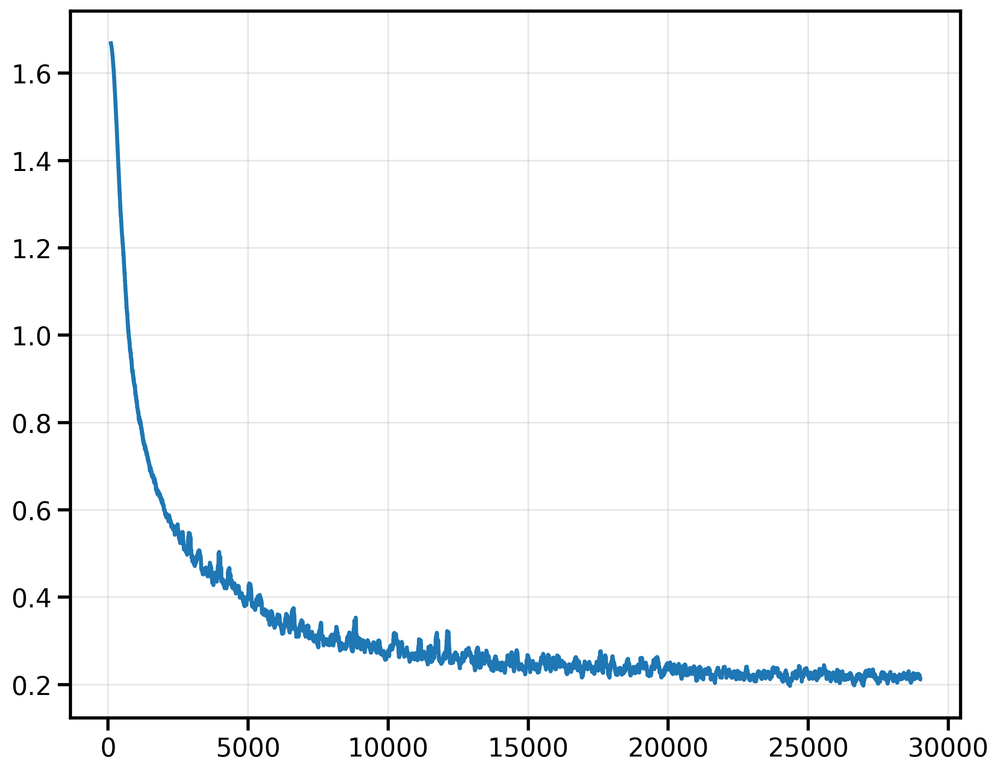

In [49]:
losses.rolling(window=100).mean().plot()
# plt.ylim((0, max(losses)));

## Trajectory

In [50]:
predicted = model.predict_trajectory(
    torch.tensor(trajectories[50]).unsqueeze(0).to("cuda"),
    n_steps=100,
    stride=25
).squeeze().to("cpu")

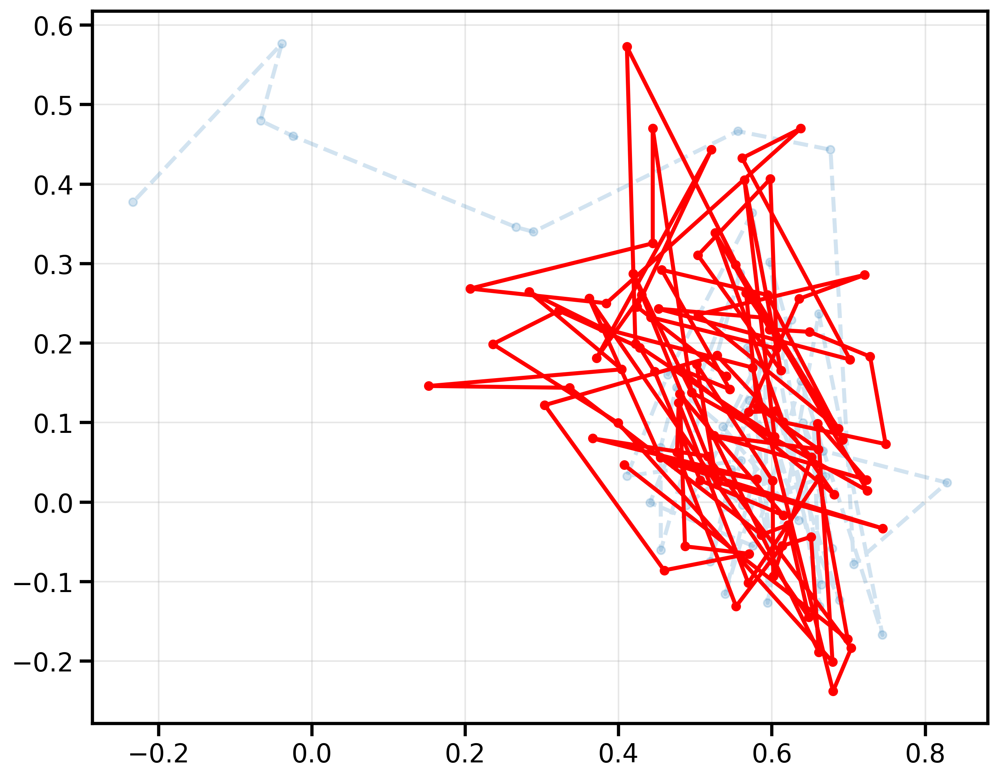

In [51]:
plt.plot(torch.tensor(trajectories[5])[950:, 0], torch.tensor(trajectories[5])[950:, 1], ls="--", marker=".", alpha=0.2)
plt.plot(predicted[1001:, 0], predicted[1001:, 1], c="r", ls="-", marker=".", alpha=1)

### Generated trajectories

In [64]:
idx = np.random.choice(1000, 1, replace=False)

In [65]:
idx

array([640])

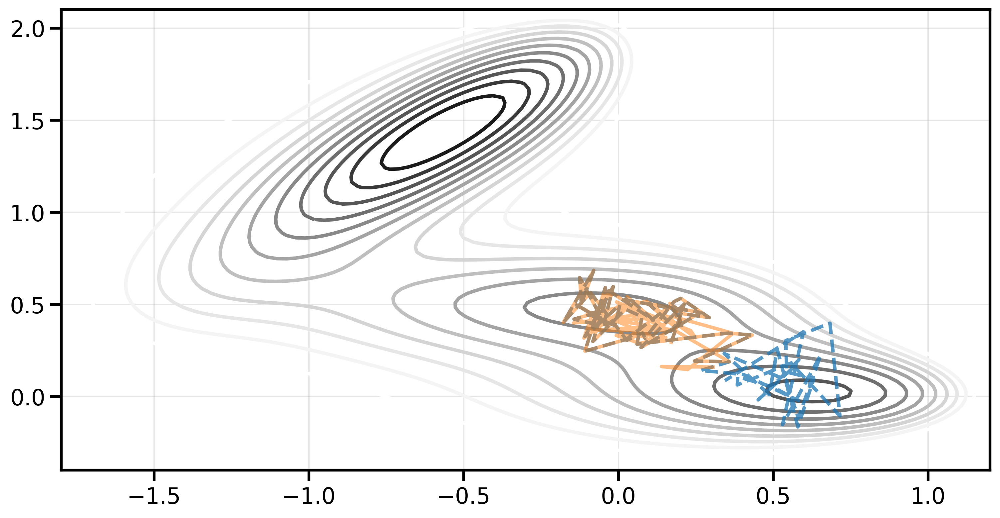

In [66]:
fig, axs = plt.subplots( 1, 1, figsize=(12, 6))
plot_isolines_2D(muller_brown_potential,levels=np.linspace(0,24,12),mode='contour',ax=axs)


init = 50
stop = 75
plt.plot(test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 0],
         test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 1],
         ls="--", 
         alpha=0.75);

predicted = model.predict_trajectory(
    test_trajs[idx, :init, :].to("cuda"),
    n_steps=stop - init,
    stride=25
).to("cpu").numpy()

plt.plot(predicted.transpose(1, 0, 2)[:stop, :, 0],
         predicted.transpose(1, 0, 2)[:stop, :, 1],
         alpha=0.5);

In [67]:
idx = np.random.choice(500, 1, replace=False)

In [68]:
idx

array([99])

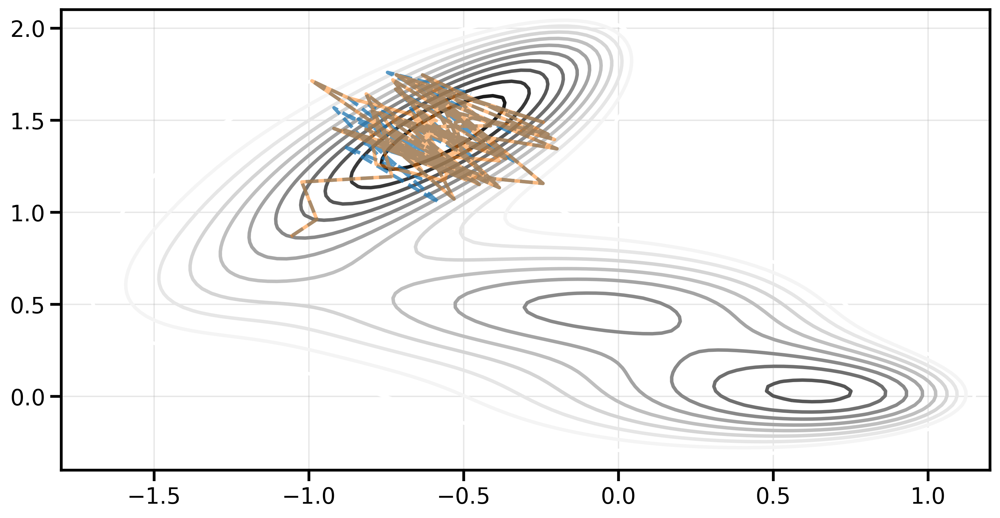

In [69]:
fig, axs = plt.subplots( 1, 1, figsize=(12, 6))
plot_isolines_2D(muller_brown_potential,levels=np.linspace(0,24,12),mode='contour',ax=axs)


init = 50
stop = 75
plt.plot(test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 0],
         test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 1],
         ls="--", 
         alpha=0.75);

predicted = model.predict_trajectory(
    test_trajs[idx, :init, :].to("cuda"),
    n_steps=stop - init,
    stride=25
).to("cpu").numpy()

plt.plot(predicted.transpose(1, 0, 2)[:stop, :, 0],
         predicted.transpose(1, 0, 2)[:stop, :, 1],
         alpha=0.5);

### Metrics

In [78]:
# Analyze predictions
actual, predicted, avg_metrics, per_traj_metrics = analyze_trajectory_prediction(
    model,
    test_trajs[:100, :, :],
    initial_sequence_length=500,
    prediction_length=100,
    stride=53
)

In [79]:
# Print metrics
print("\nPrediction Metrics:")
for name, value in avg_metrics.items():
    print(f"{name}: {value:.4f}")


Prediction Metrics:
mse: 0.1194
rmse: 0.2975
mae: 0.2510
relative_error: 0.6143


**stride effects**

In [73]:
stride_metrics = {}

for stride in np.linspace(1, 60, 10, dtype=int):
# Analyze predictions
    _, _, stride_metrics[stride], _ = analyze_trajectory_prediction(
        model,
        test_trajs[:100, :, :],
        initial_sequence_length=500,
        prediction_length=100,
        stride=stride
    )

In [74]:
stride_metrics

{1: {'mse': 0.16510510786936428,
  'rmse': 0.3572772928905866,
  'mae': 0.2974868891620184,
  'relative_error': 0.7859900802683965},
 7: {'mse': 0.13565009621987134,
  'rmse': 0.32577437205933424,
  'mae': 0.2696807493594818,
  'relative_error': 0.6992128636657705},
 14: {'mse': 0.12675148807873993,
  'rmse': 0.3133113031223448,
  'mae': 0.2602960979533385,
  'relative_error': 0.6647843581912974},
 20: {'mse': 0.1270939189861692,
  'rmse': 0.31374759256360835,
  'mae': 0.2614103949107818,
  'relative_error': 0.6636864540860948},
 27: {'mse': 0.1267476491561384,
  'rmse': 0.3128977093521081,
  'mae': 0.26100389841857086,
  'relative_error': 0.6631236475534534},
 33: {'mse': 0.12215090153669454,
  'rmse': 0.3056102697673651,
  'mae': 0.25527848683045656,
  'relative_error': 0.6388742902961577},
 40: {'mse': 0.12223380618221548,
  'rmse': 0.3049245149287481,
  'mae': 0.25544232106866877,
  'relative_error': 0.6350164275201613},
 46: {'mse': 0.1205468007754113,
  'rmse': 0.3020967939881959

In [77]:
min_stride = min(stride_metrics.keys(), key=lambda k: stride_metrics[k]['mse'])
min_stride

53

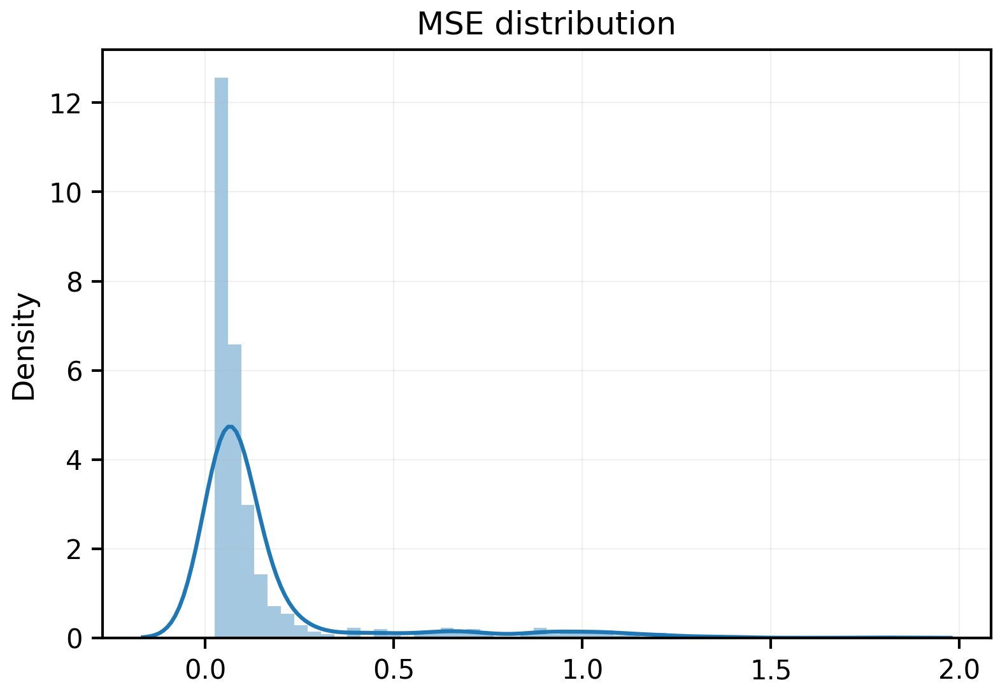

In [73]:
sns.distplot(per_traj_metrics["mse"]);
plt.title("MSE distribution");

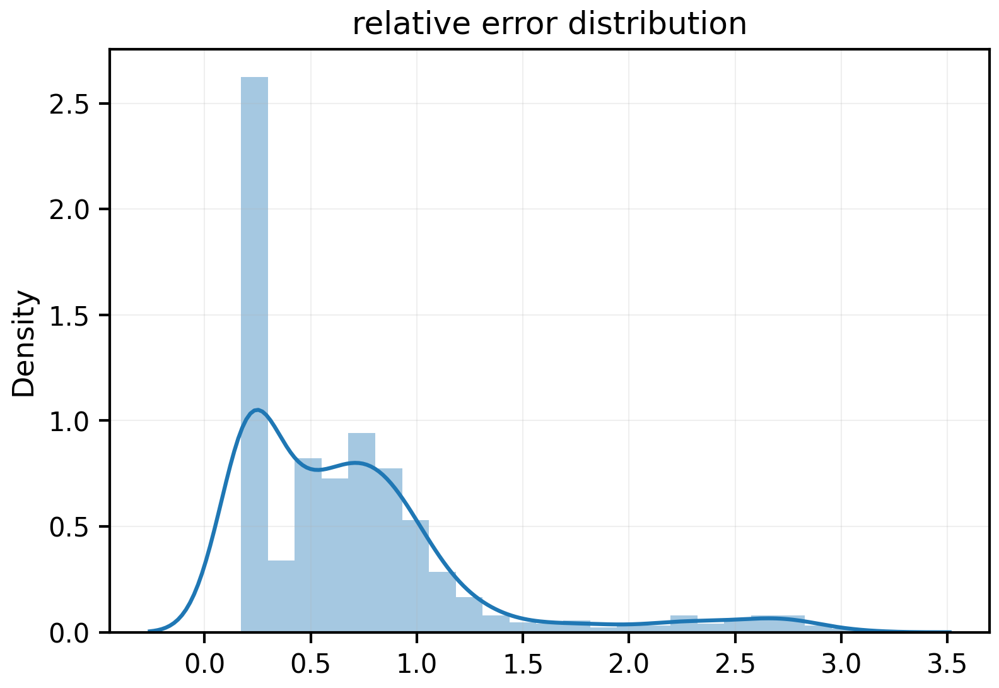

In [74]:
sns.distplot(per_traj_metrics["relative_error"]);
plt.title("relative error distribution");

In [161]:
# TODO: stride below

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.


In [172]:
test_trajectory = torch.tensor(trajectories[50])


Prediction Metrics:
mse: 0.0071
rmse: 0.0841
mae: 0.0690
relative_error: 0.2573


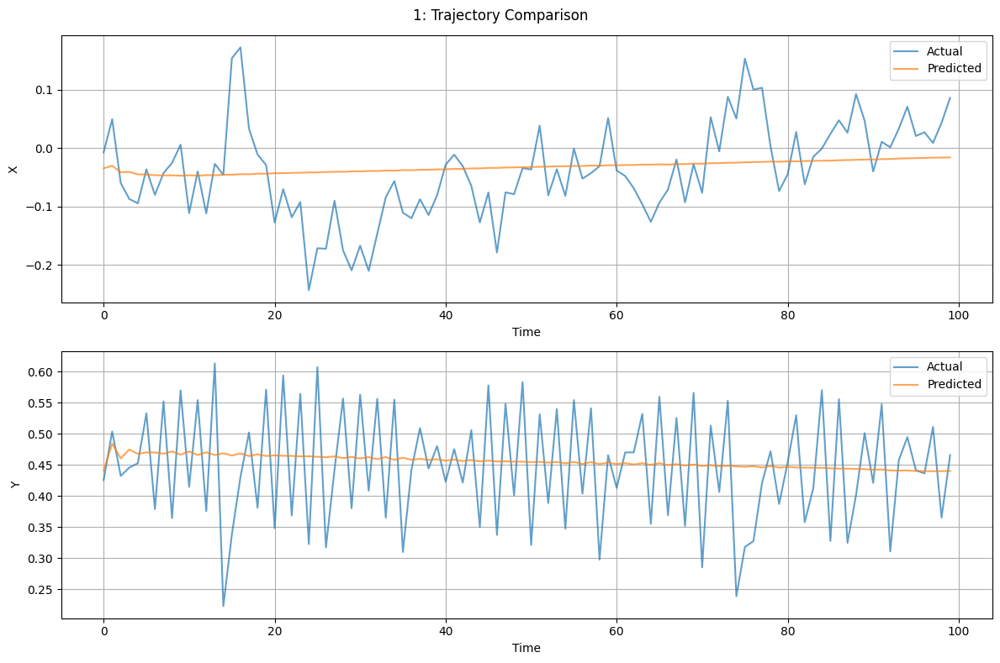

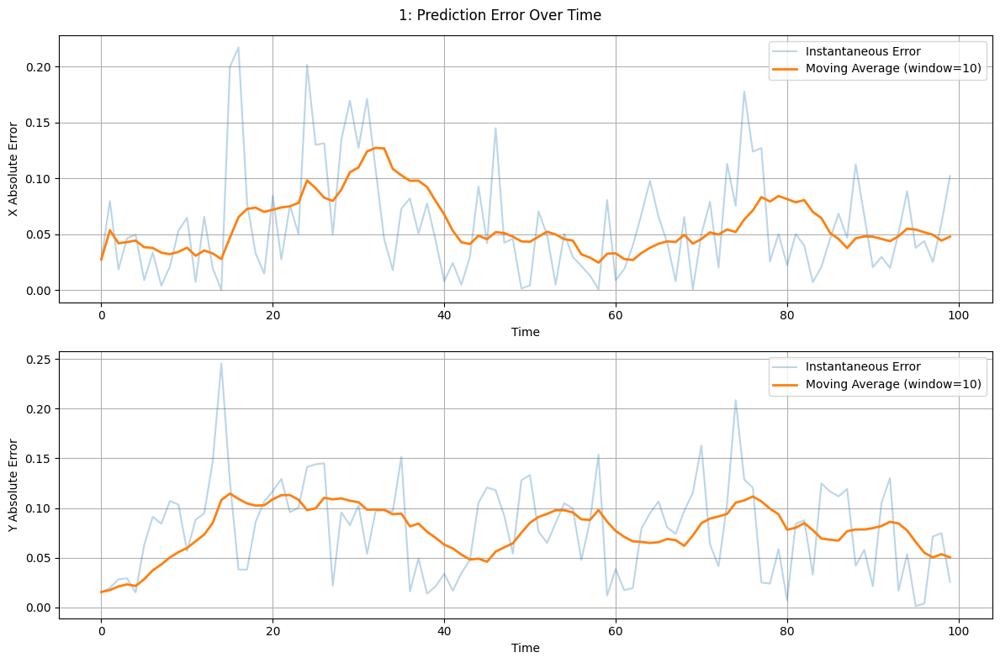


Prediction Metrics:
mse: 0.0068
rmse: 0.0827
mae: 0.0672
relative_error: 0.2519


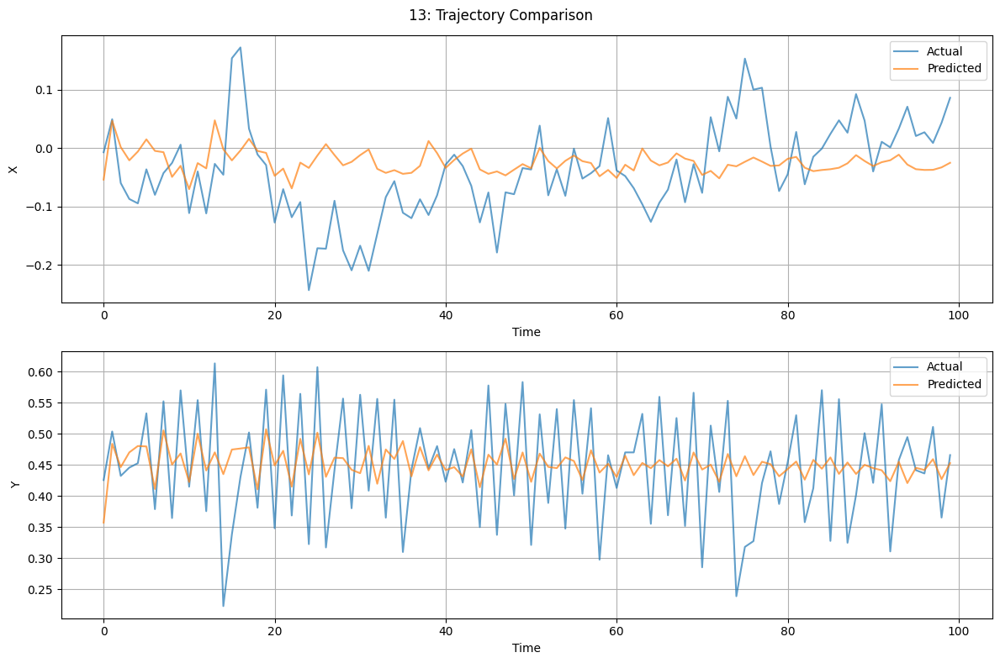

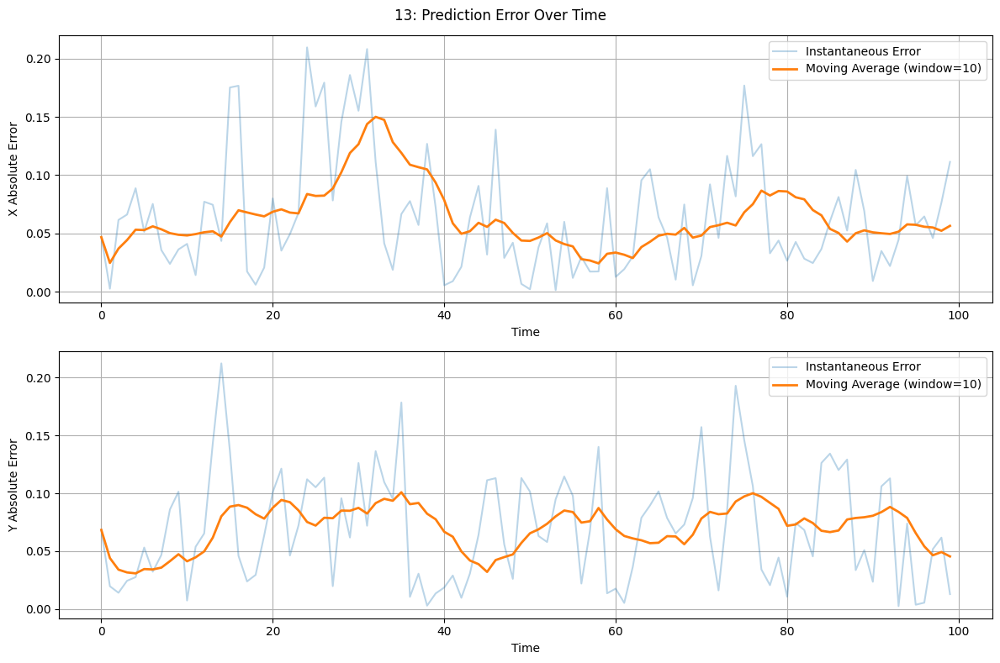


Prediction Metrics:
mse: 0.0076
rmse: 0.0872
mae: 0.0719
relative_error: 0.2657


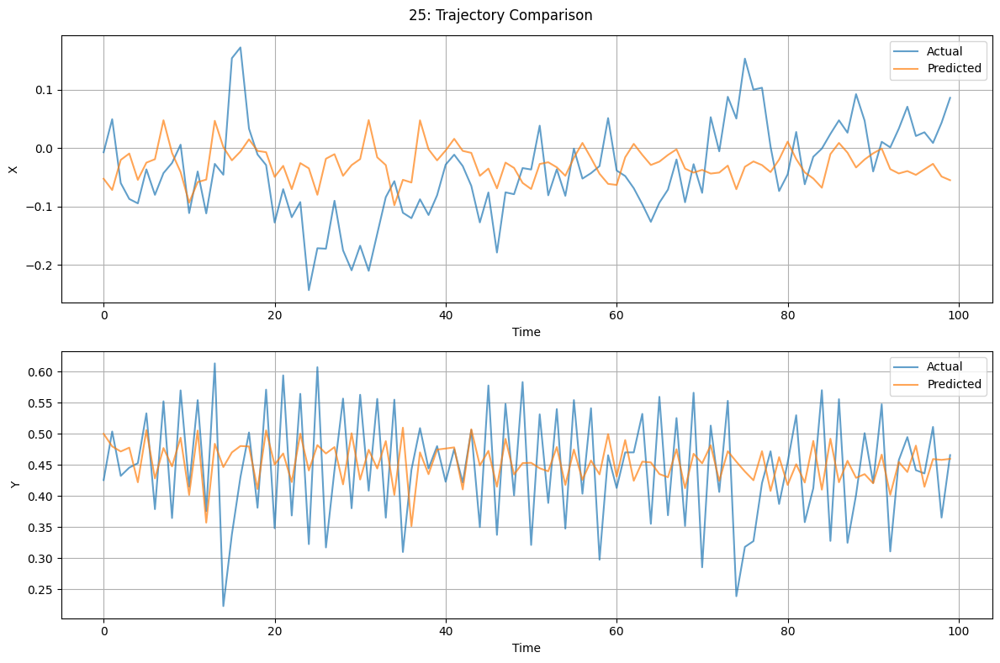

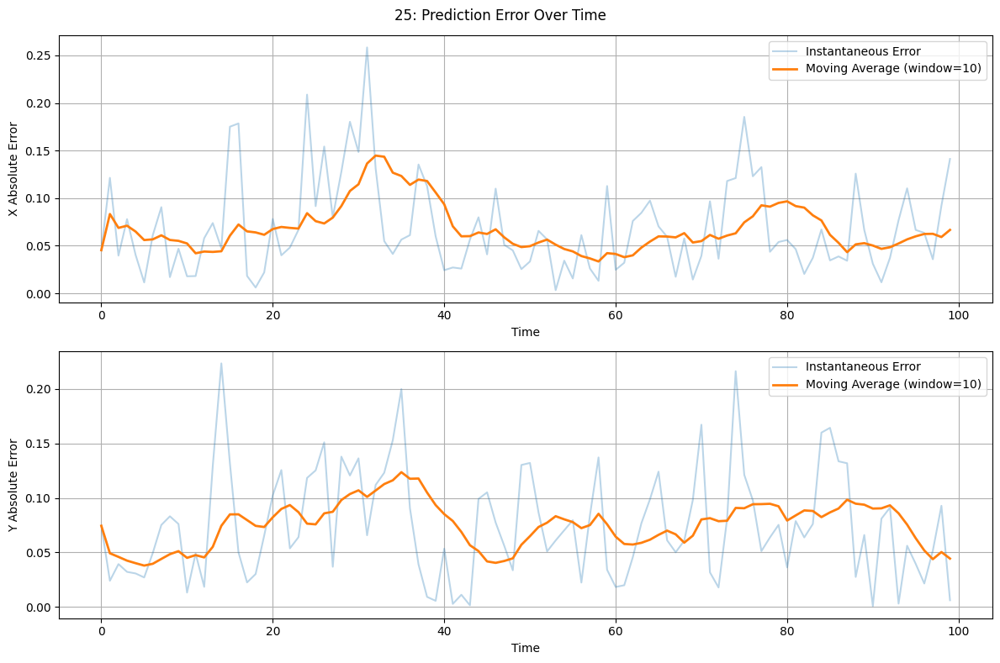


Prediction Metrics:
mse: 0.0087
rmse: 0.0928
mae: 0.0760
relative_error: 0.2838


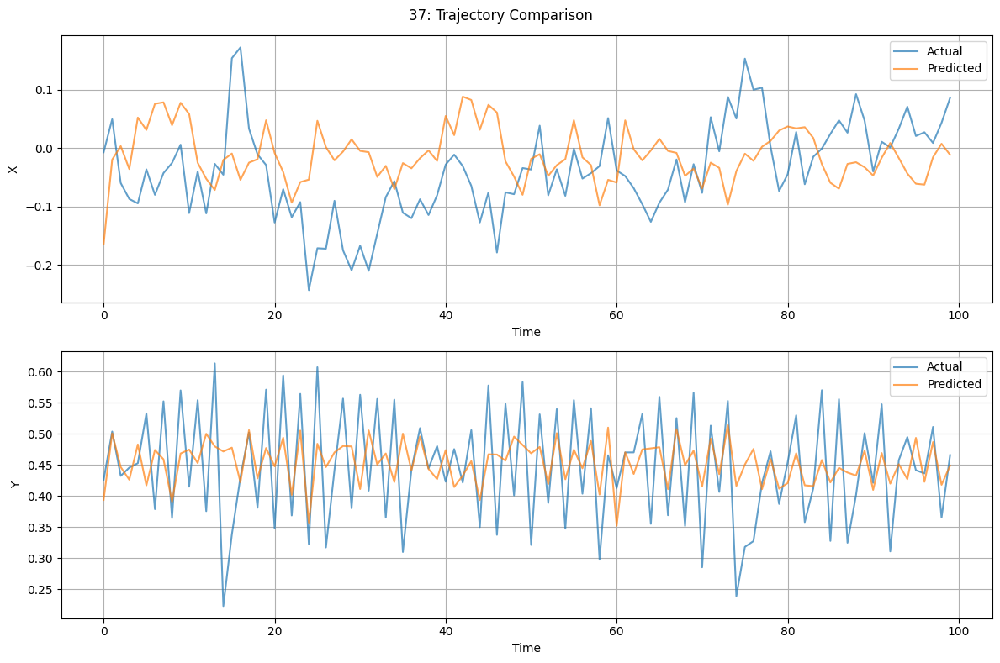

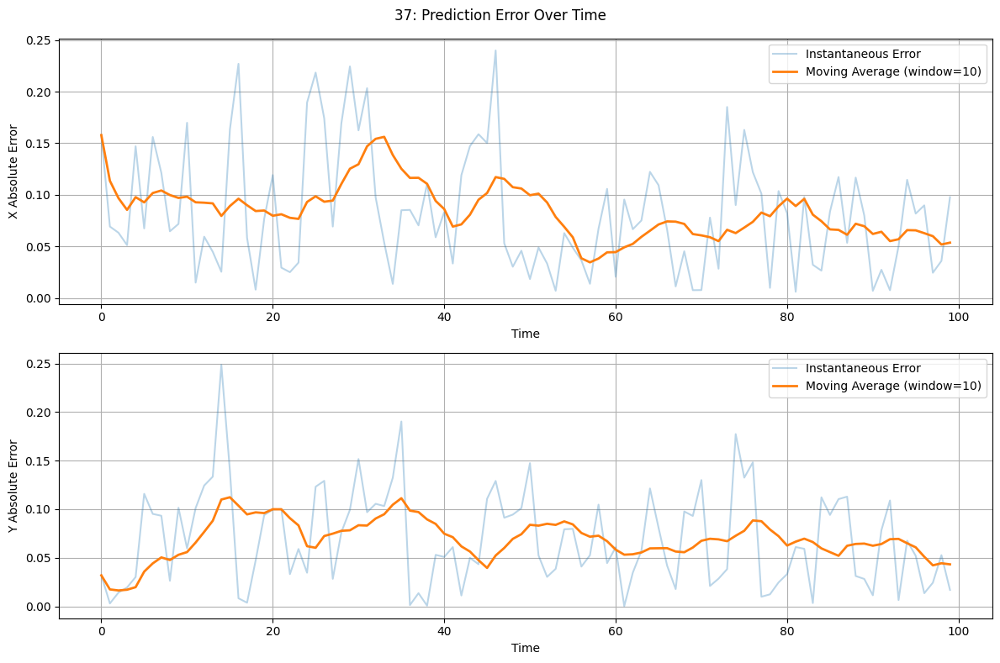


Prediction Metrics:
mse: 0.0103
rmse: 0.1016
mae: 0.0850
relative_error: 0.3097


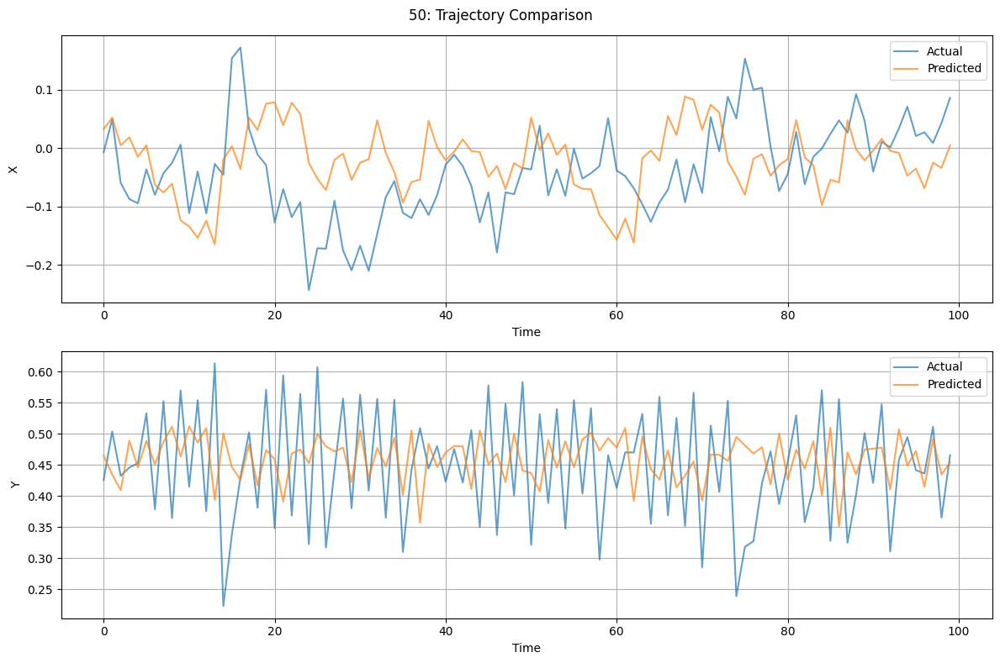

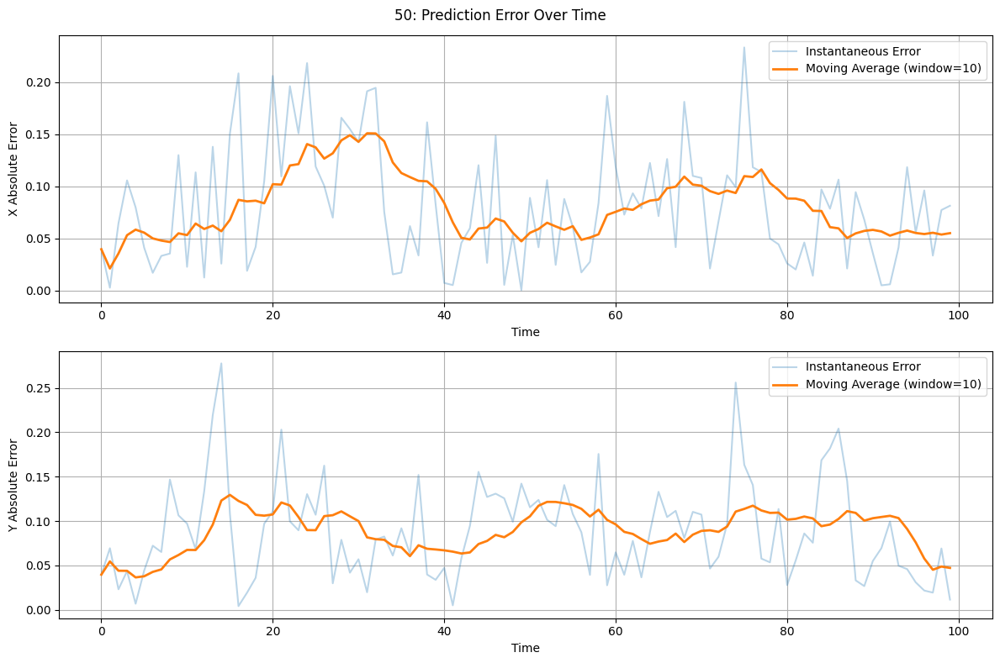

In [177]:
for stride in np.linspace(1, 50, 5, dtype=int):

    # Analyze predictions
    actual1, predicted1, metrics1 = plotting.analyze_trajectory_prediction(
        model,
        test_trajectory = test_trajectory.to("cuda"),
        mean=test_trajectory.mean(dim=0).to("cuda"),
        std=test_trajectory.std(dim=0).to("cuda"),
        initial_sequence_length=900,
        prediction_length=100,
        stride=stride
    )
    
    # Print metrics
    print("\nPrediction Metrics:")
    for name, value in metrics1.items():
        print(f"{name}: {value:.4f}")
    
    # Plot comparisons
    plotting.plot_trajectory_comparison(
        actual1,
        predicted1,
        feature_names=['X', 'Y'],  # Replace with your feature names
        title=f"{stride}: Trajectory Comparison",
        # save_path="trajectory_comparison1.png"
    )
    
    # Plot error analysis
    plotting.plot_prediction_error(
        actual1,
        predicted1,
        feature_names=['X', 'Y'],  # Replace with your feature names
        window_size=10,
        title=f"{stride}: Prediction Error Over Time",
        # save_path="prediction_error1.png"
    )

## State

In [75]:
predictions  = model.classify_state(test_trajs.to("cuda"))

In [76]:
accuracy = accuracy_score(predictions["predictions"].cpu(), test_states)
precision = precision_score(predictions["predictions"].cpu(),  test_states, average='weighted')
recall = recall_score(predictions["predictions"].cpu(),  test_states, average='weighted')
f1 = f1_score(predictions["predictions"].cpu(),  test_states, average='weighted')

# Print the evaluation metrics
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

Accuracy: 0.9150
Precision: 0.9234
Recall: 0.9150
F1 Score: 0.9154


### Partial trajectory

In [77]:
part_predictions  = model.classify_state(test_trajs[:, :500, :].to("cuda"))

In [82]:
accuracy = accuracy_score(part_predictions["predictions"].cpu(), test_states)
precision = precision_score(part_predictions["predictions"].cpu(),  test_states, average='weighted')
recall = recall_score(part_predictions["predictions"].cpu(),  test_states, average='weighted')
f1 = f1_score(part_predictions["predictions"].cpu(),  test_states, average='weighted')

# Print the evaluation metrics
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

Accuracy: 0.5260
Precision: 0.9754
Recall: 0.5260
F1 Score: 0.6634


In [83]:
seg_length = 500
mean_acc, acc_by_pos, pred_states = evaluate_segments(test_trajs.to("cuda"), test_states, model, segment_length=seg_length,
                                                      n_segments=1000 // seg_length)
print(f"Mean accuracy: {mean_acc:.3f}")

Mean accuracy: 0.514


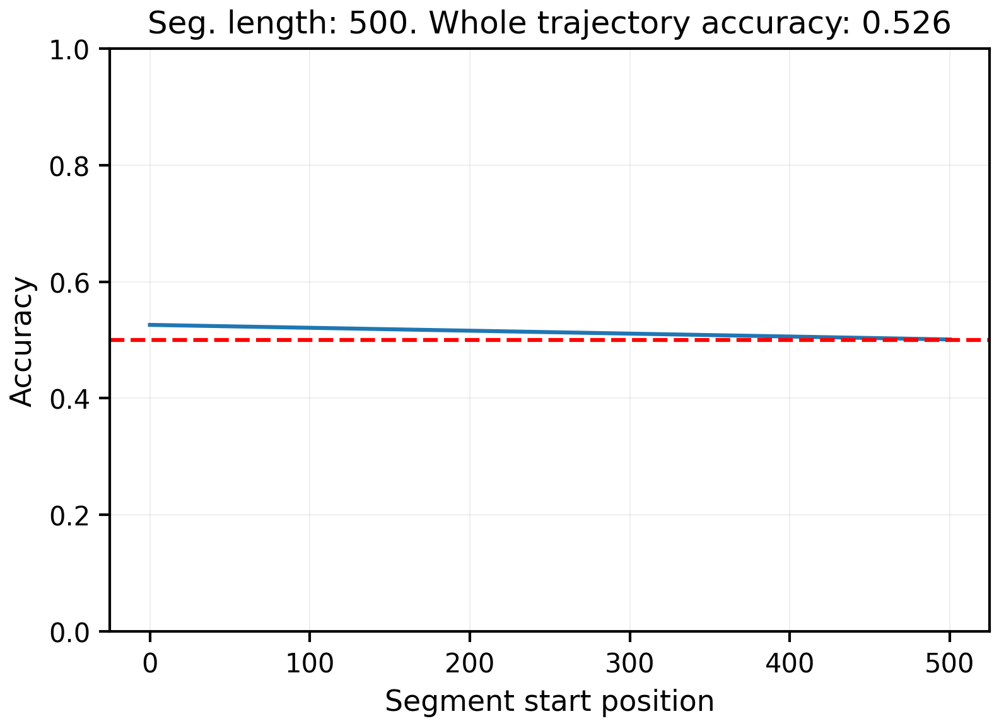

In [84]:
# Plot accuracy vs position
plt.plot(acc_by_pos.keys(), acc_by_pos.values())
plt.xlabel("Segment start position");
plt.ylabel("Accuracy");
plt.ylim((0, 1));
plt.axhline(0.5, c="r", ls="--");
plt.title(f"Seg. length: {seg_length}. Whole trajectory accuracy: {accuracy:.3f}");

In [85]:
seg_length = 250
mean_acc, acc_by_pos, pred_states = evaluate_segments(test_trajs.to("cuda"), test_states, model, segment_length=seg_length,
                                                      n_segments=1000 // seg_length)
print(f"Mean accuracy: {mean_acc:.3f}")

Mean accuracy: 0.534


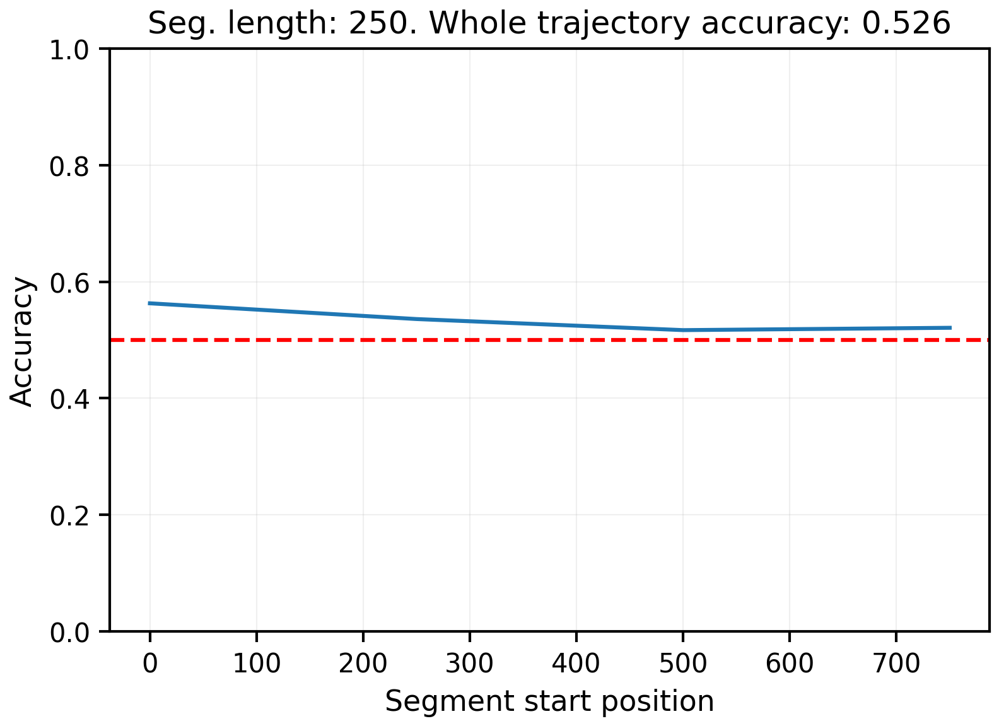

In [86]:
# Plot accuracy vs position
plt.plot(acc_by_pos.keys(), acc_by_pos.values())
plt.xlabel("Segment start position");
plt.ylabel("Accuracy");
plt.ylim((0, 1));
plt.axhline(0.5, c="r", ls="--");
plt.title(f"Seg. length: {seg_length}. Whole trajectory accuracy: {accuracy:.3f}");

In [95]:
seg_length = 100
mean_acc, acc_by_pos, pred_states = evaluate_segments(test_trajs.to("cuda"), test_states, model,
                                                      segment_length=seg_length,
                                                      n_segments=1000 // seg_length)
print(f"Mean accuracy: {mean_acc:.3f}")

Mean accuracy: 0.517


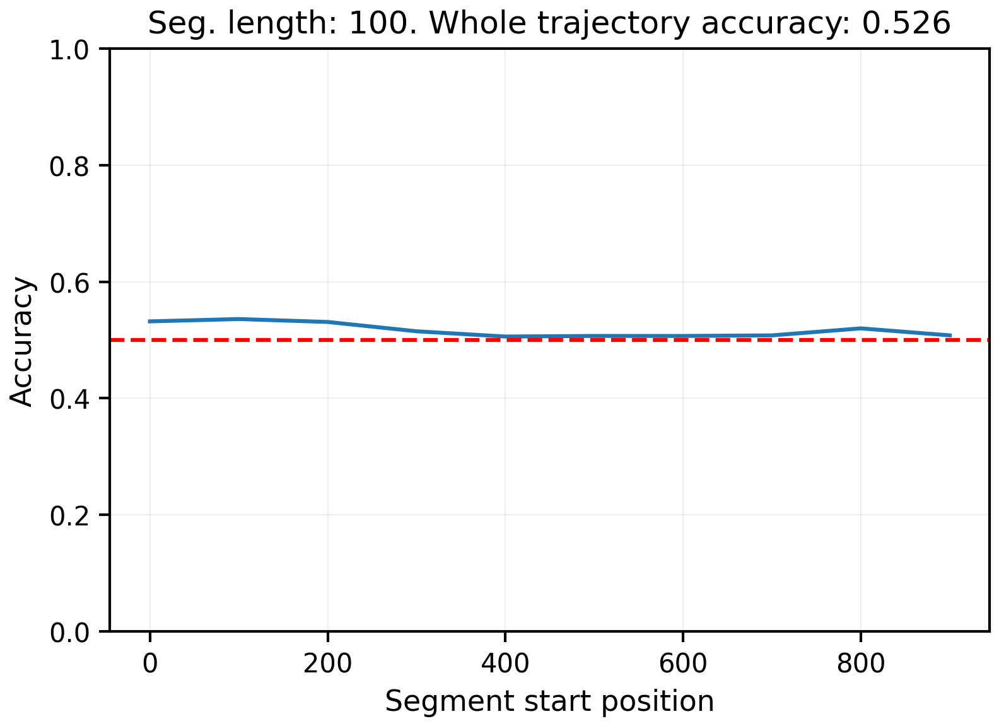

In [96]:
# Plot accuracy vs position
plt.plot(acc_by_pos.keys(), acc_by_pos.values())
plt.xlabel("Segment start position");
plt.ylabel("Accuracy");
plt.ylim((0, 1));
plt.axhline(0.5, c="r", ls="--");
plt.title(f"Seg. length: {seg_length}. Whole trajectory accuracy: {accuracy:.3f}");

## Embeddings

In [108]:
# More detailed analysis
attention_data = get_attention_maps(model, trajs[0, :, :], return_hiddens=True)

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


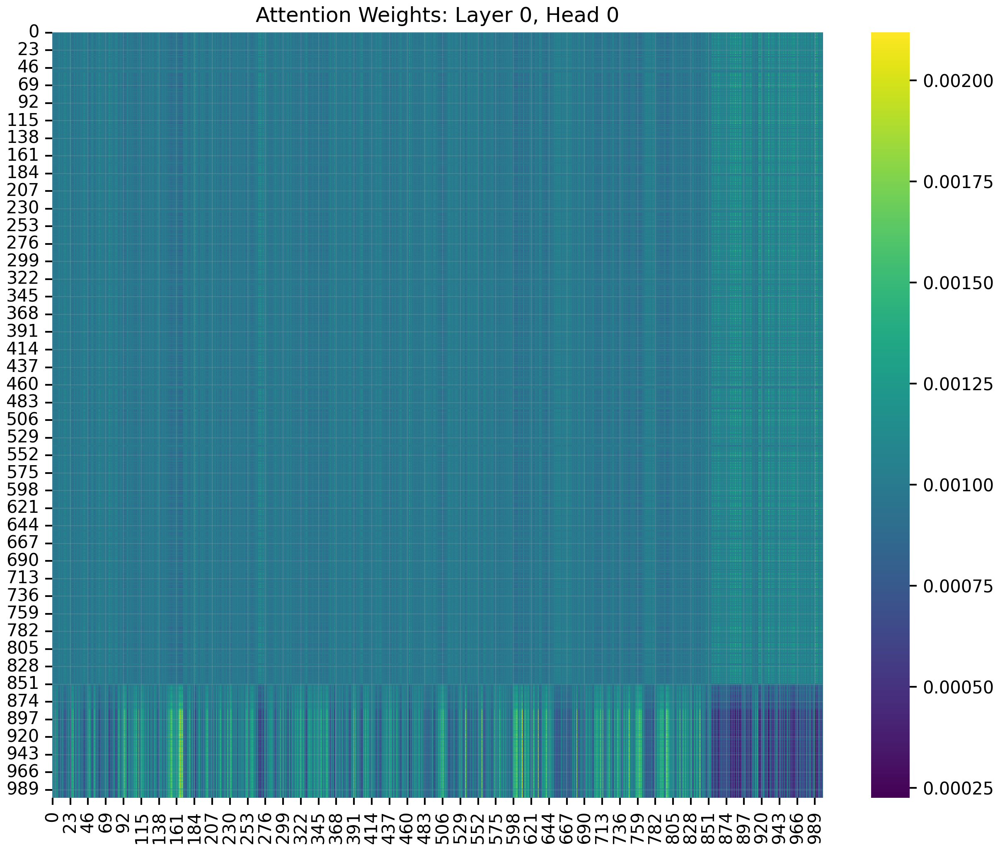

In [109]:
# Examine specific layer and head
layer_idx = 0  # First layer
head_idx = 0   # First attention head
attention_weights = attention_data['all_head_outputs']['attn'][layer_idx][0, head_idx]

# Can also create custom visualizations with the attention weights
import seaborn as sns
plt.figure(figsize=(10, 8))
sns.heatmap(attention_weights, cmap='viridis')
plt.title(f'Attention Weights: Layer {layer_idx}, Head {head_idx}')
plt.show()

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


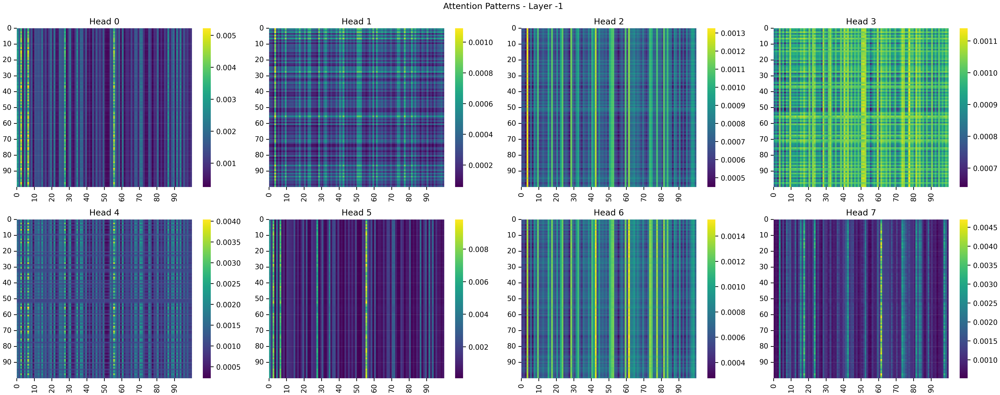

In [110]:
# View all attention heads for a section
visualize_attention(model, trajs[0, :, :], window_size=100, start_idx=0, layer_id=-1);

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


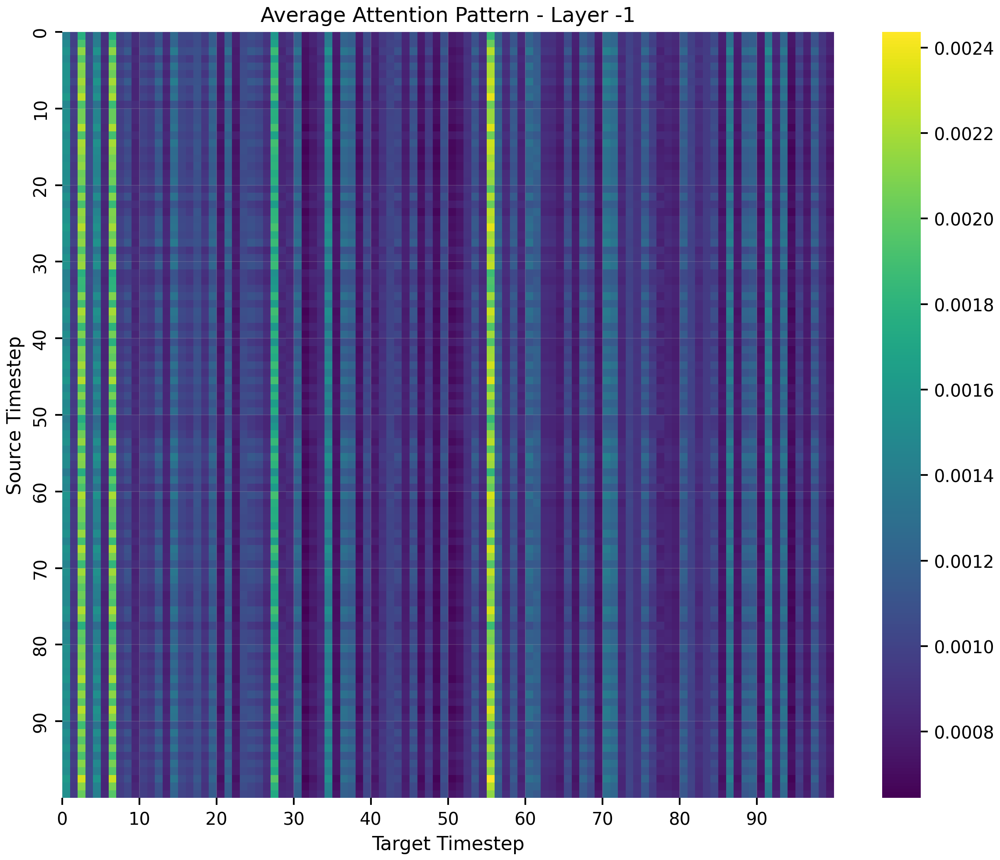

In [111]:
# View average attention pattern
plot_average_attention(model, trajs[0, :, :], window_size=100, start_idx=0, layer_id=-1);

Layer 0
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


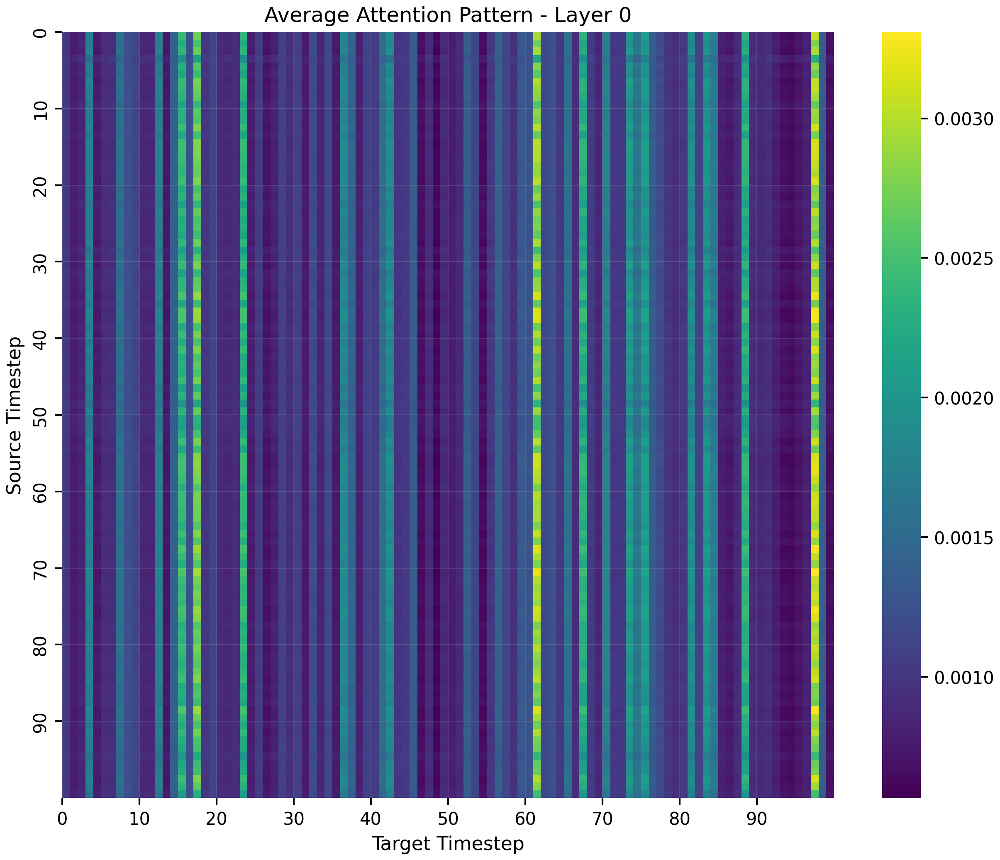

Layer 1
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


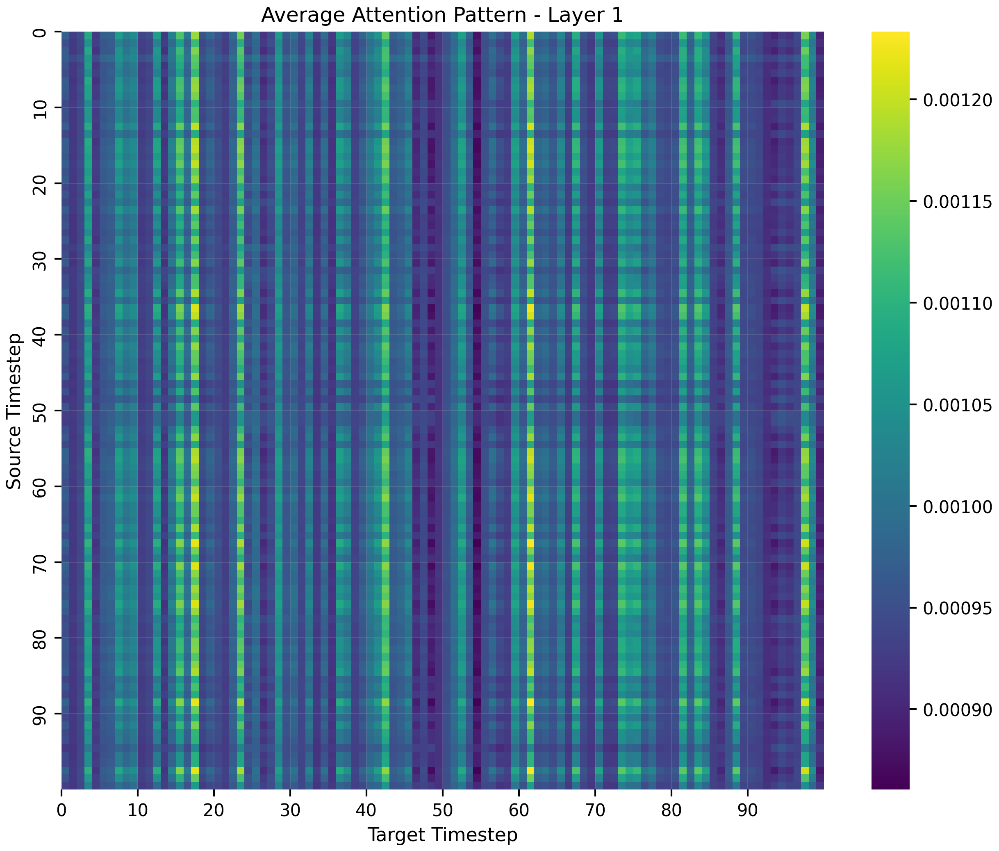

Layer 2
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


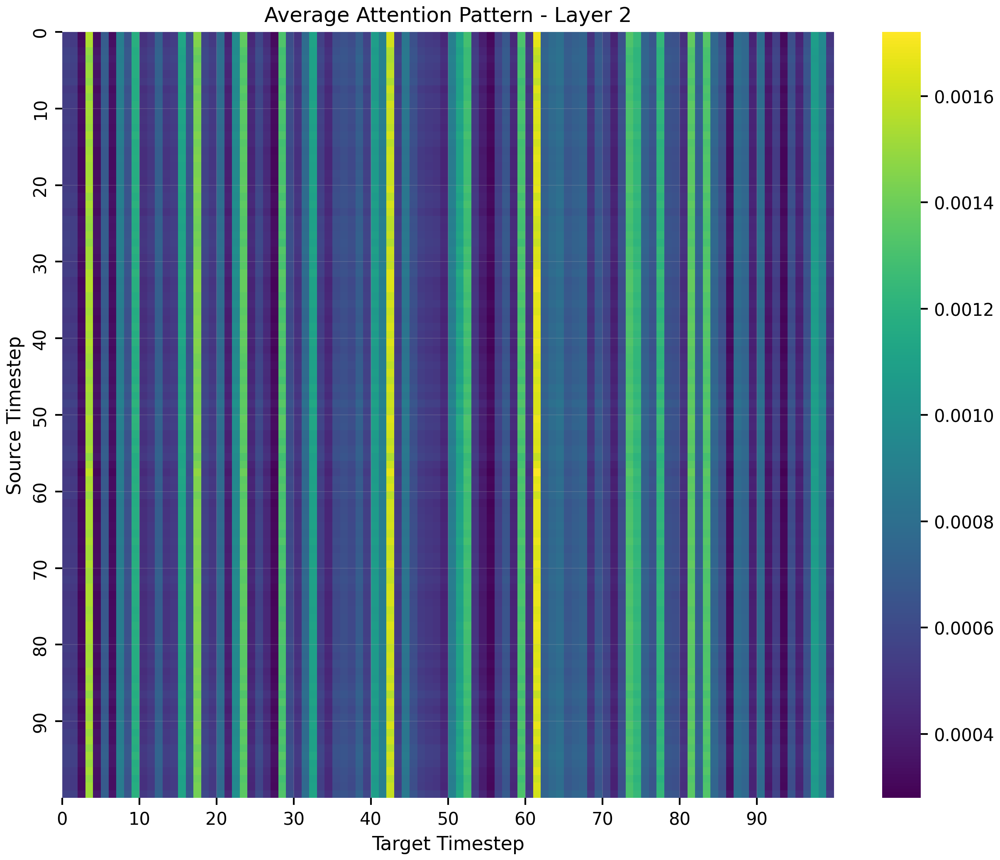

Layer 3
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


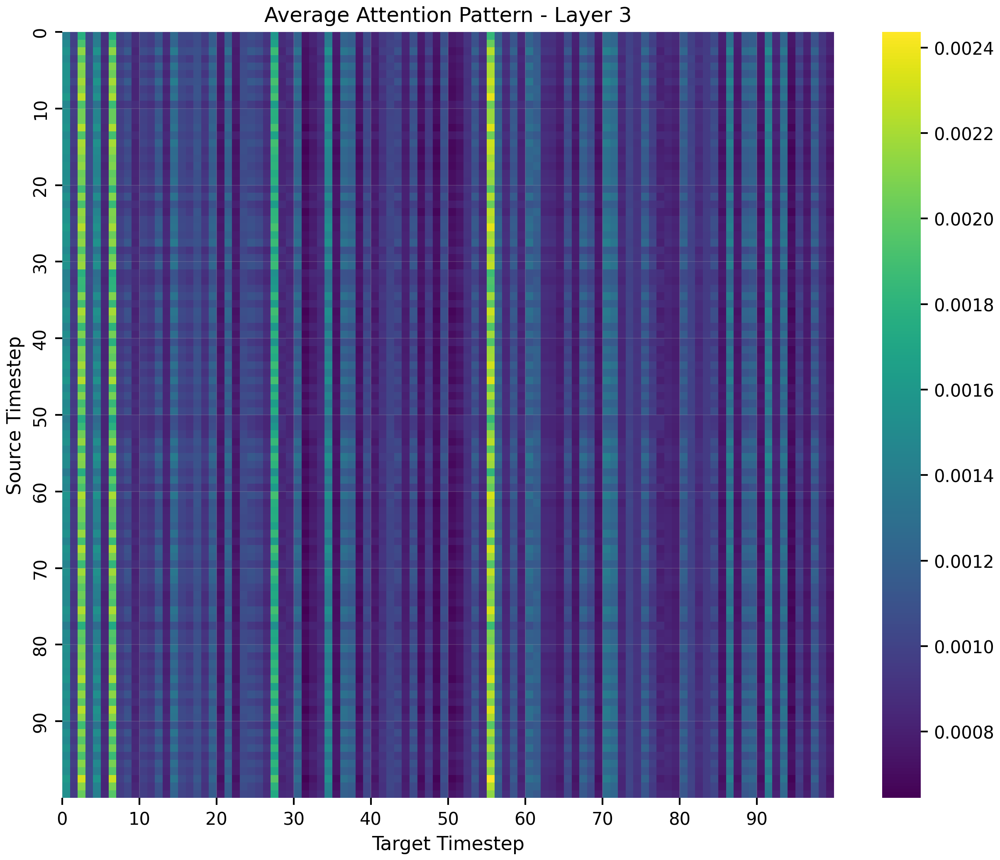

In [112]:
# Look at different layers
for layer in range(4):  # Assuming 4 layers
    print(f"Layer {layer}")
    plot_average_attention(model, trajs[0, :, :], window_size=100, start_idx=0, layer_id=layer)

all layers, all heads



Layer 0
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


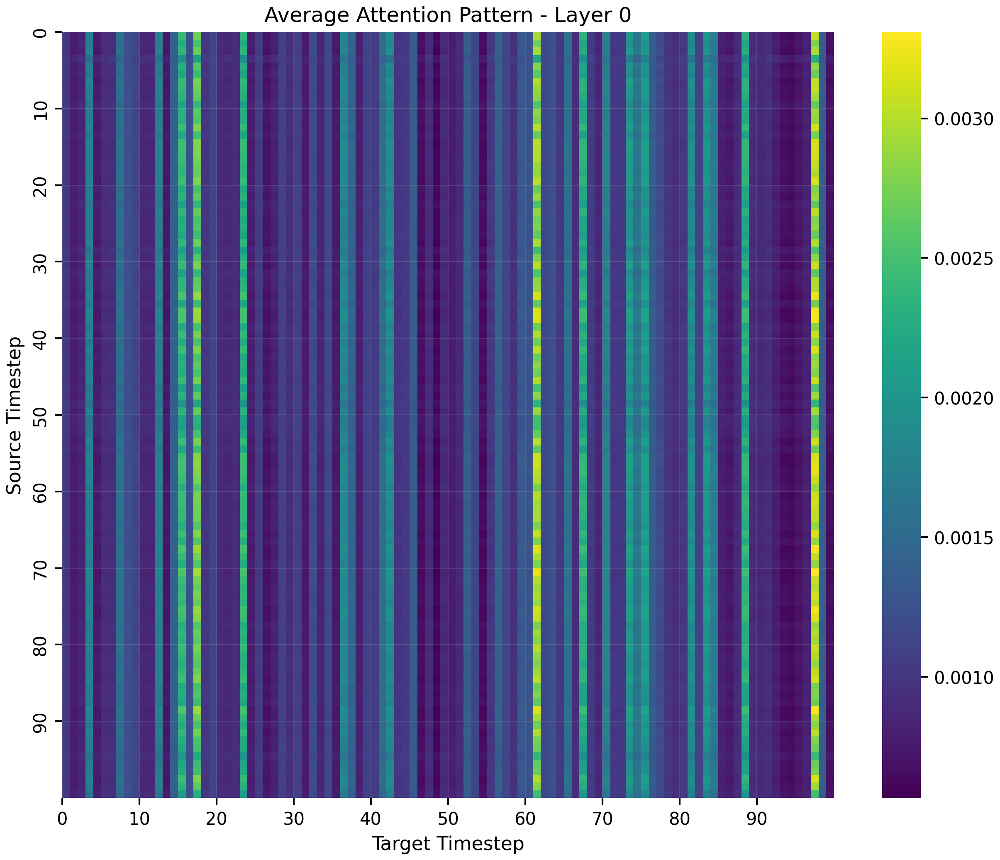

Layer 1
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


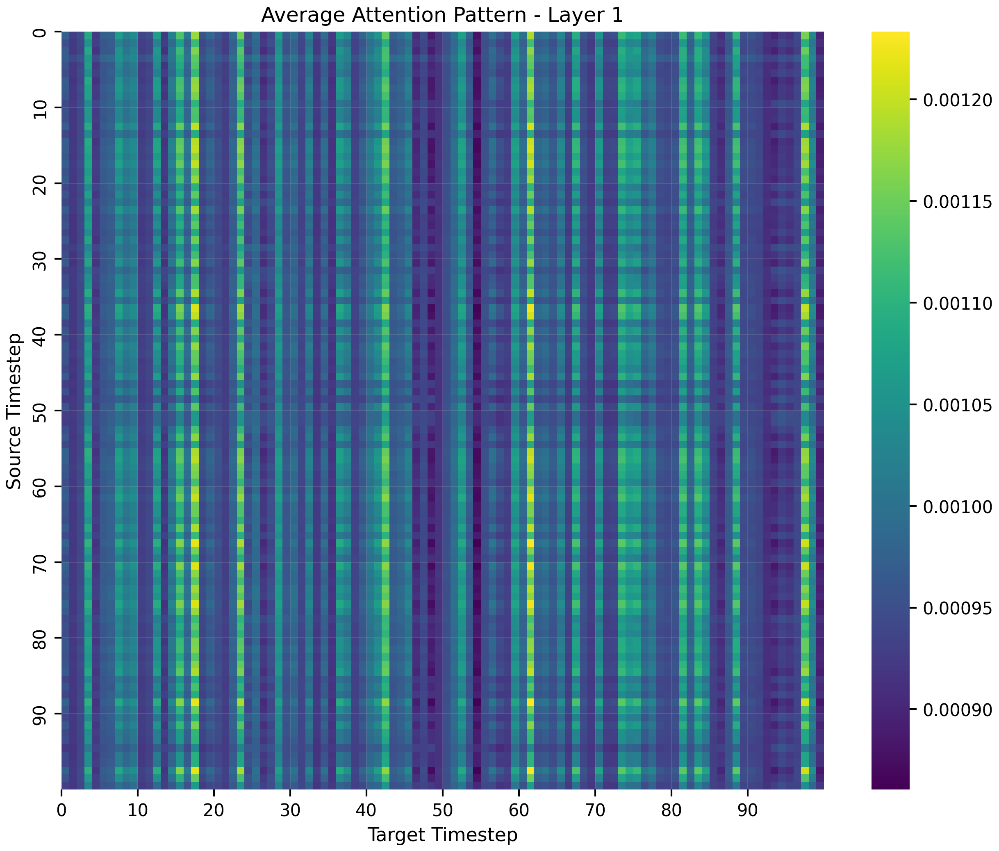

Layer 2
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


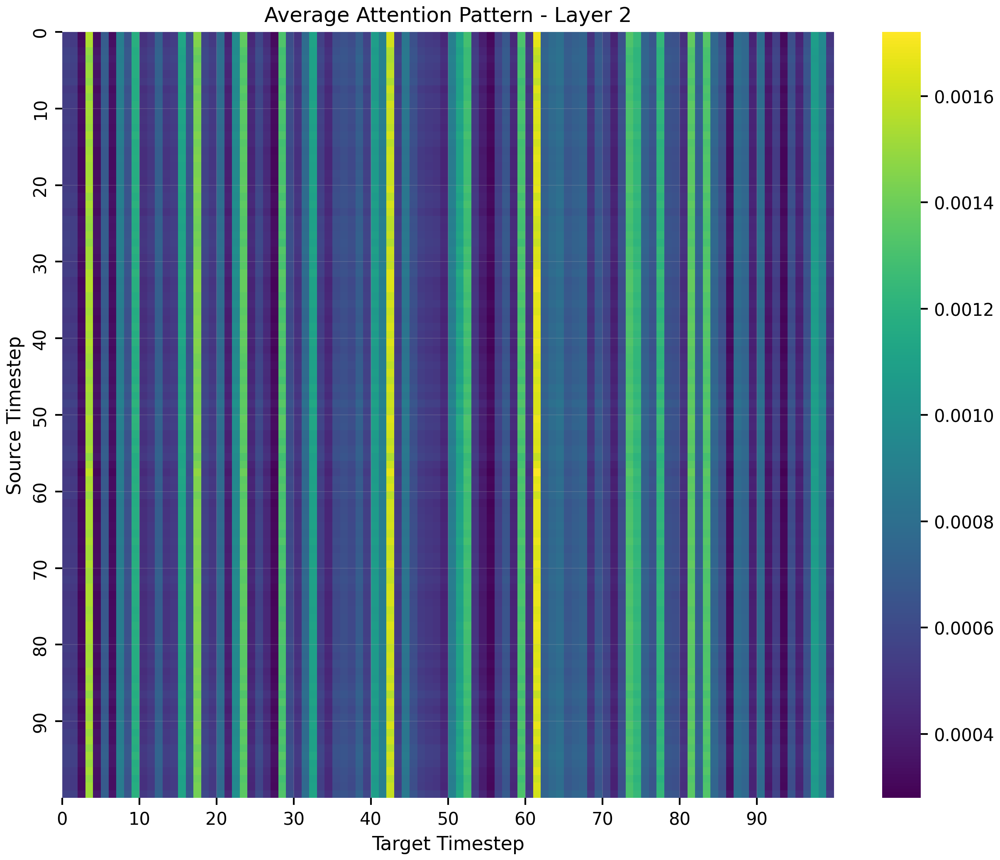

Layer 3
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


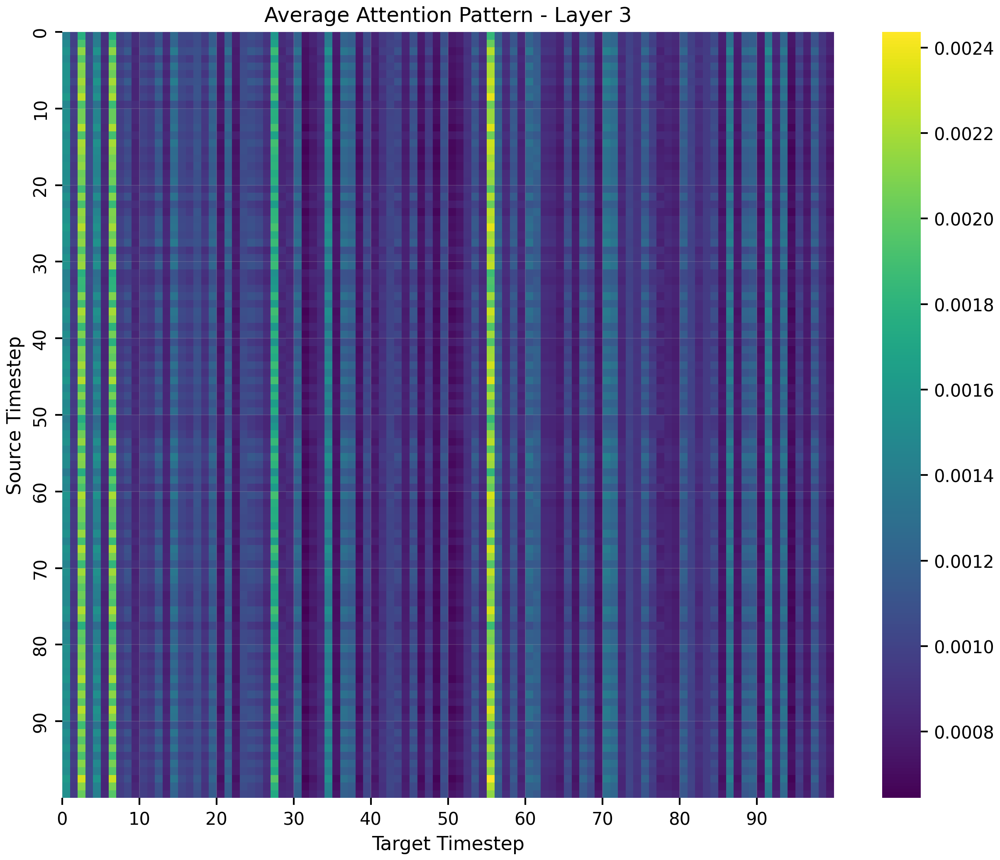

In [116]:
avg_attns = []
for layer in range(4):  # Assuming 4 layers
    print(f"Layer {layer}")
    avg_attns.append(plot_average_attention(model, trajs[0, :, :], window_size=100,
                                            start_idx=0, layer_id=layer))

In [117]:
avg_attn = np.mean(avg_attns, axis=0)

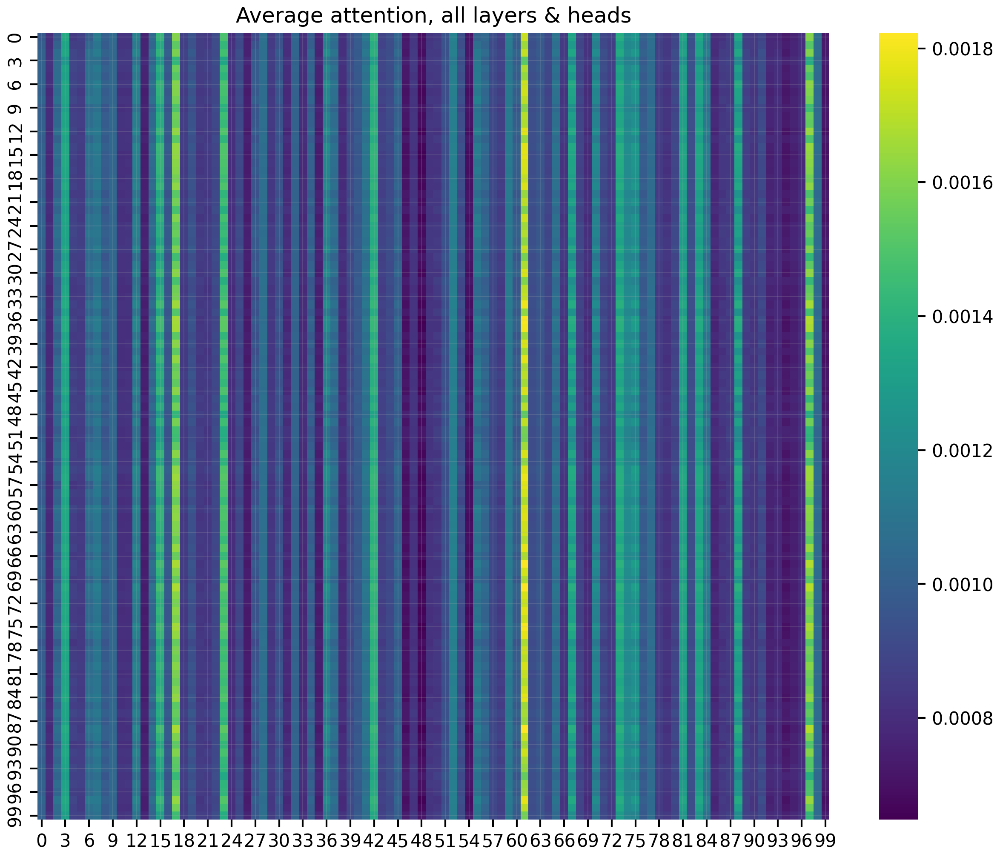

In [119]:
plt.figure(figsize=(10, 8))
sns.heatmap(avg_attn, cmap='viridis')
plt.title(f'Average attention, all layers & heads')
plt.show()

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]


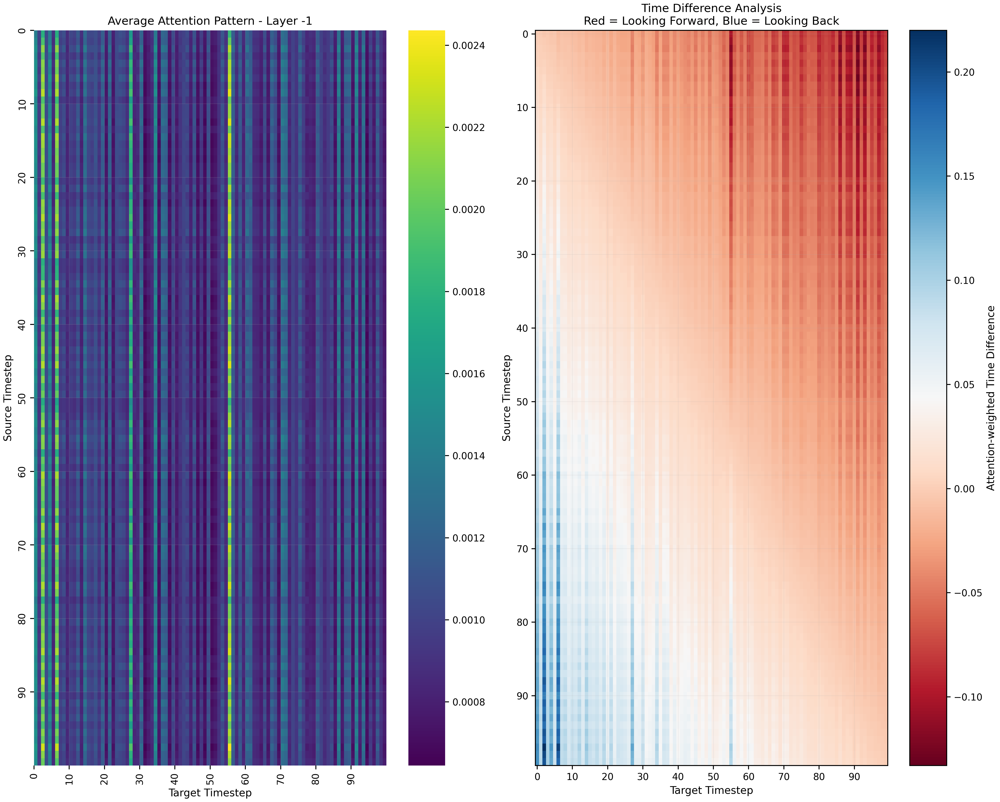

In [113]:
# Look at a single section with time differences
plot_attention_with_time_diff(
    model, 
    trajs[0, :, :],
    window_size=100,
    start_idx=0,
    layer_id=-1
)

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000]), torch.Size([1, 8, 1000, 1000])]

Attention Pattern Statistics Across Trajectory:

Time Difference Stats:

Section 0 (timesteps 0-50):
  Mean absolute time difference: 0.019
  Std of time differences: 0.024
  Max looking backward: -0.079
  Max looking forward: 0.085

Section 1 (timesteps 316-366):
  Mean absolute time difference: 0.017
  Std of time differences: 0.023
  Max looking backward: -0.143
  Max looking forward: 0.057

Section 2 (timesteps 633-683):
  Mean absolute time difference: 0.019
  Std of time differences: 0.025
  Max looking backward: -0.085
  Max looking forward: 0.108

Section 3 (timesteps 950-1000):
  Mean absolute time difference: 0.019
  Std of time differences: 0.024
  Max looking backward: -0.091
  Max looking forward: 0.156

Attention Pattern Stats:

Section 0:

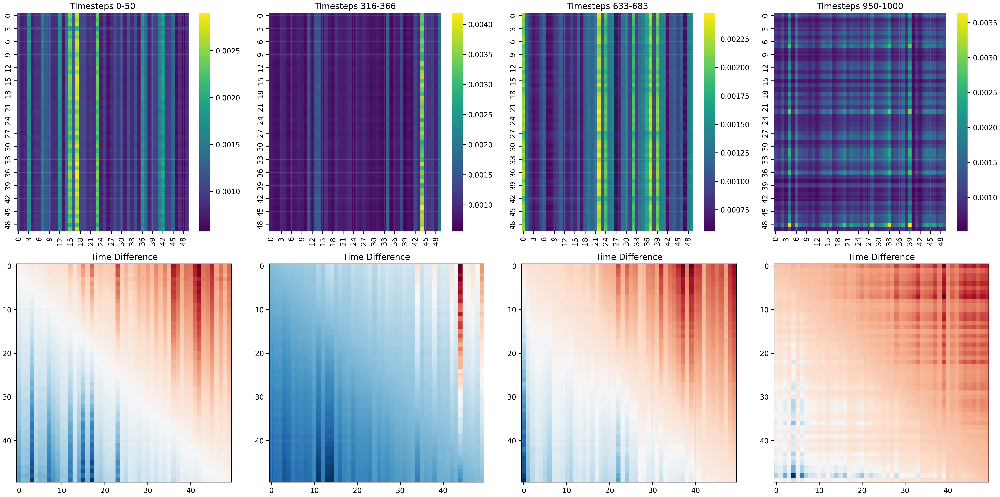

In [114]:
# Compare patterns across the trajectory
analyze_attention_across_trajectory(
    model,
    trajs[0, :, :],
    n_sections=4,
    window_size=50,
    layer_id=0
)

# Medium model - wild

In [84]:
config = joblib.load("models/MB_wilder_normal/config.jblb")

In [85]:
config_dict = config.to_dict()

In [86]:
config_dict.update({
    "output_attentions": True,
    "return_dict": True,  # Note: use 'return_dict' instead of 'use_return_dict'
    "output_hidden_states": True
})

In [87]:
config = BertConfig(**config_dict)

In [88]:
model = modelling.MDTrajectoryTransformer(config=config,  # NOTE: the space dimension
                                          n_features=2,
                                          n_states=2,
)

In [89]:
checkpoint_path = "models/MB_wilder_normal/last.ckpt/checkpoint/mp_rank_00_model_states.pt"

# Load the model with fixed prefixes
model = fix_prefix_and_load_model(checkpoint_path, model)

Checkpoint loaded successfully with fixed prefixes!


In [90]:
model = model.to("cuda")

In [186]:
losses = joblib.load("models/MB_wilder_normal/training_losses.jblb")

In [187]:
losses = pd.Series(losses)

<Axes: >

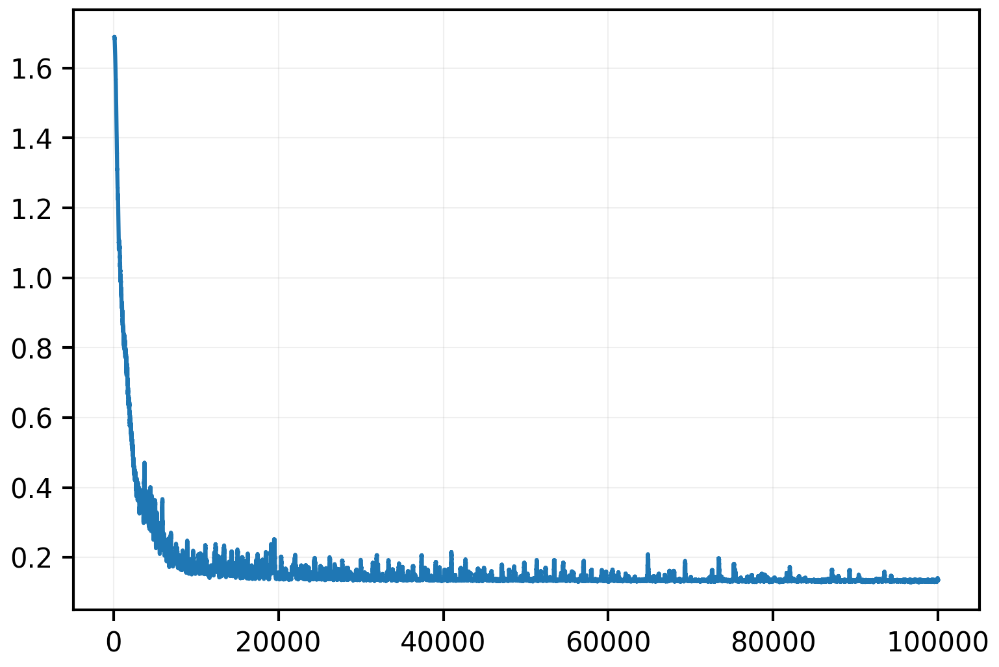

In [188]:
losses.rolling(window=100).mean().plot()
# plt.ylim((0, max(losses)));

## Trajectory

In [189]:
predicted = model.predict_trajectory(
    torch.tensor(trajectories[50]).unsqueeze(0).to("cuda"),
    n_steps=100,
    stride=25
).squeeze().to("cpu")

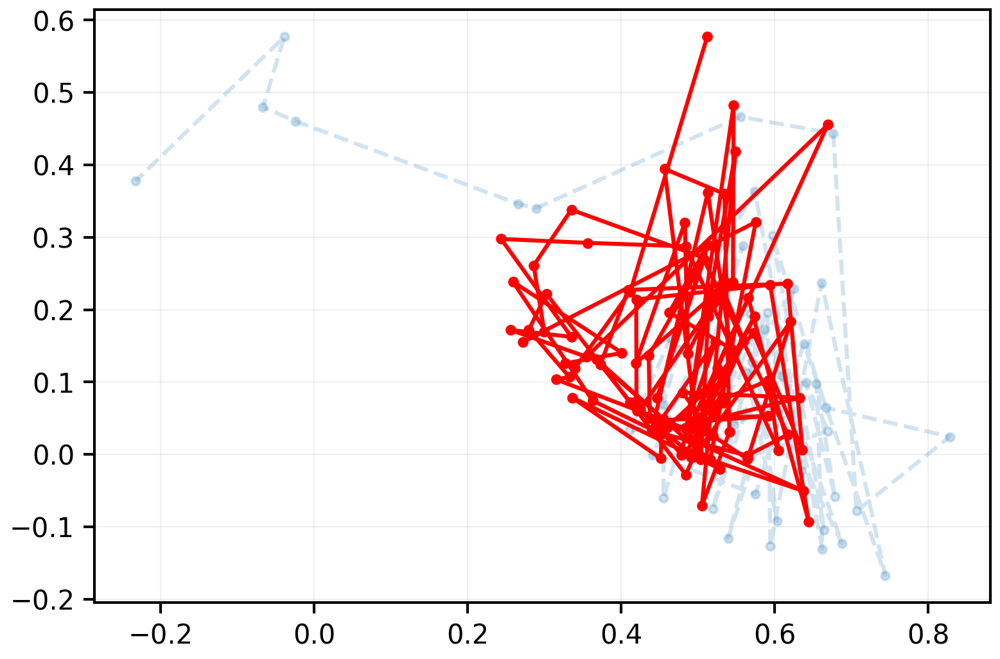

In [190]:
plt.plot(torch.tensor(trajectories[5])[950:, 0], torch.tensor(trajectories[5])[950:, 1], ls="--", marker=".", alpha=0.2)
plt.plot(predicted[1001:, 0], predicted[1001:, 1], c="r", ls="-", marker=".", alpha=1)

### Generated trajectories

In [191]:
idx = np.random.choice(1000, 1, replace=False)

In [192]:
idx

array([107])

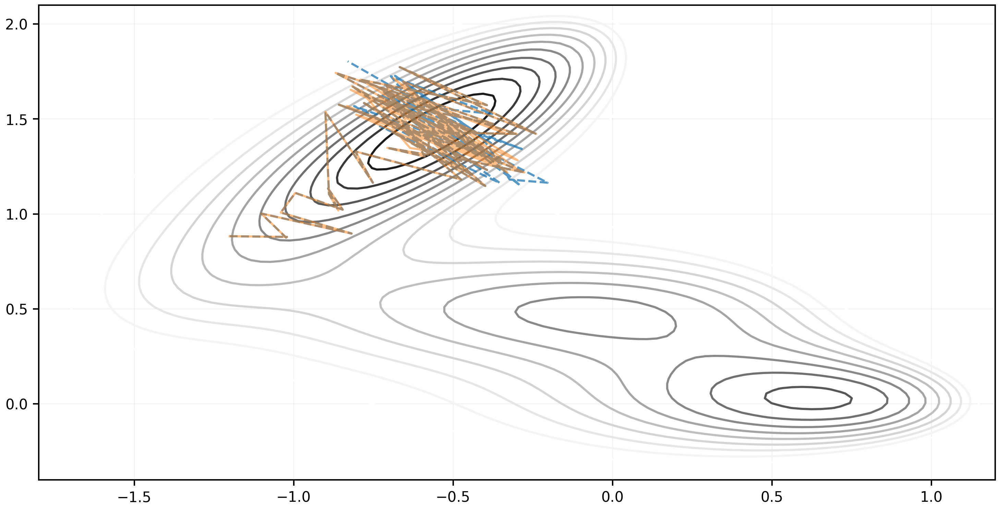

In [193]:
fig, axs = plt.subplots( 1, 1, figsize=(12, 6))
plot_isolines_2D(muller_brown_potential,levels=np.linspace(0,24,12),mode='contour',ax=axs)


init = 50
stop = 75
plt.plot(test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 0],
         test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 1],
         ls="--", 
         alpha=0.75);

predicted = model.predict_trajectory(
    test_trajs[idx, :init, :].to("cuda"),
    n_steps=stop - init,
    stride=25
).to("cpu").numpy()

plt.plot(predicted.transpose(1, 0, 2)[:stop, :, 0],
         predicted.transpose(1, 0, 2)[:stop, :, 1],
         alpha=0.5);

In [194]:
idx = np.random.choice(500, 1, replace=False)

In [195]:
idx

array([233])

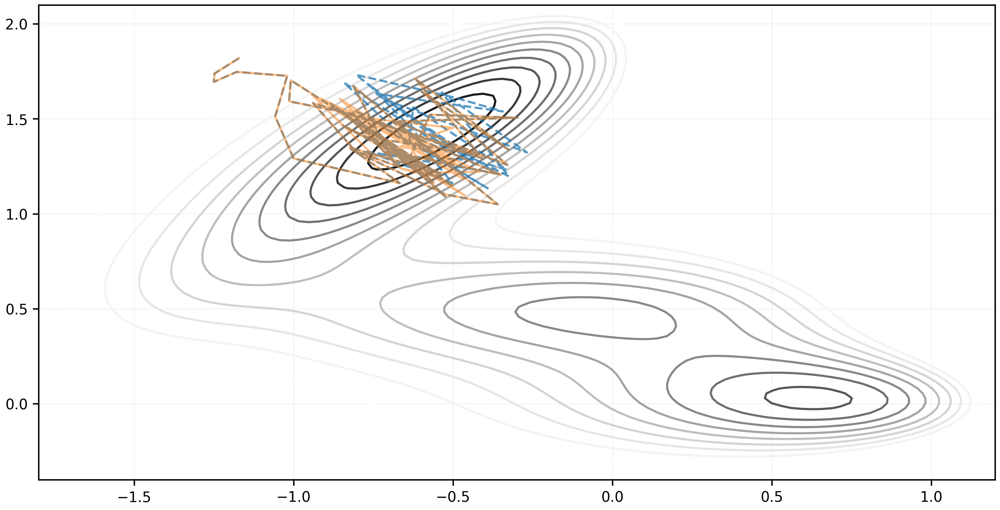

In [196]:
fig, axs = plt.subplots( 1, 1, figsize=(12, 6))
plot_isolines_2D(muller_brown_potential,levels=np.linspace(0,24,12),mode='contour',ax=axs)


init = 50
stop = 75
plt.plot(test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 0],
         test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 1],
         ls="--", 
         alpha=0.75);

predicted = model.predict_trajectory(
    test_trajs[idx, :init, :].to("cuda"),
    n_steps=stop - init,
    stride=25
).to("cpu").numpy()

plt.plot(predicted.transpose(1, 0, 2)[:stop, :, 0],
         predicted.transpose(1, 0, 2)[:stop, :, 1],
         alpha=0.5);

### Metrics

**stride effects**

In [91]:
stride_metrics = {}

for stride in np.linspace(1, 60, 10, dtype=int):
# Analyze predictions
    _, _, stride_metrics[stride], _ = analyze_trajectory_prediction(
        model,
        test_trajs[:100, :, :],
        initial_sequence_length=500,
        prediction_length=100,
        stride=stride
    )

In [92]:
stride_metrics

{1: {'mse': 0.1403221671014234,
  'rmse': 0.32469745547521,
  'mae': 0.26870921846634327,
  'relative_error': 0.6836640874813698},
 7: {'mse': 0.11506537709917347,
  'rmse': 0.2990759580937537,
  'mae': 0.24901638459693345,
  'relative_error': 0.6107778314496158},
 14: {'mse': 0.11220942013730956,
  'rmse': 0.29517147281691375,
  'mae': 0.2447791780001188,
  'relative_error': 0.6016167515653296},
 20: {'mse': 0.11472254334526792,
  'rmse': 0.2987720764622329,
  'mae': 0.24808588496302897,
  'relative_error': 0.6097259934753145},
 27: {'mse': 0.11661310284153177,
  'rmse': 0.29822414357774013,
  'mae': 0.24878856894055432,
  'relative_error': 0.6132279270849722},
 33: {'mse': 0.1171362657868146,
  'rmse': 0.29893349717908874,
  'mae': 0.2487475226943662,
  'relative_error': 0.6137817983107103},
 40: {'mse': 0.11935967392314602,
  'rmse': 0.30084896478896983,
  'mae': 0.2509280743782416,
  'relative_error': 0.6168875720664723},
 46: {'mse': 0.11849883170933415,
  'rmse': 0.29885868246589

In [93]:
min_stride = min(stride_metrics.keys(), key=lambda k: stride_metrics[k]['mse'])
min_stride

14

In [94]:
# Analyze predictions
actual, predicted, avg_metrics, per_traj_metrics = analyze_trajectory_prediction(
    model,
    test_trajs[:100, :, :],
    initial_sequence_length=500,
    prediction_length=100,
    stride=14
)

In [95]:
# Print metrics
print("\nPrediction Metrics:")
for name, value in avg_metrics.items():
    print(f"{name}: {value:.4f}")


Prediction Metrics:
mse: 0.1122
rmse: 0.2952
mae: 0.2448
relative_error: 0.6016


In [197]:
# Analyze predictions
actual, predicted, avg_metrics, per_traj_metrics = analyze_trajectory_prediction(
    model,
    test_trajs,
    initial_sequence_length=100,
    prediction_length=200,
    stride=25
)

# Print metrics
print("\nPrediction Metrics:")
for name, value in avg_metrics.items():
    print(f"{name}: {value:.4f}")


Prediction Metrics:
mse: 0.1428
rmse: 0.3239
mae: 0.2694
relative_error: 0.6621


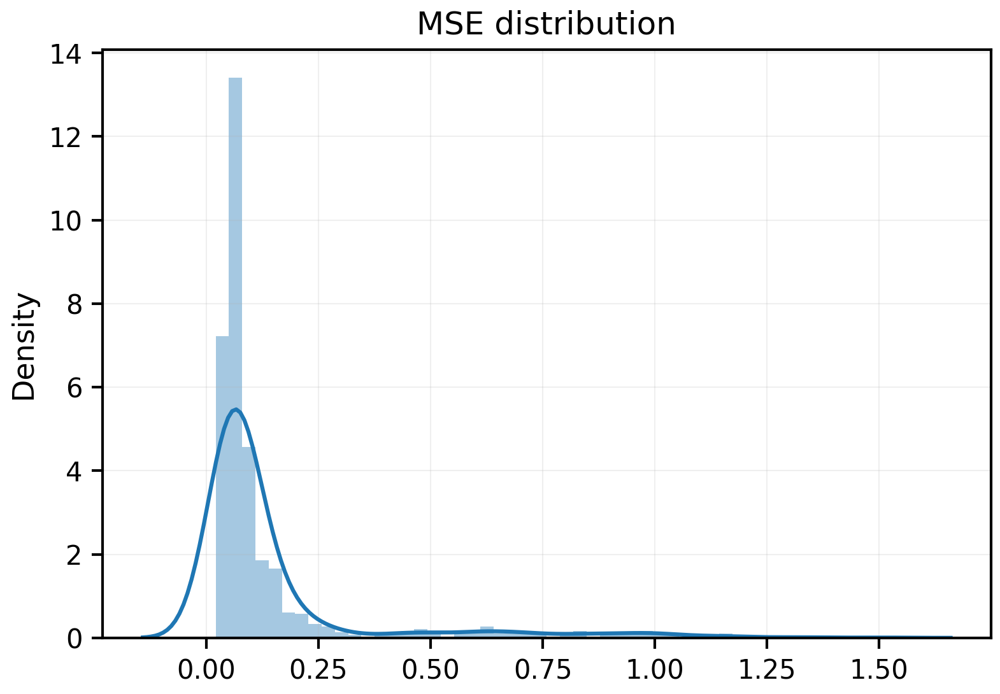

In [198]:
sns.distplot(per_traj_metrics["mse"]);
plt.title("MSE distribution");

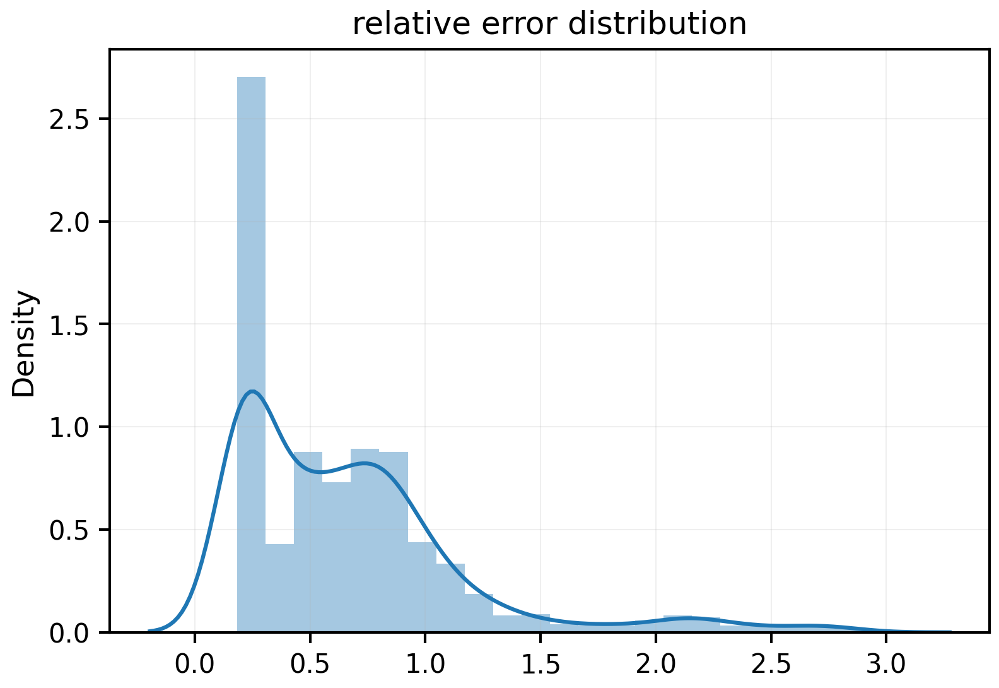

In [199]:
sns.distplot(per_traj_metrics["relative_error"]);
plt.title("relative error distribution");

In [172]:
test_trajectory = torch.tensor(trajectories[50])


Prediction Metrics:
mse: 0.0071
rmse: 0.0841
mae: 0.0690
relative_error: 0.2573


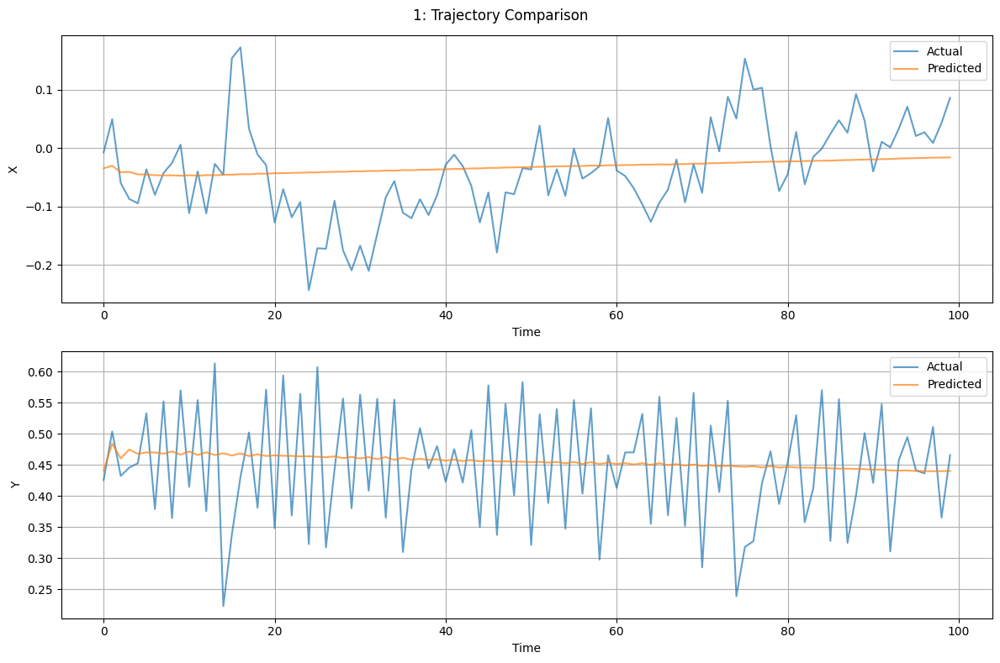

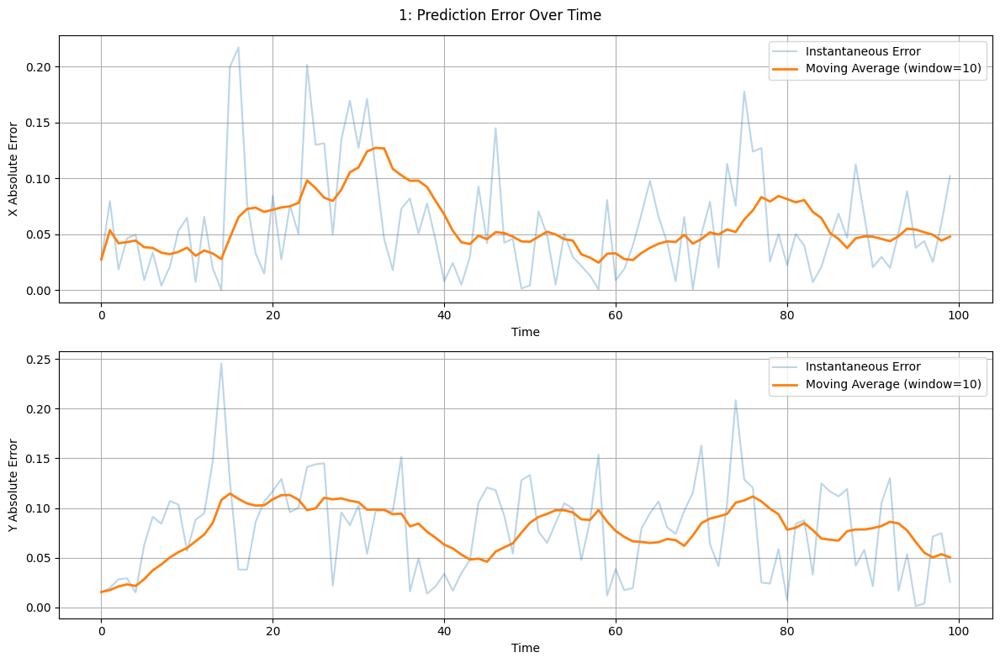


Prediction Metrics:
mse: 0.0068
rmse: 0.0827
mae: 0.0672
relative_error: 0.2519


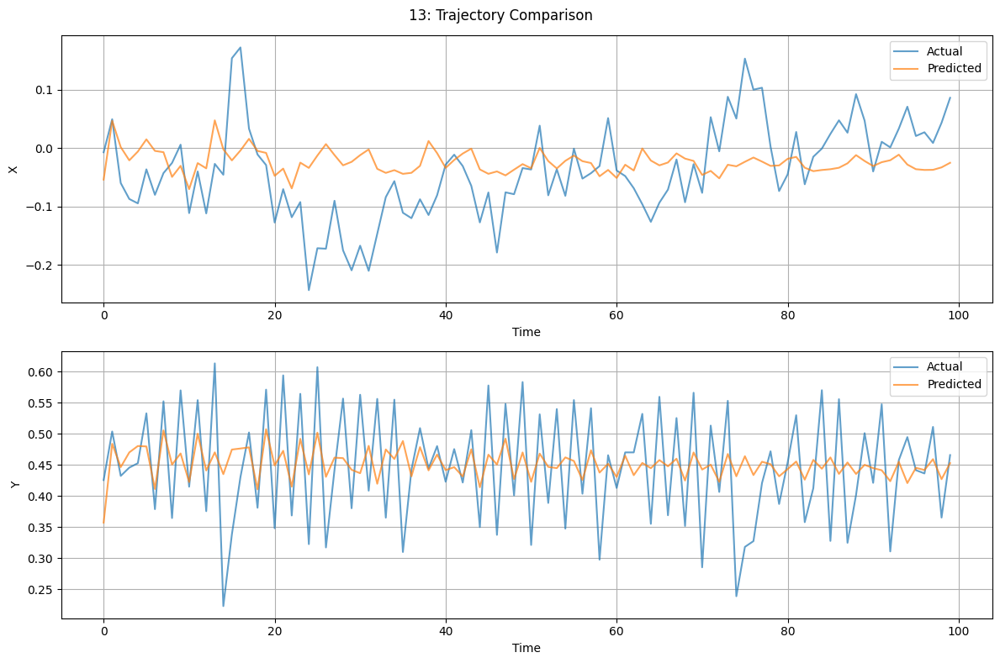

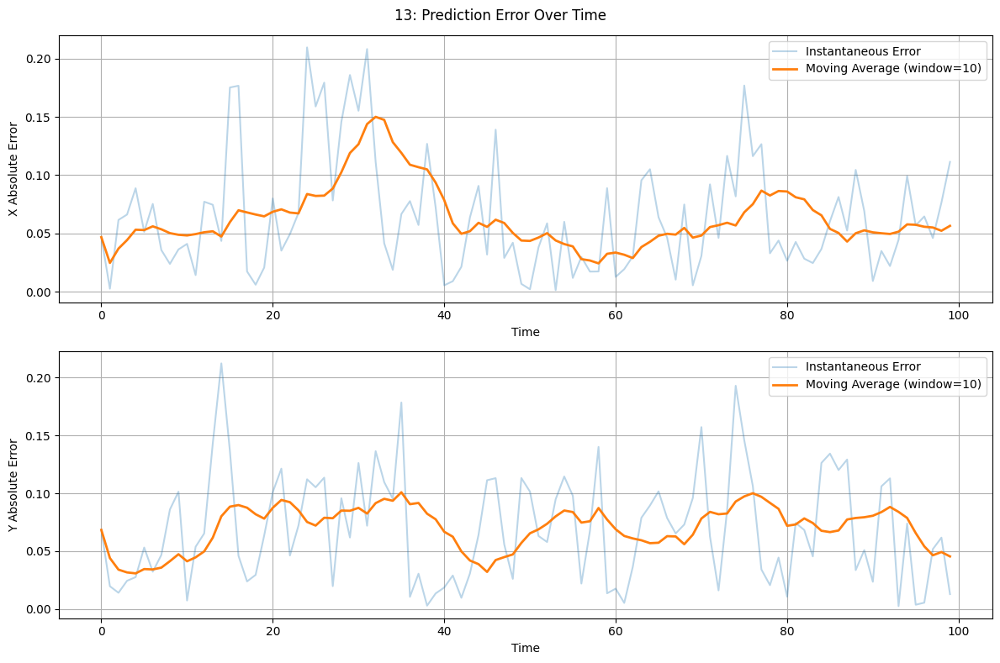


Prediction Metrics:
mse: 0.0076
rmse: 0.0872
mae: 0.0719
relative_error: 0.2657


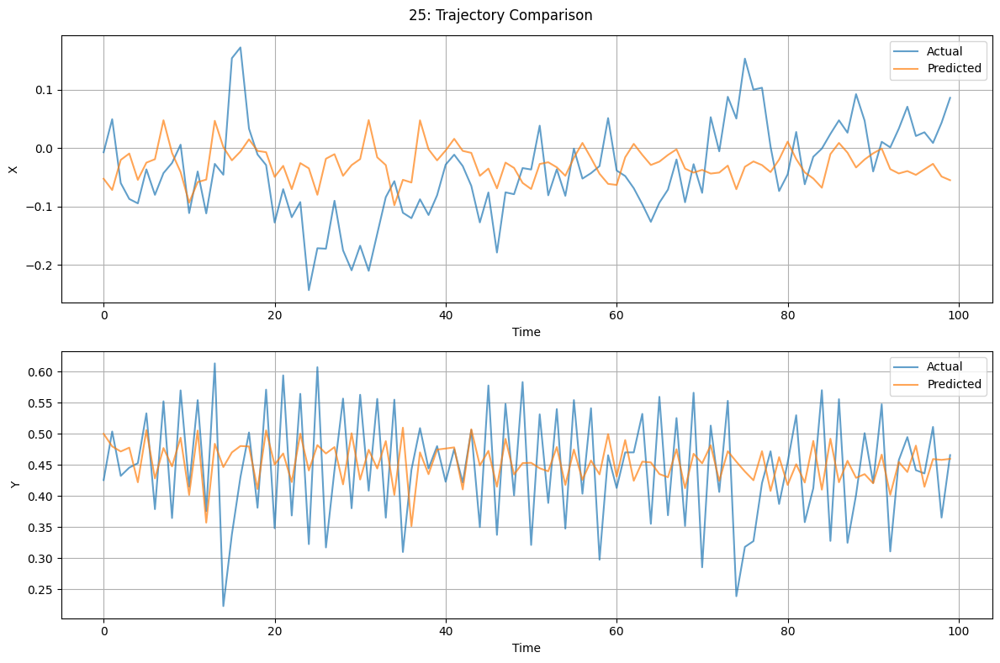

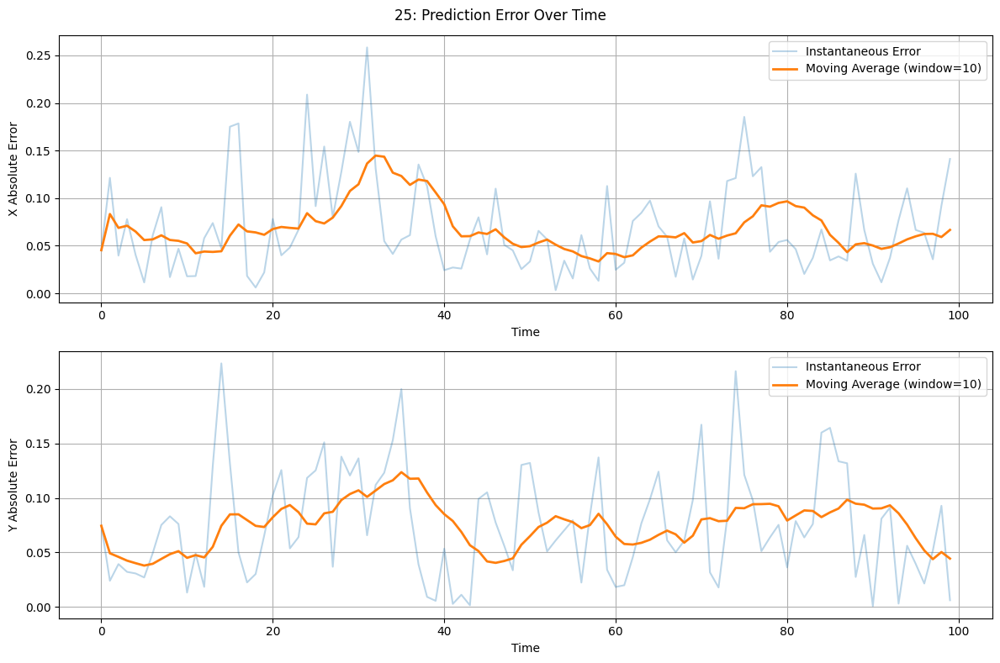


Prediction Metrics:
mse: 0.0087
rmse: 0.0928
mae: 0.0760
relative_error: 0.2838


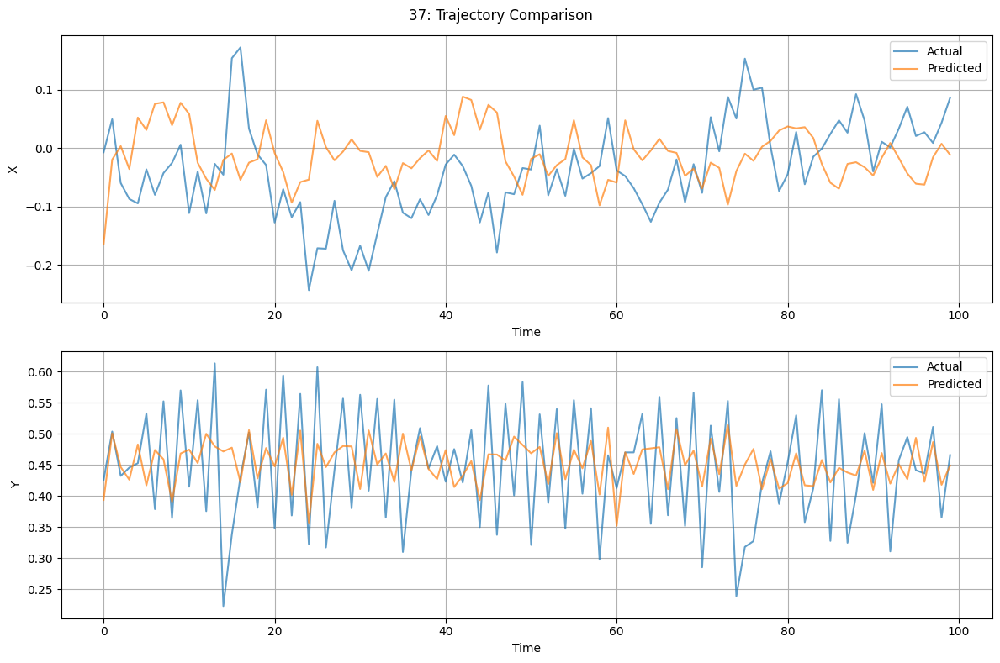

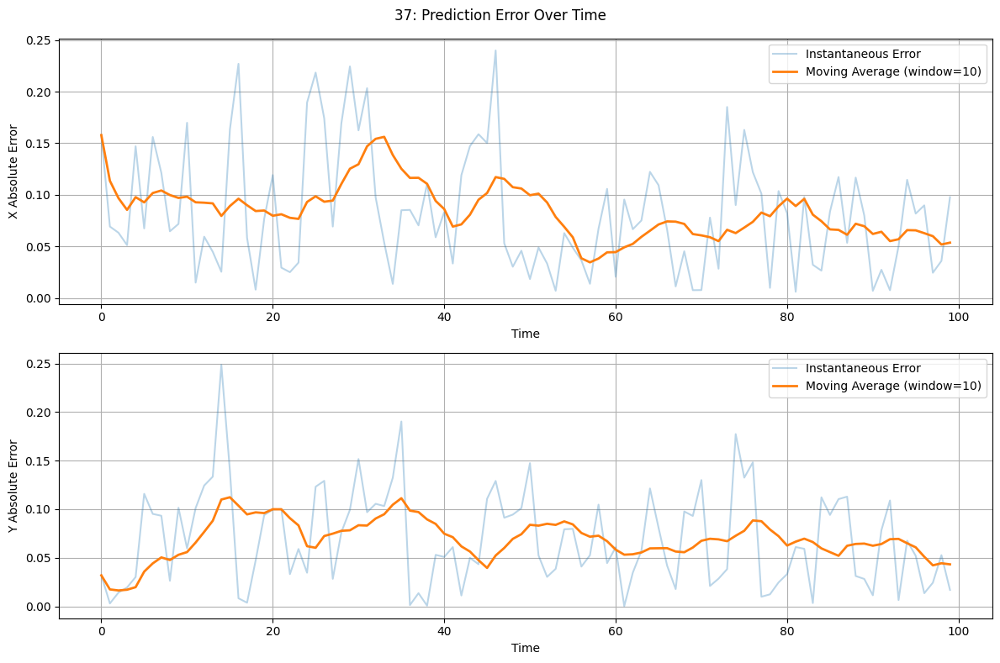


Prediction Metrics:
mse: 0.0103
rmse: 0.1016
mae: 0.0850
relative_error: 0.3097


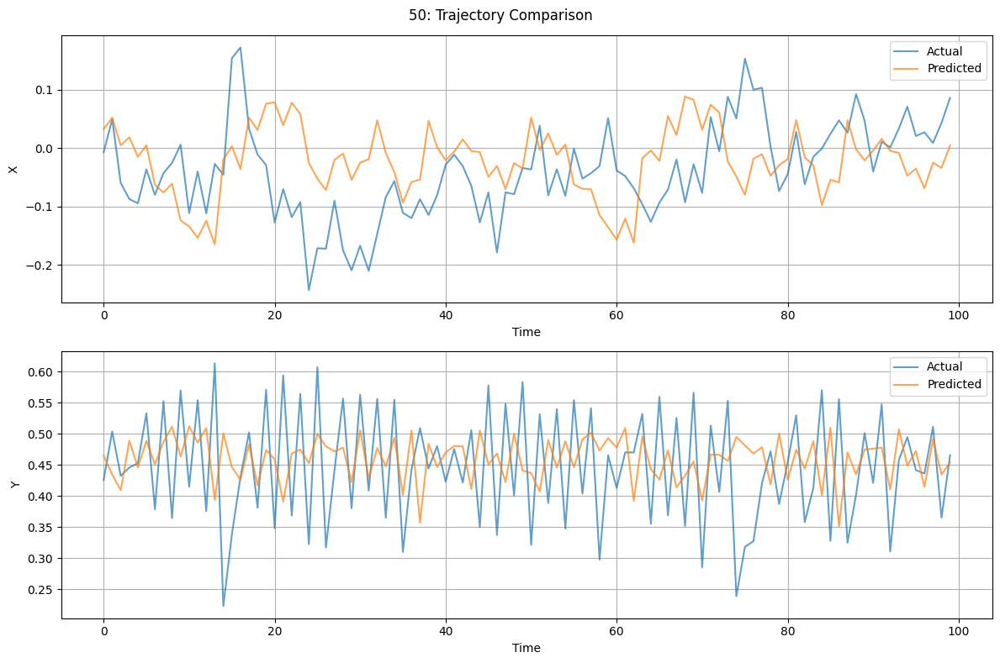

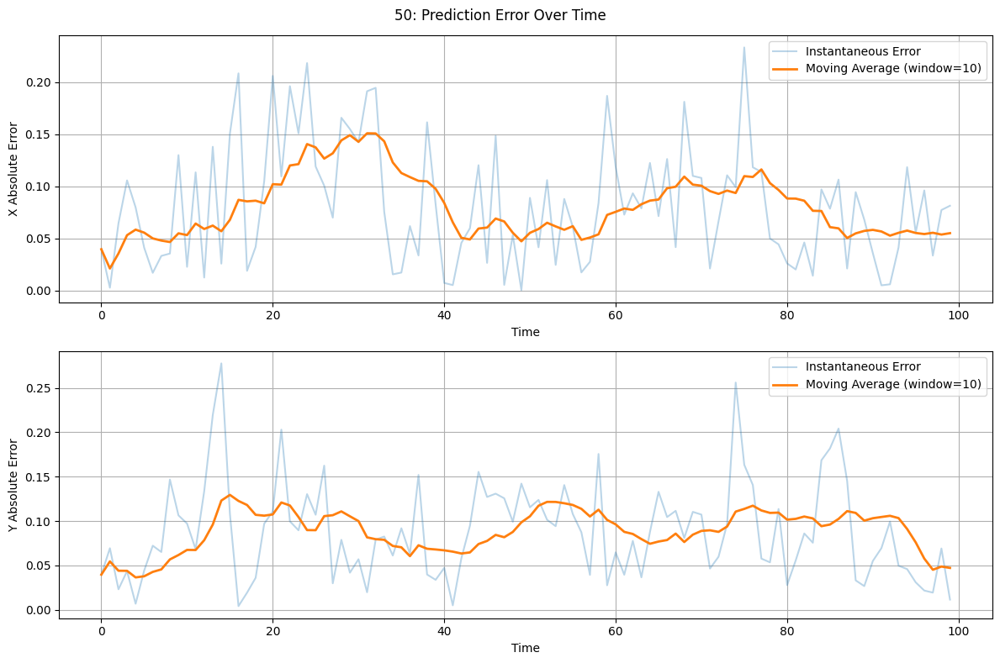

In [177]:
for stride in np.linspace(1, 50, 5, dtype=int):

    # Analyze predictions
    actual1, predicted1, metrics1 = plotting.analyze_trajectory_prediction(
        model,
        test_trajectory = test_trajectory.to("cuda"),
        mean=test_trajectory.mean(dim=0).to("cuda"),
        std=test_trajectory.std(dim=0).to("cuda"),
        initial_sequence_length=900,
        prediction_length=100,
        stride=stride
    )
    
    # Print metrics
    print("\nPrediction Metrics:")
    for name, value in metrics1.items():
        print(f"{name}: {value:.4f}")
    
    # Plot comparisons
    plotting.plot_trajectory_comparison(
        actual1,
        predicted1,
        feature_names=['X', 'Y'],  # Replace with your feature names
        title=f"{stride}: Trajectory Comparison",
        # save_path="trajectory_comparison1.png"
    )
    
    # Plot error analysis
    plotting.plot_prediction_error(
        actual1,
        predicted1,
        feature_names=['X', 'Y'],  # Replace with your feature names
        window_size=10,
        title=f"{stride}: Prediction Error Over Time",
        # save_path="prediction_error1.png"
    )

## State

In [200]:
predictions  = model.classify_state(test_trajs.to("cuda"))

In [201]:
accuracy = accuracy_score(predictions["predictions"].cpu(), test_states)
precision = precision_score(predictions["predictions"].cpu(),  test_states, average='weighted')
recall = recall_score(predictions["predictions"].cpu(),  test_states, average='weighted')
f1 = f1_score(predictions["predictions"].cpu(),  test_states, average='weighted')

# Print the evaluation metrics
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

Accuracy: 0.9780
Precision: 0.9788
Recall: 0.9780
F1 Score: 0.9780


### Partial trajectory

In [202]:
part_predictions  = model.classify_state(test_trajs[:, :500, :].to("cuda"))

In [203]:
accuracy = accuracy_score(part_predictions["predictions"].cpu(), test_states)
precision = precision_score(part_predictions["predictions"].cpu(),  test_states, average='weighted')
recall = recall_score(part_predictions["predictions"].cpu(),  test_states, average='weighted')
f1 = f1_score(part_predictions["predictions"].cpu(),  test_states, average='weighted')

# Print the evaluation metrics
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

Accuracy: 0.9690
Precision: 0.9690
Recall: 0.9690
F1 Score: 0.9690


In [204]:
seg_length = 500
mean_acc, acc_by_pos, pred_states = evaluate_segments(test_trajs.to("cuda"), test_states, model, segment_length=seg_length,
                                                      n_segments=1000 // seg_length)
print(f"Mean accuracy: {mean_acc:.3f}")

Mean accuracy: 0.853


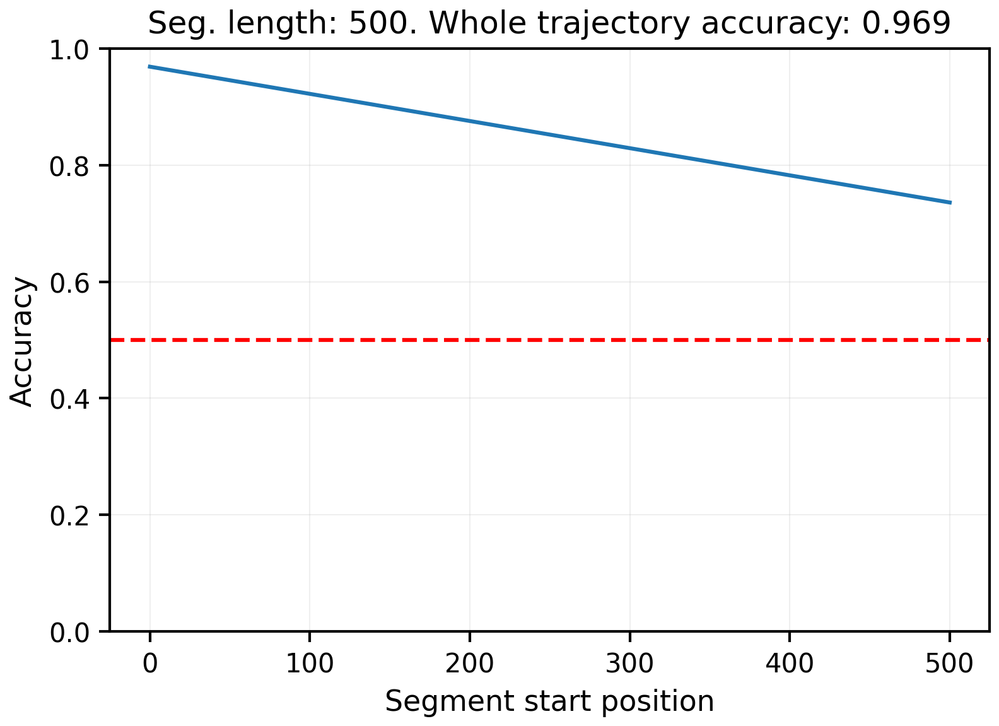

In [205]:
# Plot accuracy vs position
plt.plot(acc_by_pos.keys(), acc_by_pos.values())
plt.xlabel("Segment start position");
plt.ylabel("Accuracy");
plt.ylim((0, 1));
plt.axhline(0.5, c="r", ls="--");
plt.title(f"Seg. length: {seg_length}. Whole trajectory accuracy: {accuracy:.3f}");

In [206]:
seg_length = 250
mean_acc, acc_by_pos, pred_states = evaluate_segments(test_trajs.to("cuda"), test_states, model, segment_length=seg_length,
                                                      n_segments=1000 // seg_length)
print(f"Mean accuracy: {mean_acc:.3f}")

Mean accuracy: 0.786


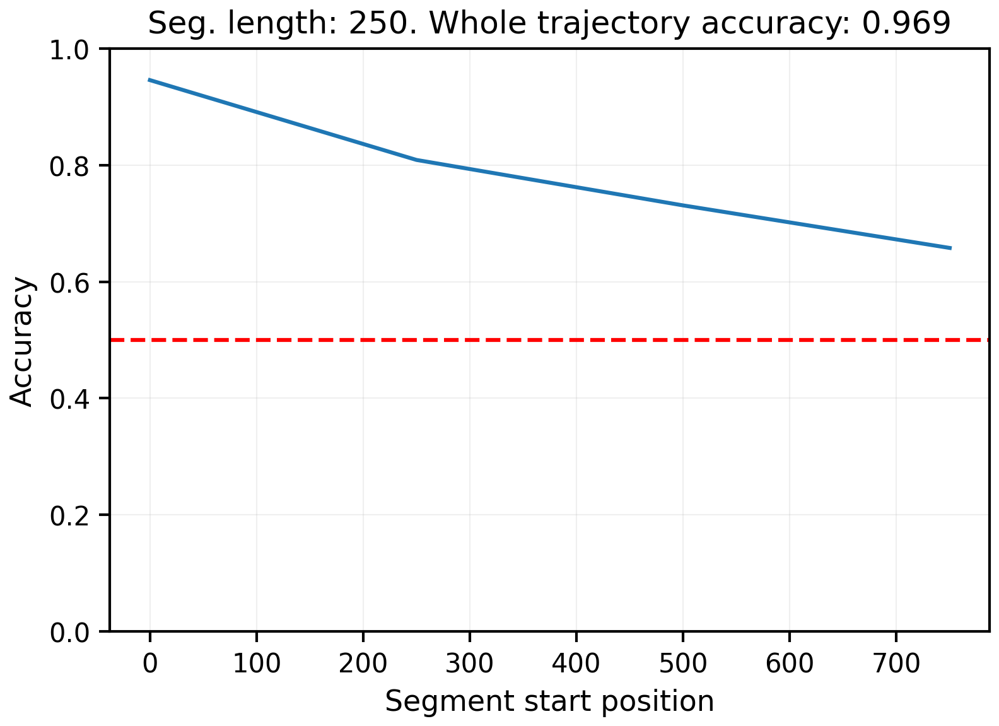

In [207]:
# Plot accuracy vs position
plt.plot(acc_by_pos.keys(), acc_by_pos.values())
plt.xlabel("Segment start position");
plt.ylabel("Accuracy");
plt.ylim((0, 1));
plt.axhline(0.5, c="r", ls="--");
plt.title(f"Seg. length: {seg_length}. Whole trajectory accuracy: {accuracy:.3f}");

In [208]:
seg_length = 100
mean_acc, acc_by_pos, pred_states = evaluate_segments(test_trajs.to("cuda"), test_states, model,
                                                      segment_length=seg_length,
                                                      n_segments=1000 // seg_length)
print(f"Mean accuracy: {mean_acc:.3f}")

Mean accuracy: 0.697


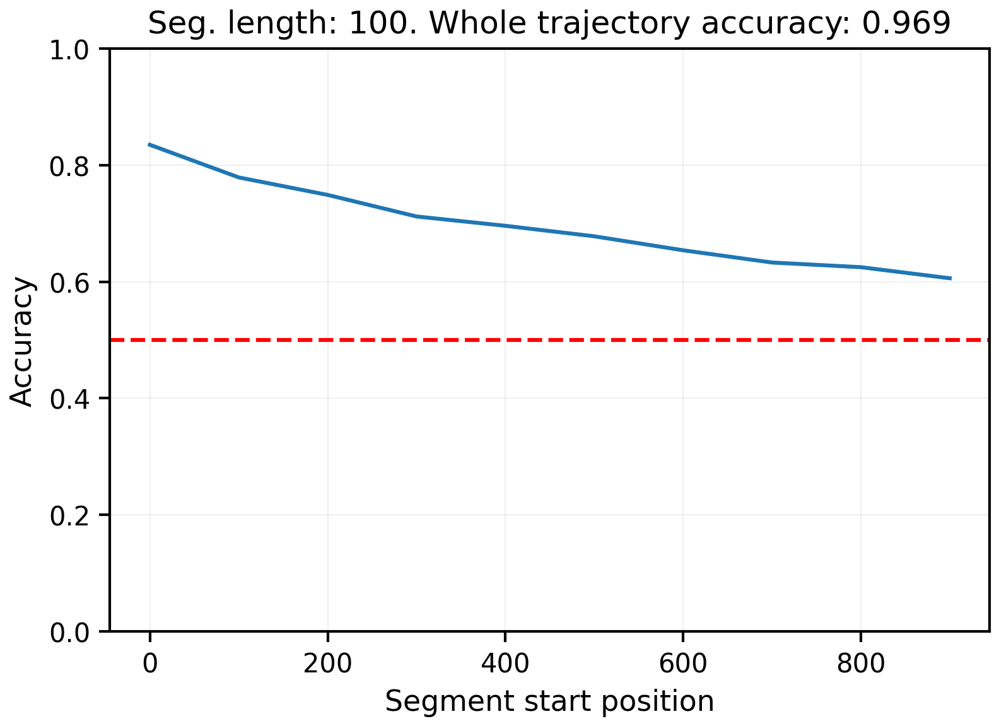

In [209]:
# Plot accuracy vs position
plt.plot(acc_by_pos.keys(), acc_by_pos.values())
plt.xlabel("Segment start position");
plt.ylabel("Accuracy");
plt.ylim((0, 1));
plt.axhline(0.5, c="r", ls="--");
plt.title(f"Seg. length: {seg_length}. Whole trajectory accuracy: {accuracy:.3f}");

## Embeddings

In [283]:
# More detailed analysis
attention_data = get_attention_maps(model, trajs[0, :, :], return_hiddens=True)

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


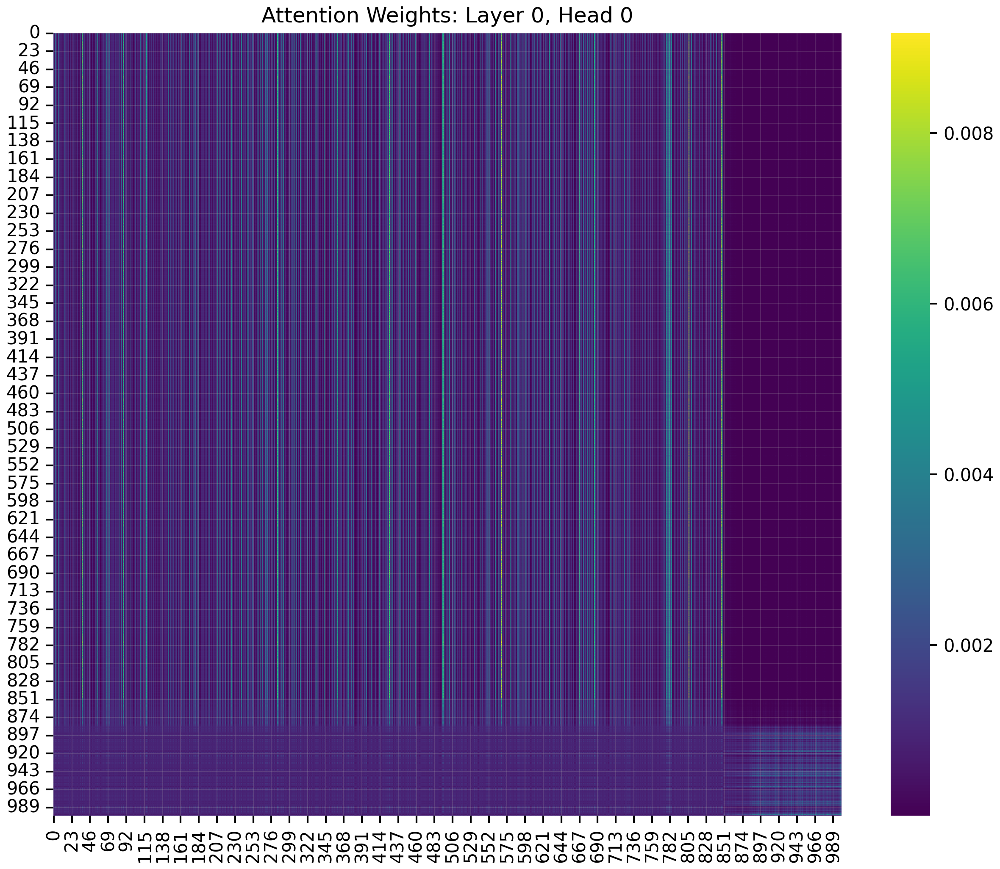

In [284]:
# Examine specific layer and head
layer_idx = 0  # First layer
head_idx = 0   # First attention head
attention_weights = attention_data['all_head_outputs']['attn'][layer_idx][0, head_idx]

# Can also create custom visualizations with the attention weights
import seaborn as sns
plt.figure(figsize=(10, 8))
sns.heatmap(attention_weights, cmap='viridis')
plt.title(f'Attention Weights: Layer {layer_idx}, Head {head_idx}')
plt.show()

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


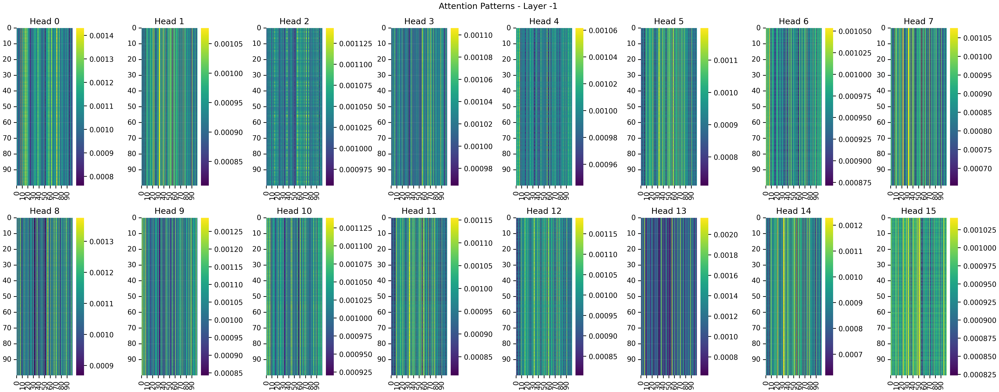

In [212]:
# View all attention heads for a section
visualize_attention(model, trajs[0, :, :], window_size=100, start_idx=0, layer_id=-1);

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


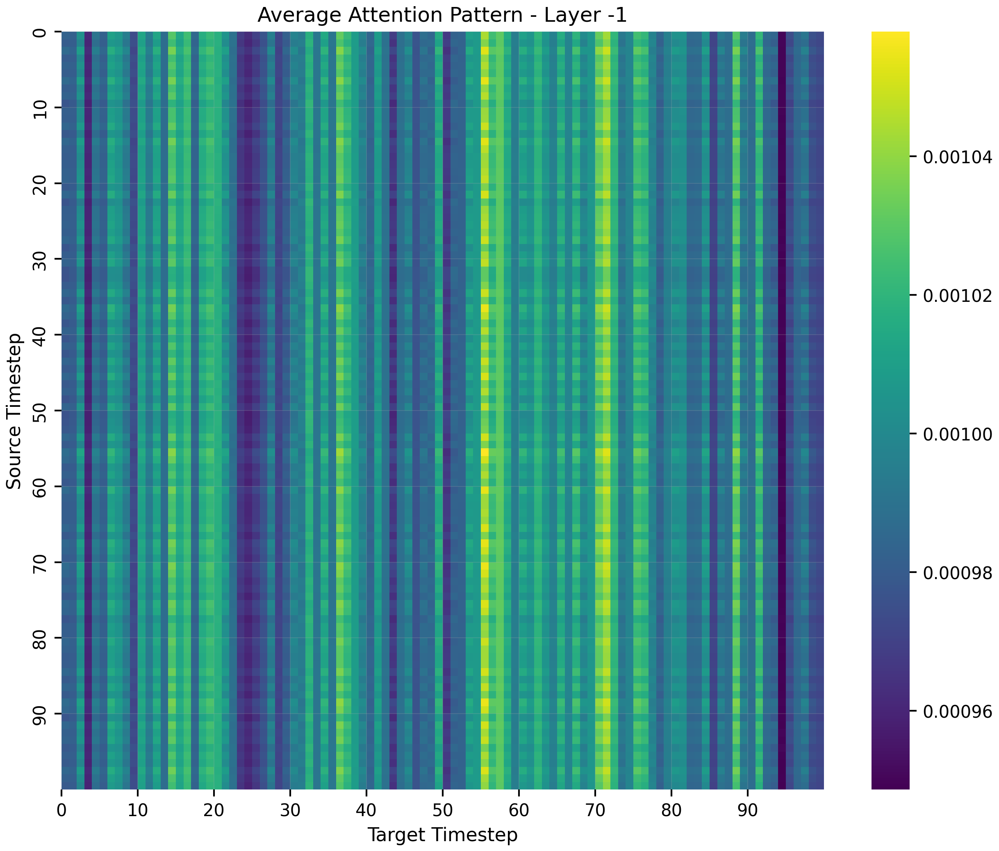

In [213]:
# View average attention pattern
plot_average_attention(model, trajs[0, :, :], window_size=100, start_idx=0, layer_id=-1);

Layer 0
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


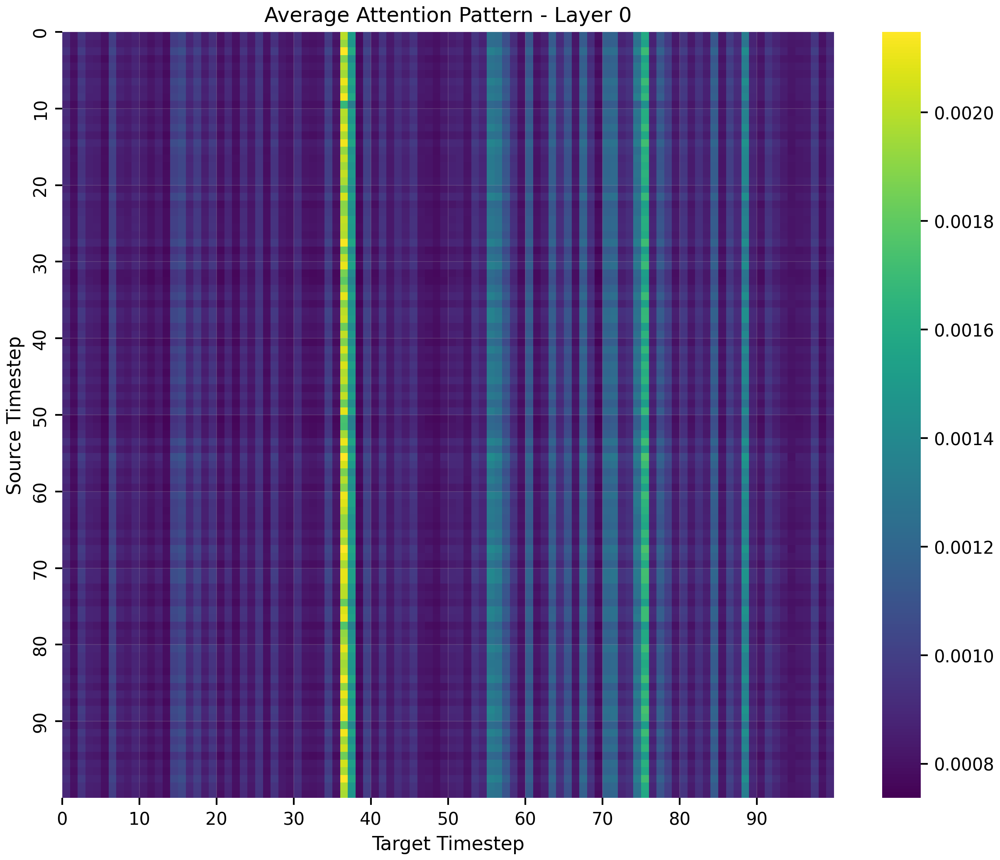

Layer 1
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


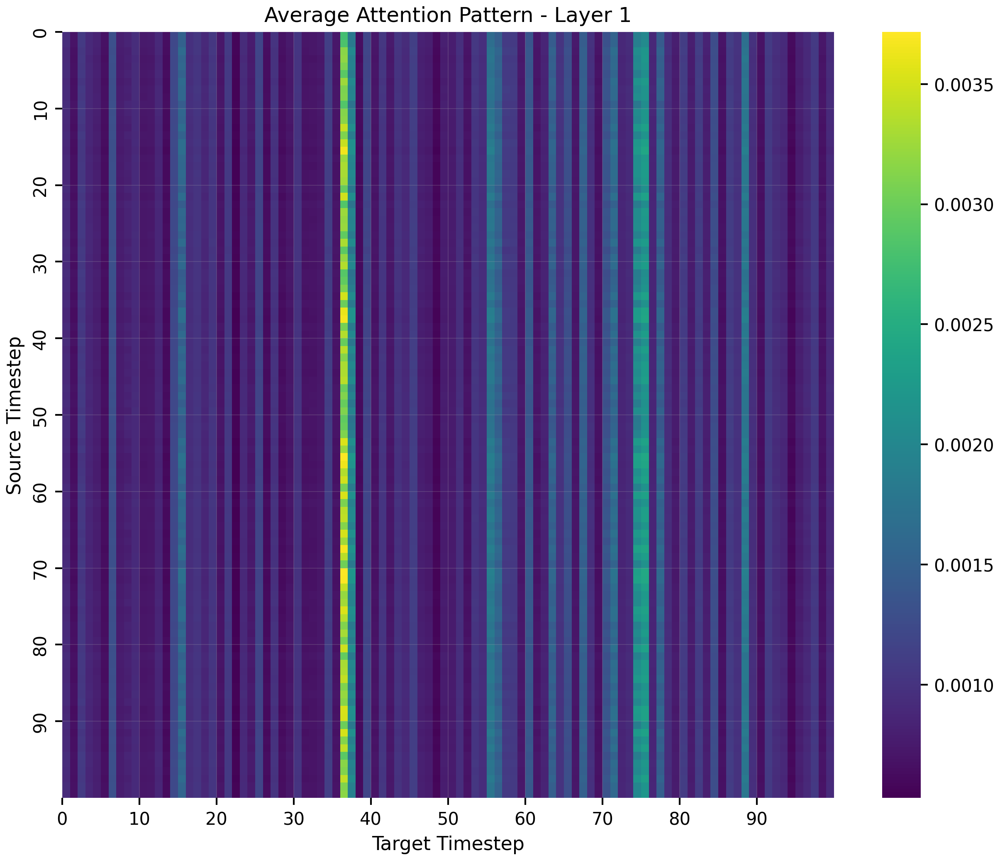

Layer 2
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


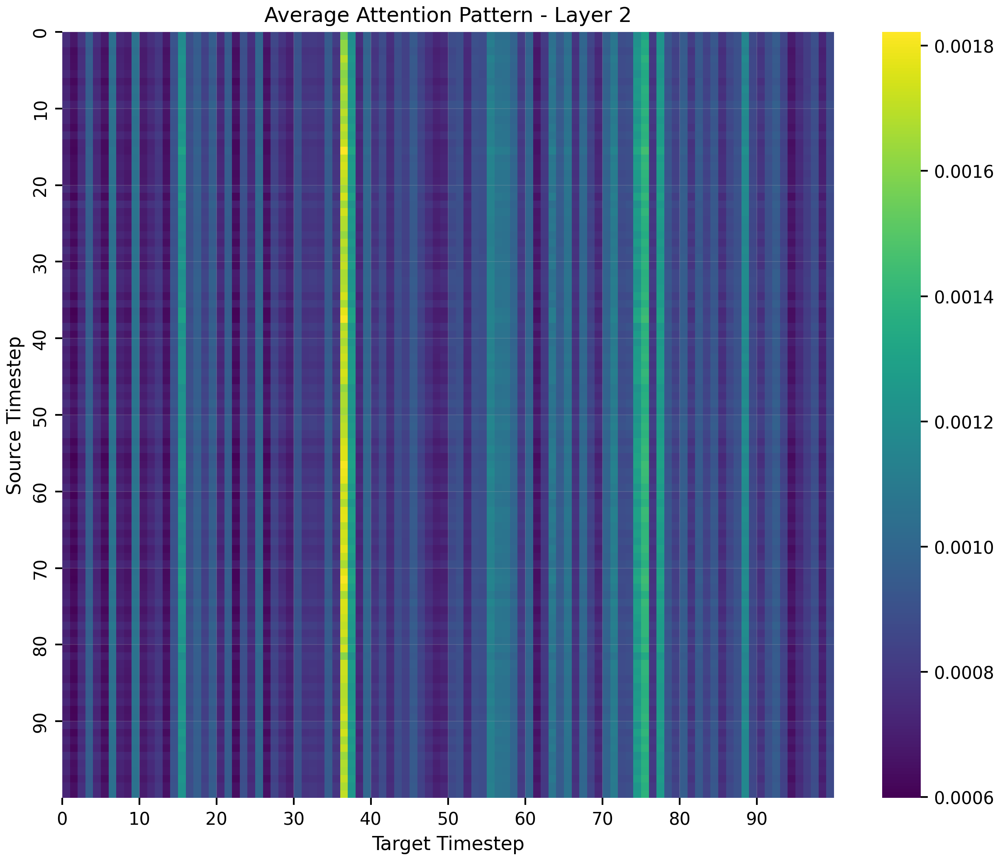

Layer 3
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


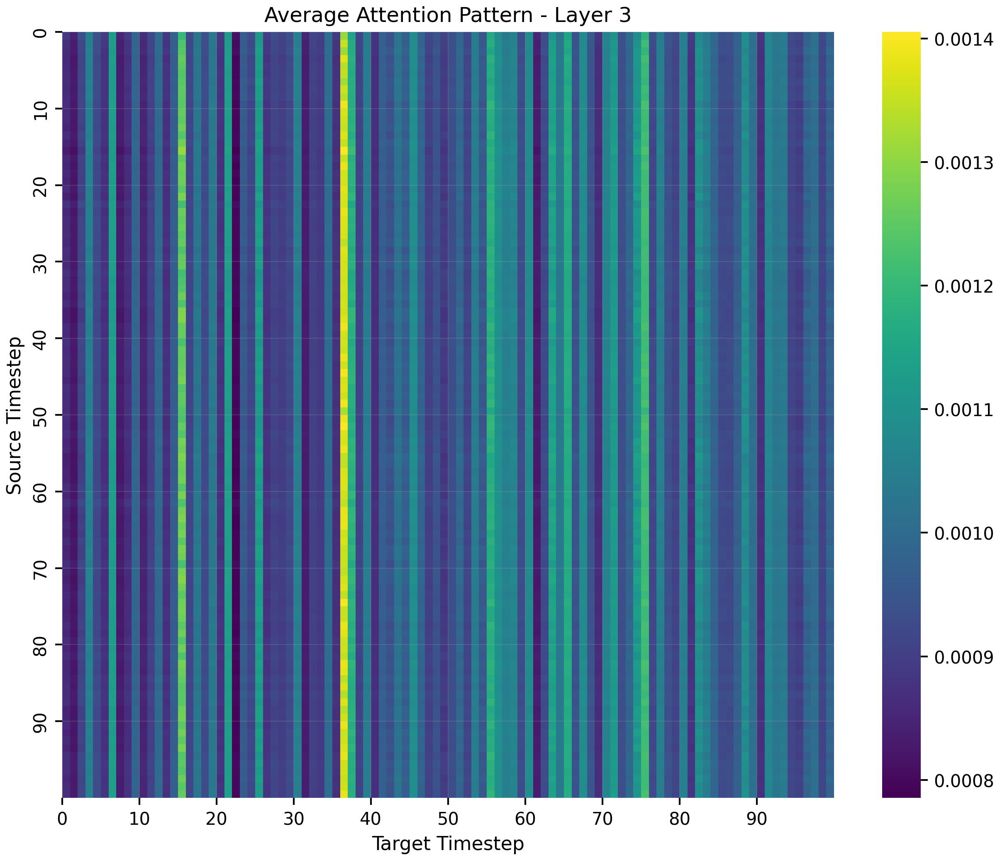

Layer 4
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


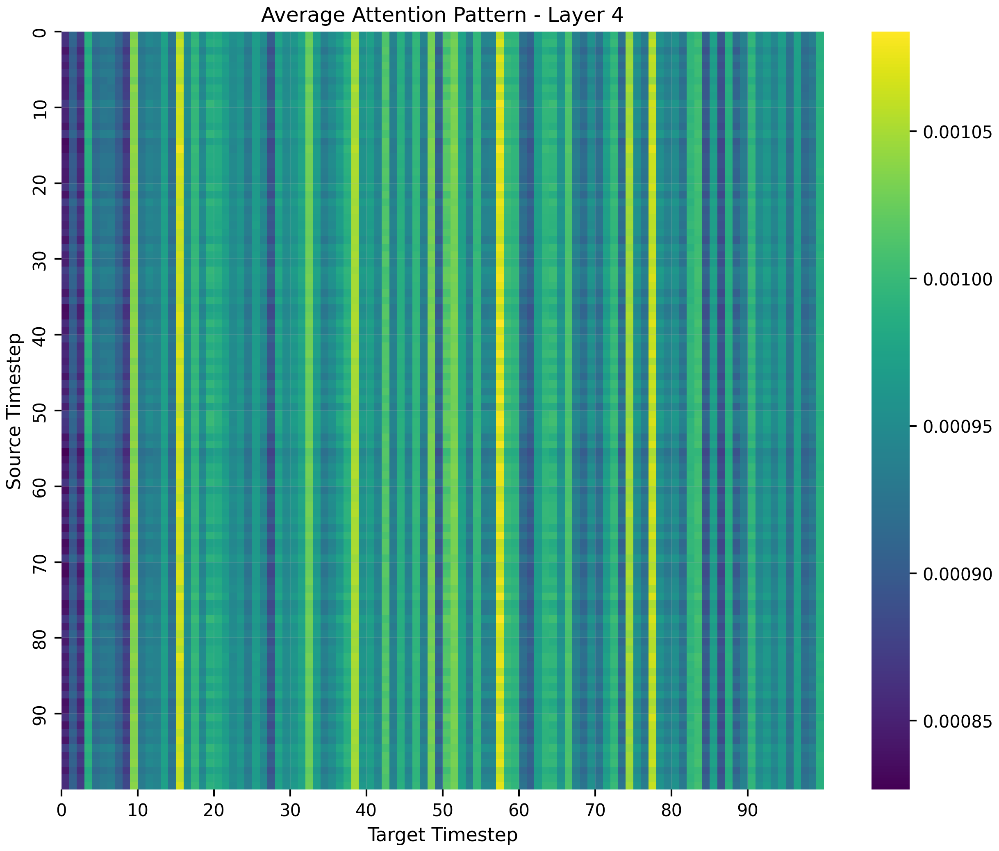

Layer 5
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


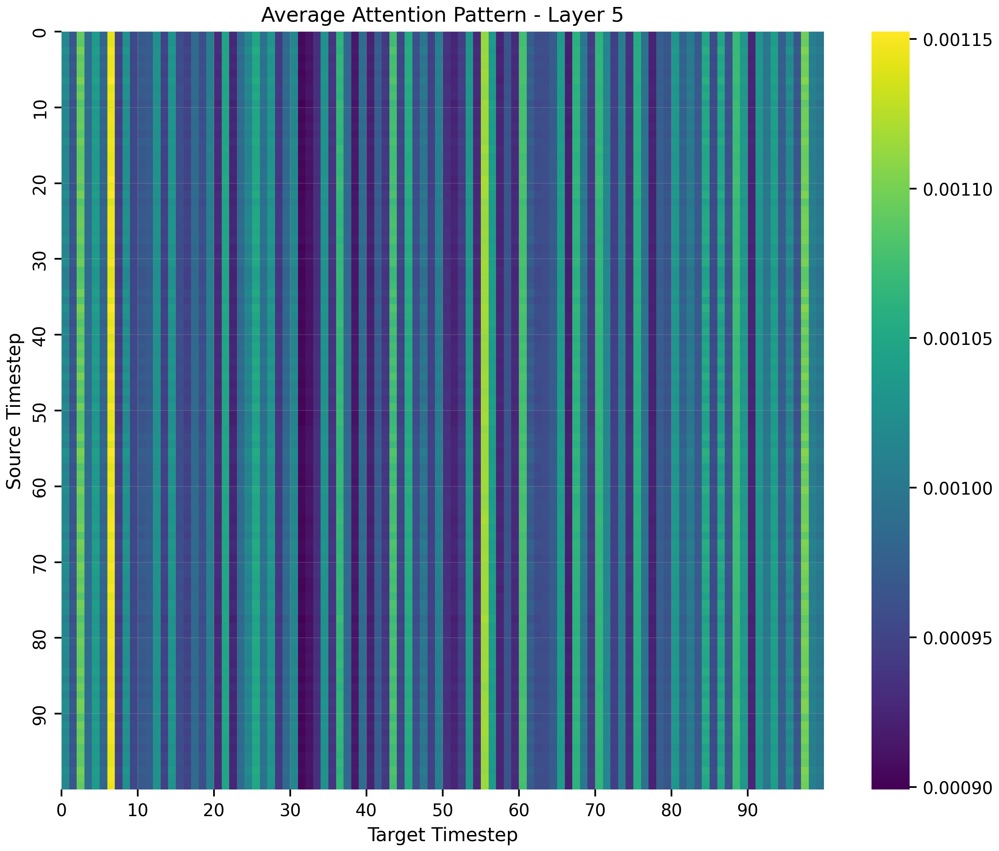

Layer 6
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


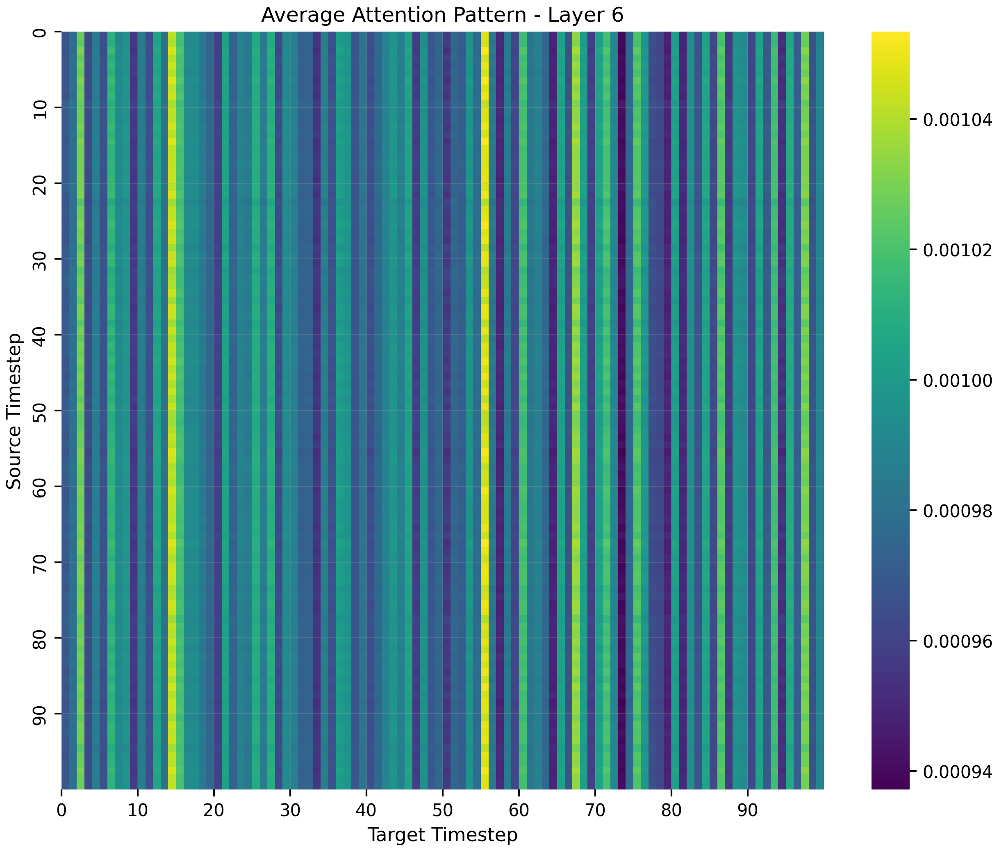

Layer 7
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


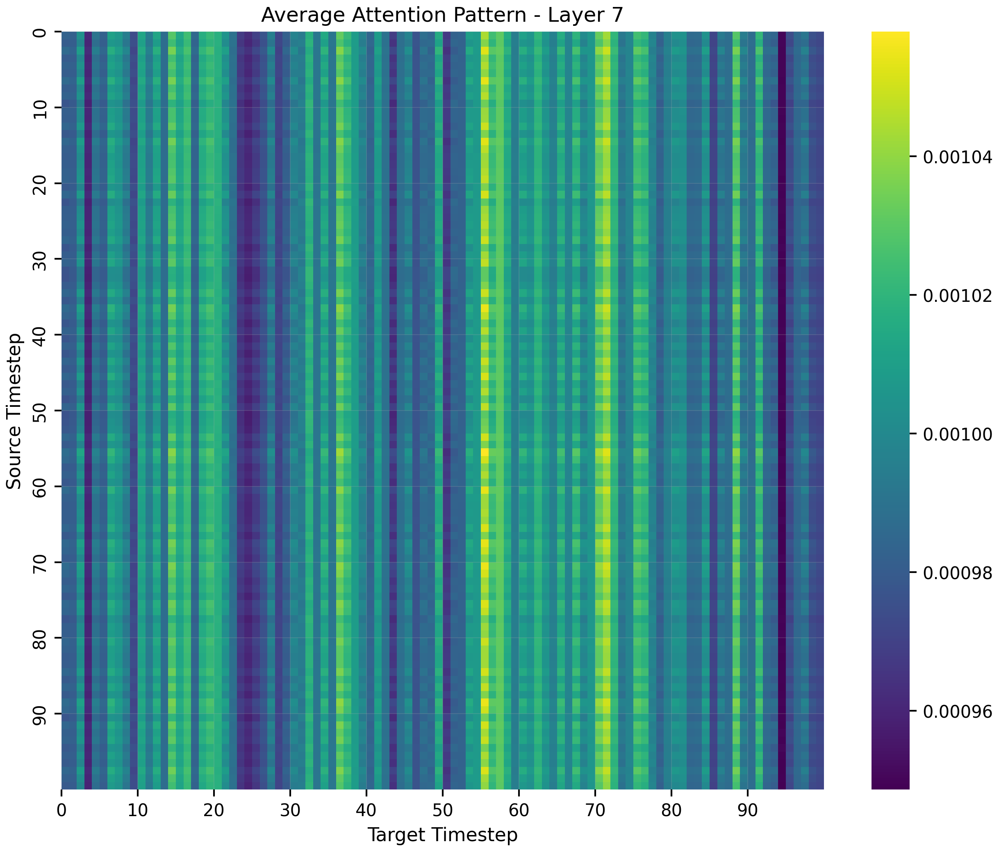

In [285]:
# Look at different layers
for layer in range(model.config.num_hidden_layers):
    print(f"Layer {layer}")
    plot_average_attention(model, trajs[0, :, :], window_size=100, start_idx=0, layer_id=layer)

all layers, all heads



Layer 0
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


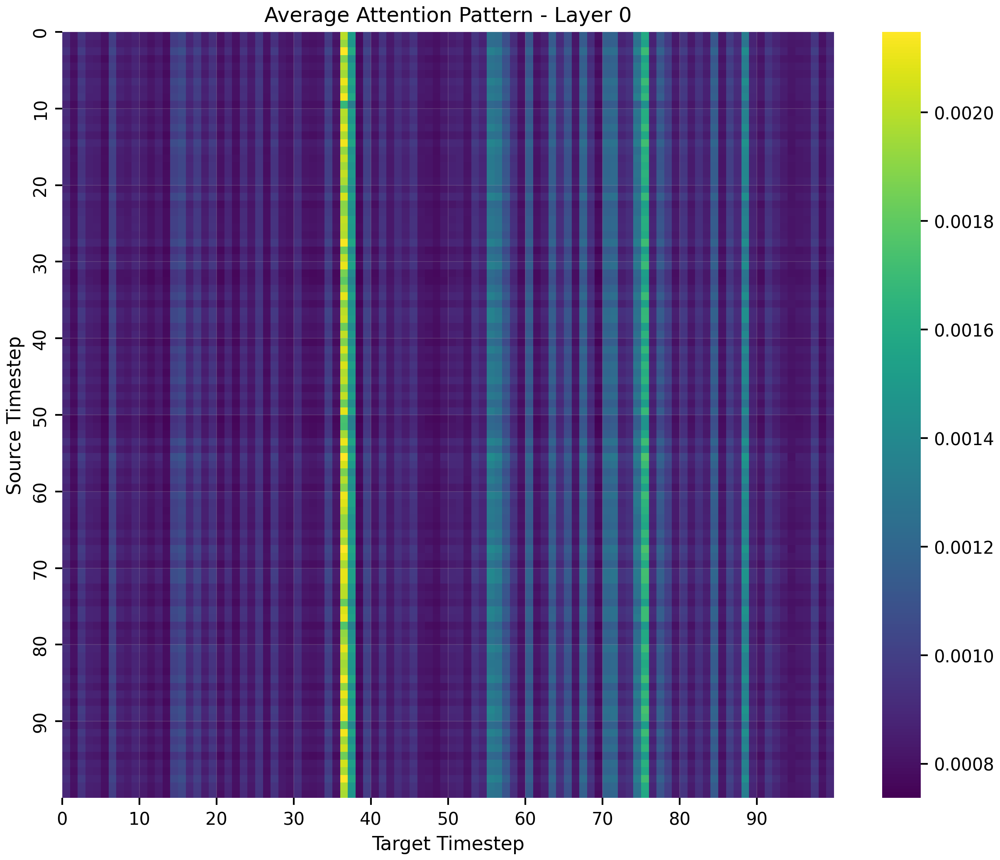

Layer 1
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


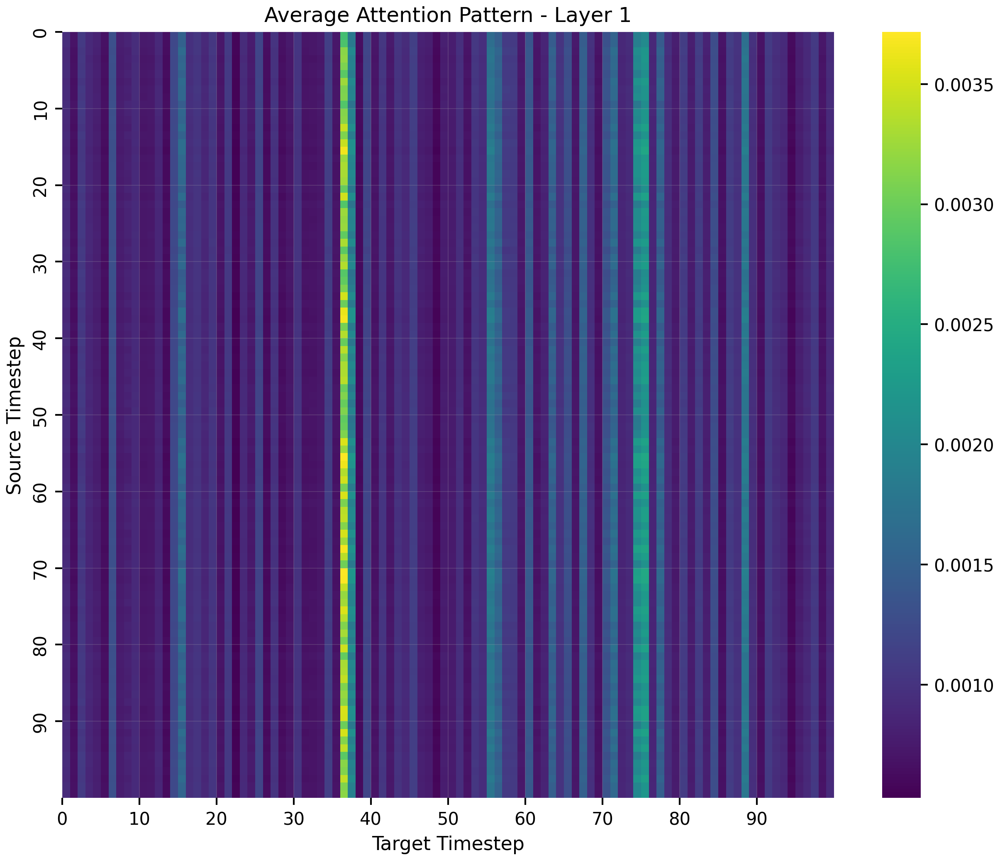

Layer 2
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


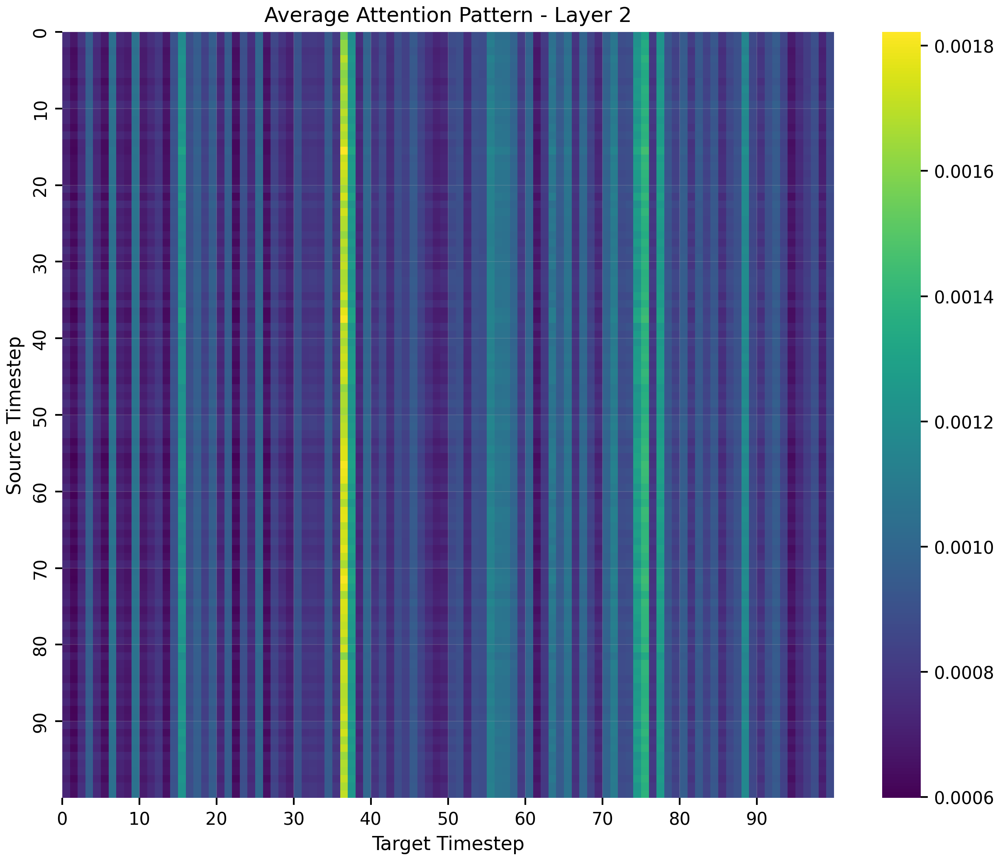

Layer 3
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


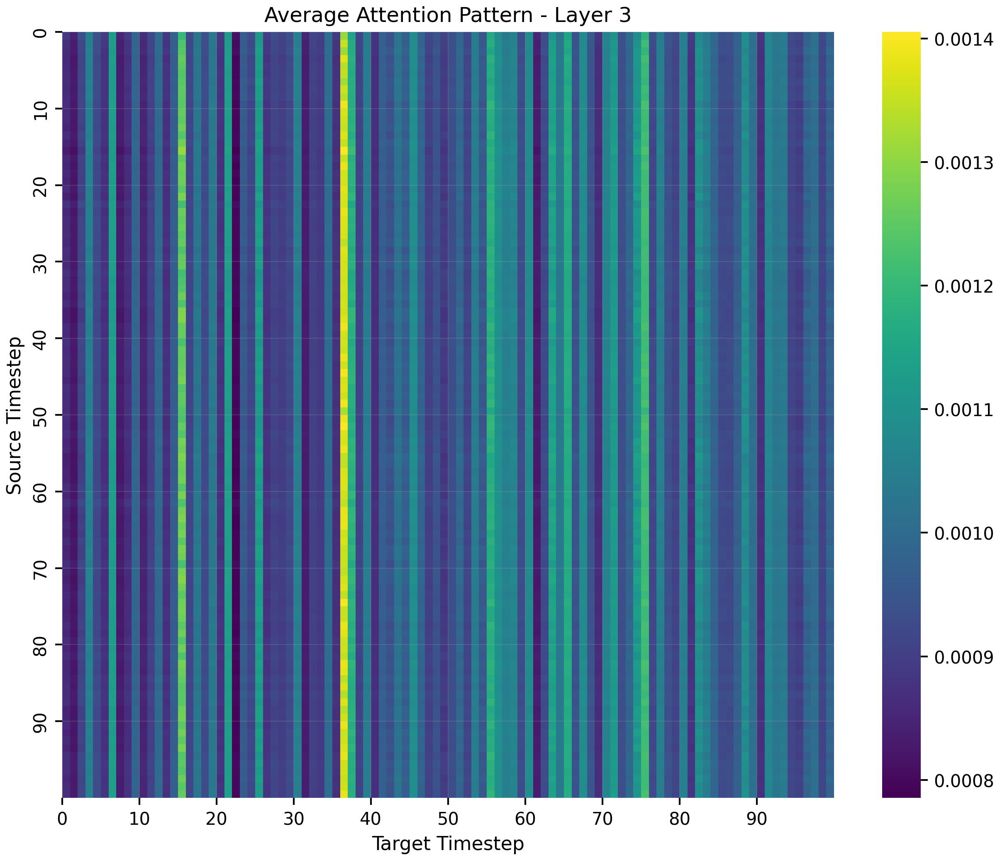

Layer 4
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


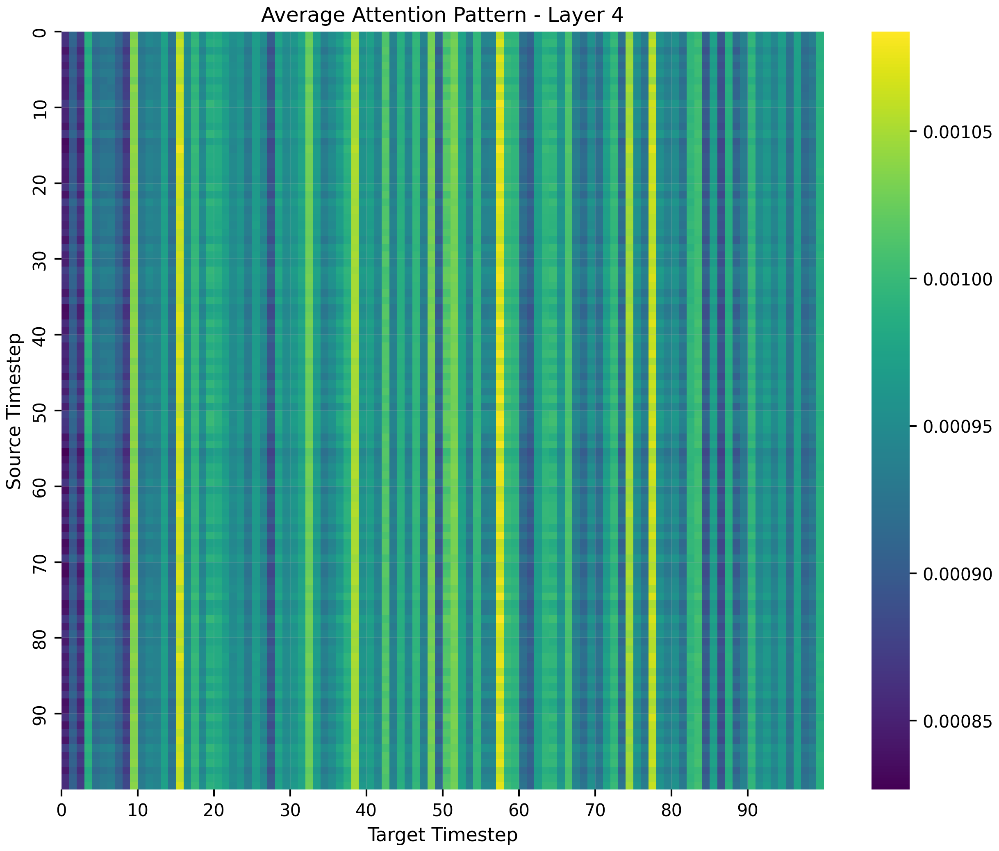

Layer 5
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


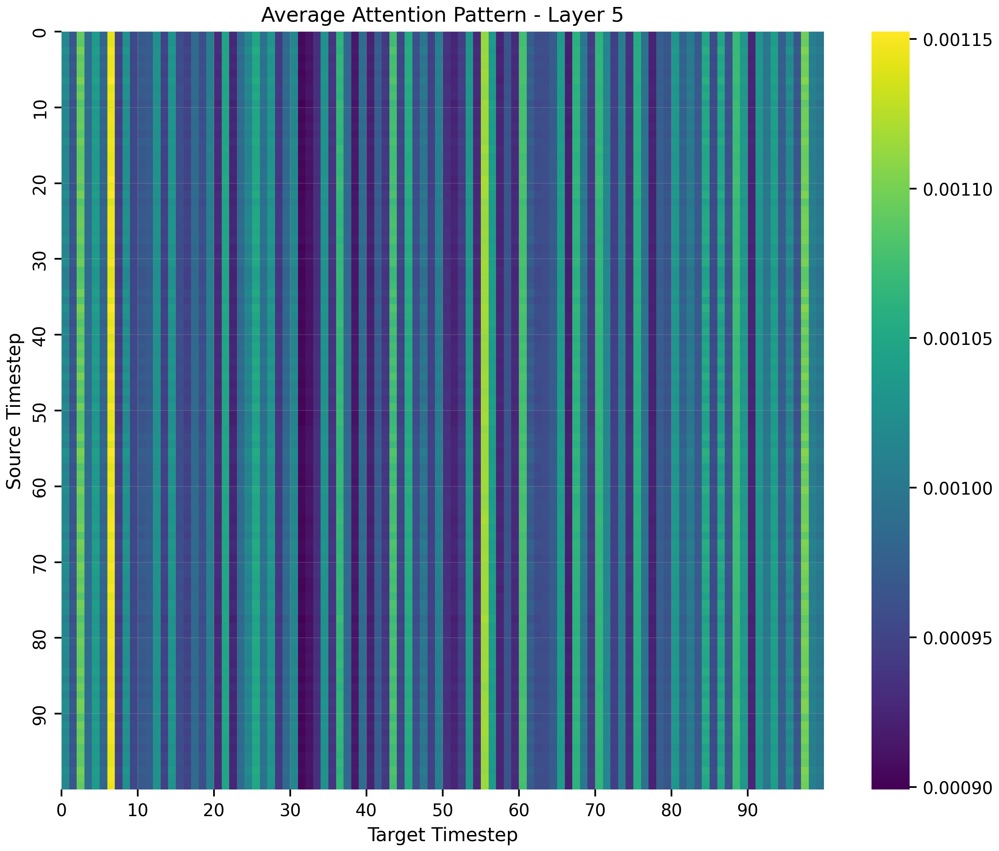

Layer 6
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


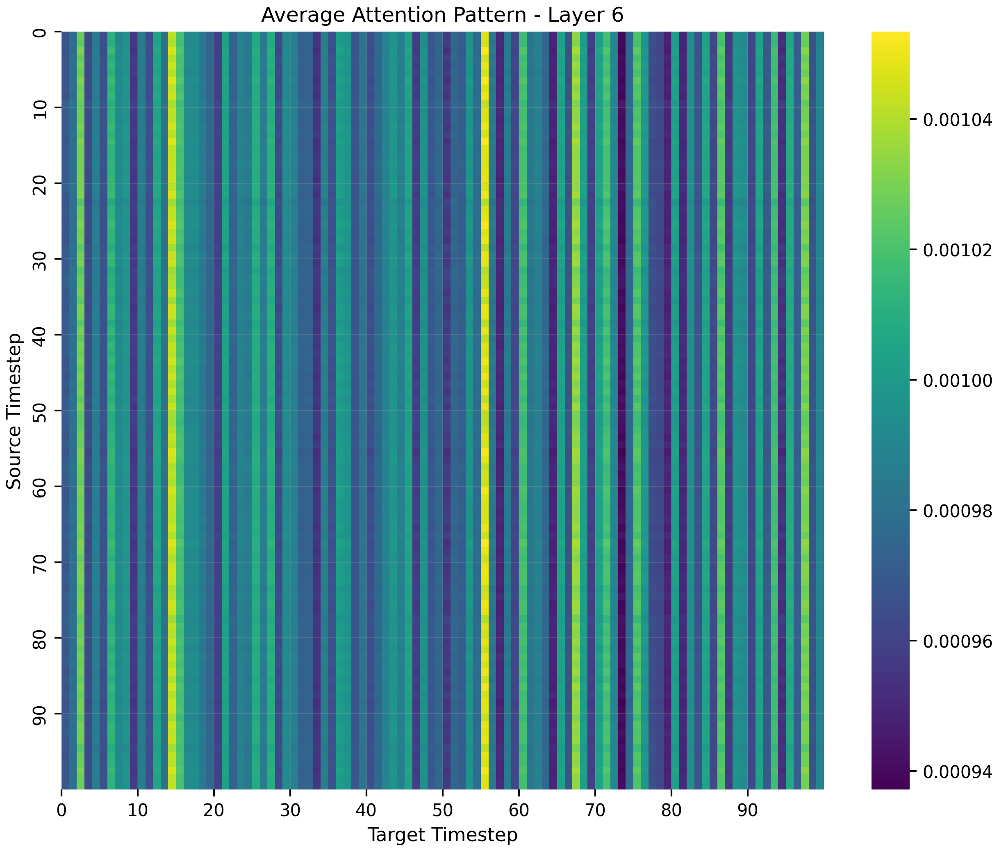

Layer 7
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


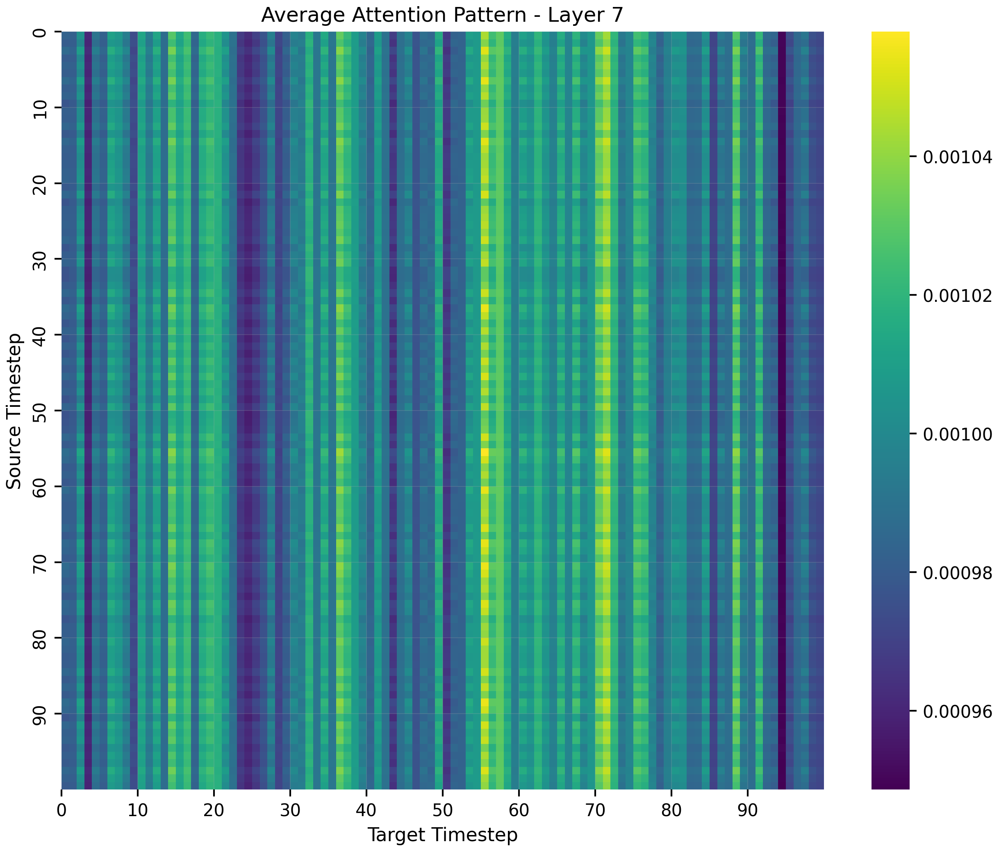

In [286]:
avg_attns = []
for layer in range(model.config.num_hidden_layers):
    print(f"Layer {layer}")
    avg_attns.append(plot_average_attention(model, trajs[0, :, :], window_size=100,
                                            start_idx=0, layer_id=layer))

In [287]:
avg_attn = np.mean(avg_attns, axis=0)

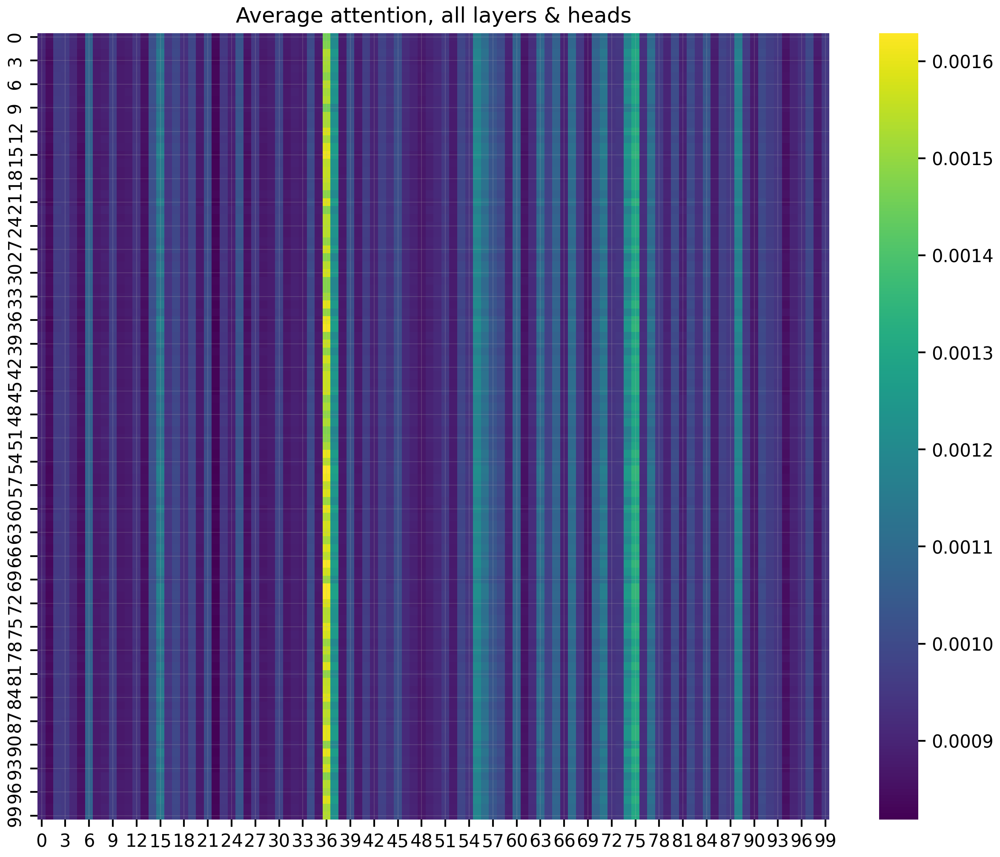

In [288]:
plt.figure(figsize=(10, 8))
sns.heatmap(avg_attn, cmap='viridis')
plt.title(f'Average attention, all layers & heads')
plt.show()

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]


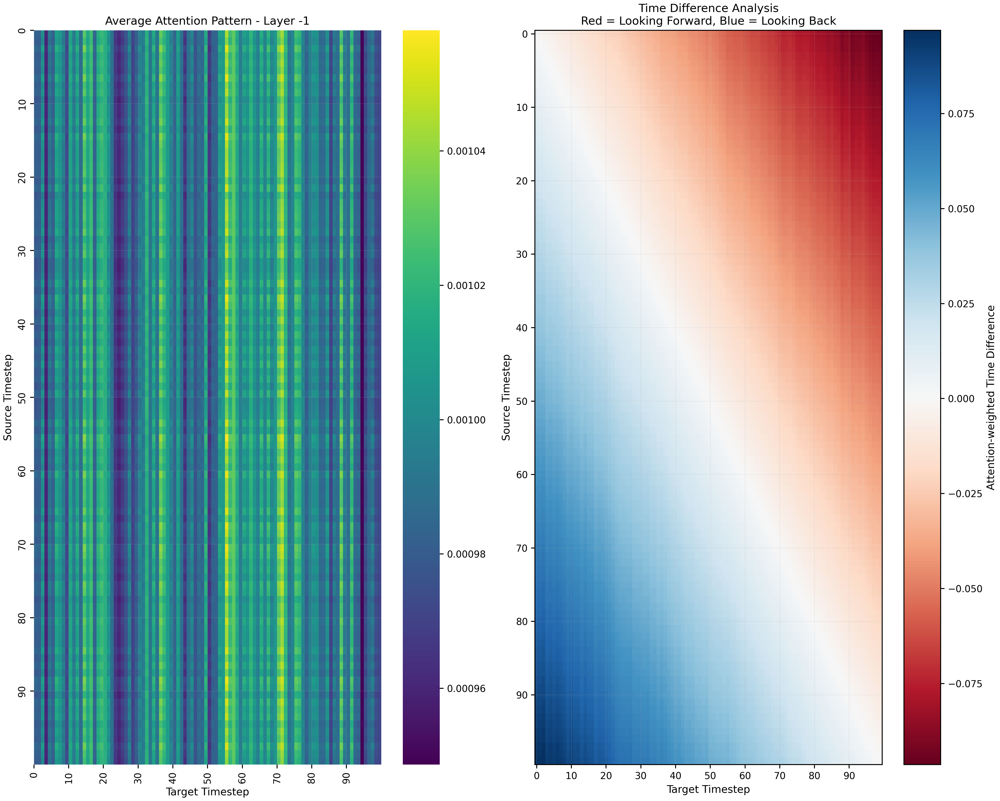

In [218]:
# Look at a single section with time differences
plot_attention_with_time_diff(
    model, 
    trajs[0, :, :],
    window_size=100,
    start_idx=0,
    layer_id=-1
)

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000]), torch.Size([1, 16, 1000, 1000])]

Attention Pattern Statistics Across Trajectory:

Time Difference Stats:

Section 0 (timesteps 0-50):
  Mean absolute time difference: 0.015
  Std of time differences: 0.019
  Max looking backward: -0.073
  Max looking forward: 0.045

Section 1 (timesteps 316-366):
  Mean absolute time difference: 0.015
  Std of time differences: 0.019
  Max looking backward: -0.078
  Max looking forward: 0.051

Section 2 (timesteps 633-683):
  Mean absolute time difference: 0.016
  Std of time differences: 0.020
  Max looking backward: -0.063
  Max looking forward: 0.053

Section 3 (timesteps 950-1000):
  Mean absolute time difference: 

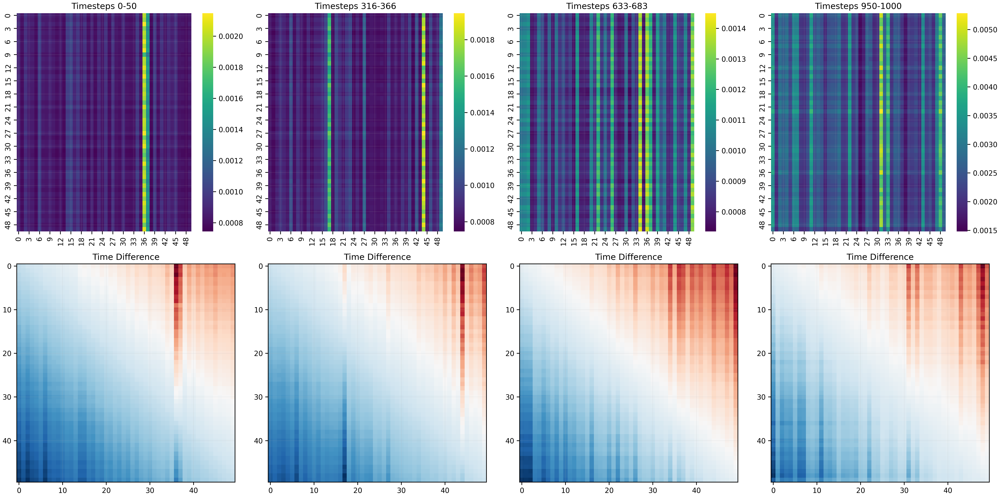

In [219]:
# Compare patterns across the trajectory
analyze_attention_across_trajectory(
    model,
    trajs[0, :, :],
    n_sections=4,
    window_size=50,
    layer_id=0
)

# Large model - wild

In [96]:
config = joblib.load("models/MB_wilder_large/config.jblb")

In [97]:
config_dict = config.to_dict()

In [98]:
config_dict.update({
    "output_attentions": True,
    "return_dict": True,  # Note: use 'return_dict' instead of 'use_return_dict'
    "output_hidden_states": True
})

In [99]:
config = BertConfig(**config_dict)

In [100]:
model = modelling.MDTrajectoryTransformer(config=config,  # NOTE: the space dimension
                                          n_features=2,
                                          n_states=2,
)

In [101]:
checkpoint_path = "models/MB_wilder_large/last.ckpt/checkpoint/mp_rank_00_model_states.pt"

# Load the model with fixed prefixes
model = fix_prefix_and_load_model(checkpoint_path, model)

Checkpoint loaded successfully with fixed prefixes!


In [102]:
model = model.to("cuda")

In [55]:
losses = joblib.load("models/MB_wilder_large/training_losses.jblb")

In [56]:
losses = pd.Series(losses)

<Axes: >

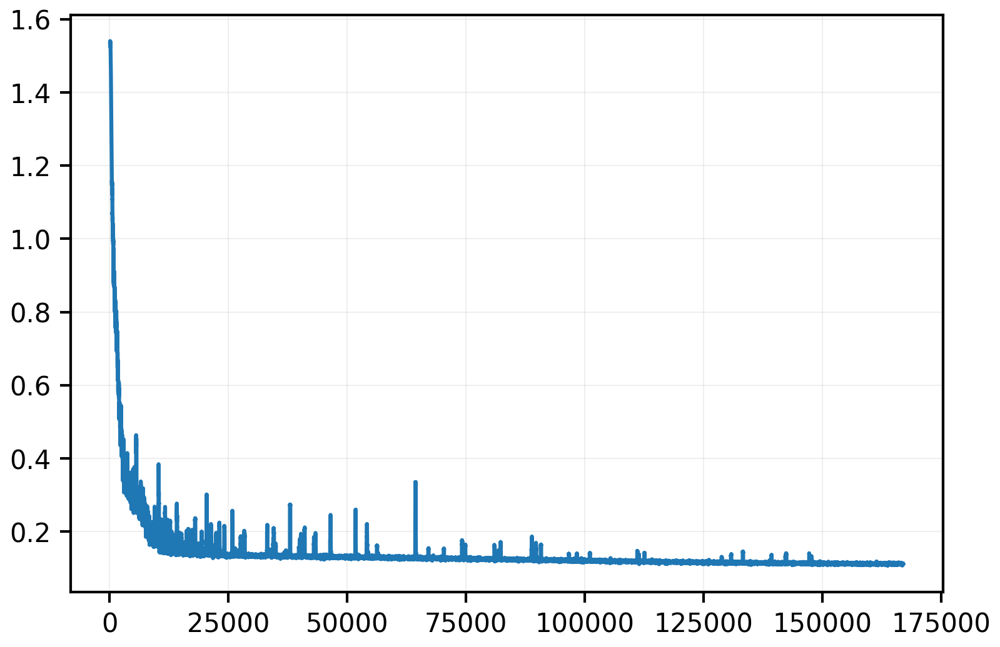

In [57]:
losses.rolling(window=100).mean().plot()
# plt.ylim((0, max(losses)));

## Trajectory

In [248]:
predicted = model.predict_trajectory(
    torch.tensor(trajectories[50]).unsqueeze(0).to("cuda"),
    n_steps=100,
    stride=25
).squeeze().to("cpu")

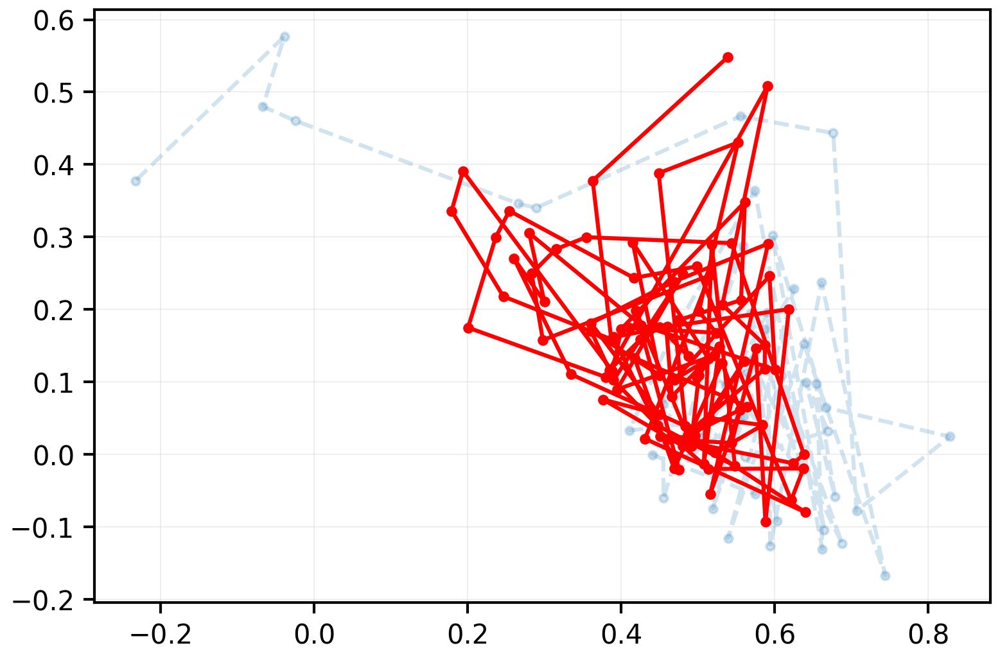

In [249]:
plt.plot(torch.tensor(trajectories[5])[950:, 0], torch.tensor(trajectories[5])[950:, 1], ls="--", marker=".", alpha=0.2)
plt.plot(predicted[1001:, 0], predicted[1001:, 1], c="r", ls="-", marker=".", alpha=1)

### Generated trajectories

In [250]:
idx = np.random.choice(1000, 1, replace=False)

In [251]:
idx

array([429])

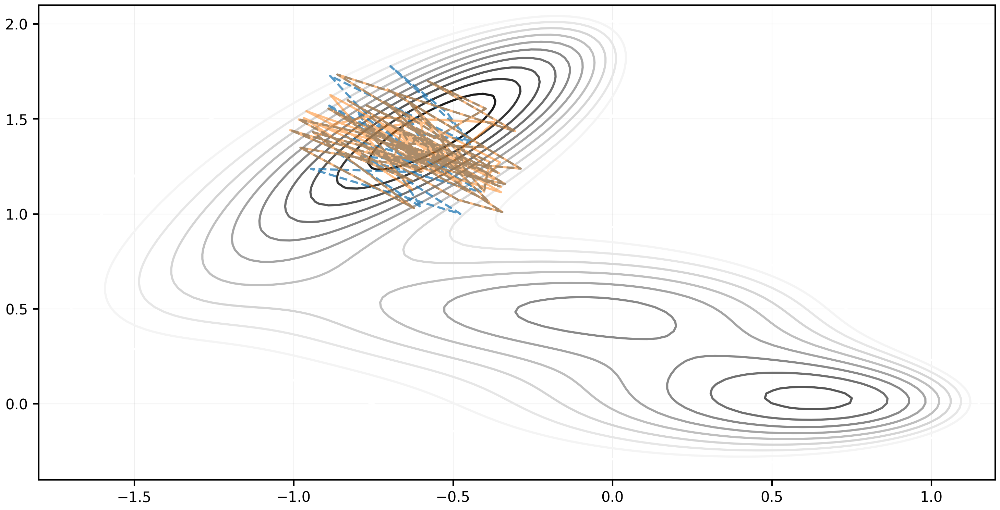

In [252]:
fig, axs = plt.subplots( 1, 1, figsize=(12, 6))
plot_isolines_2D(muller_brown_potential,levels=np.linspace(0,24,12),mode='contour',ax=axs)


init = 50
stop = 75
plt.plot(test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 0],
         test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 1],
         ls="--", 
         alpha=0.75);

predicted = model.predict_trajectory(
    test_trajs[idx, :init, :].to("cuda"),
    n_steps=stop - init,
    stride=25
).to("cpu").numpy()

plt.plot(predicted.transpose(1, 0, 2)[:stop, :, 0],
         predicted.transpose(1, 0, 2)[:stop, :, 1],
         alpha=0.5);

In [253]:
idx = np.random.choice(500, 1, replace=False)

In [254]:
idx

array([336])

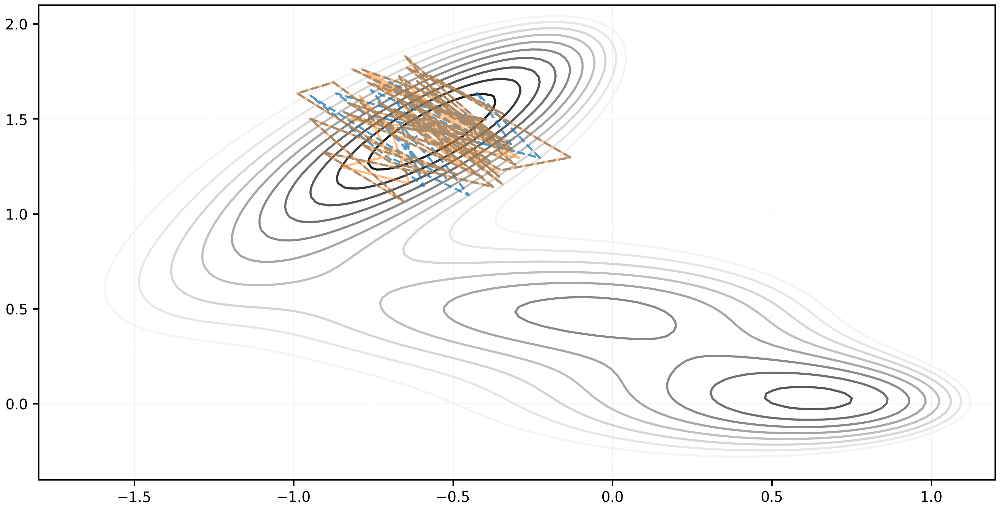

In [255]:
fig, axs = plt.subplots( 1, 1, figsize=(12, 6))
plot_isolines_2D(muller_brown_potential,levels=np.linspace(0,24,12),mode='contour',ax=axs)


init = 50
stop = 75
plt.plot(test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 0],
         test_trajs.numpy()[idx].transpose(1, 0, 2)[:stop, :, 1],
         ls="--", 
         alpha=0.75);

predicted = model.predict_trajectory(
    test_trajs[idx, :init, :].to("cuda"),
    n_steps=stop - init,
    stride=25
).to("cpu").numpy()

plt.plot(predicted.transpose(1, 0, 2)[:stop, :, 0],
         predicted.transpose(1, 0, 2)[:stop, :, 1],
         alpha=0.5);

### Metrics

**stride effects**

In [103]:
stride_metrics = {}

for stride in np.linspace(1, 60, 10, dtype=int):
# Analyze predictions
    _, _, stride_metrics[stride], _ = analyze_trajectory_prediction(
        model,
        test_trajs[:100, :, :],
        initial_sequence_length=500,
        prediction_length=100,
        stride=stride
    )

In [104]:
stride_metrics

{1: {'mse': 0.3567166527218375,
  'rmse': 0.5164815453003172,
  'mae': 0.4058110344154202,
  'relative_error': 1.1851914130416539},
 7: {'mse': 0.13275501057468655,
  'rmse': 0.3188211334993392,
  'mae': 0.2649513710603006,
  'relative_error': 0.662218105793793},
 14: {'mse': 0.11448919055969436,
  'rmse': 0.29730589499703564,
  'mae': 0.2477514326633403,
  'relative_error': 0.6041330908035956},
 20: {'mse': 0.11581105723100206,
  'rmse': 0.2987096804735503,
  'mae': 0.24884831434379595,
  'relative_error': 0.6066206981685003},
 27: {'mse': 0.11654010714997125,
  'rmse': 0.29722593944392434,
  'mae': 0.24911774465395034,
  'relative_error': 0.6073111147994479},
 33: {'mse': 0.11795518048911133,
  'rmse': 0.2988875940110867,
  'mae': 0.24972045057909165,
  'relative_error': 0.6106478809961428},
 40: {'mse': 0.12053950795047651,
  'rmse': 0.30173395670068226,
  'mae': 0.252361534853233,
  'relative_error': 0.6167727367546672},
 46: {'mse': 0.12039426721527129,
  'rmse': 0.300619405375140

In [105]:
min_stride = min(stride_metrics.keys(), key=lambda k: stride_metrics[k]['mse'])
min_stride

14

In [ ]:
# Analyze predictions
actual, predicted, avg_metrics, per_traj_metrics = analyze_trajectory_prediction(
    model,
    test_trajs[:100, :, :],
    initial_sequence_length=500,
    prediction_length=100,
    stride=1
)

# Print metrics
print("\nPrediction Metrics:")
for name, value in avg_metrics.items():
    print(f"{name}: {value:.4f}")

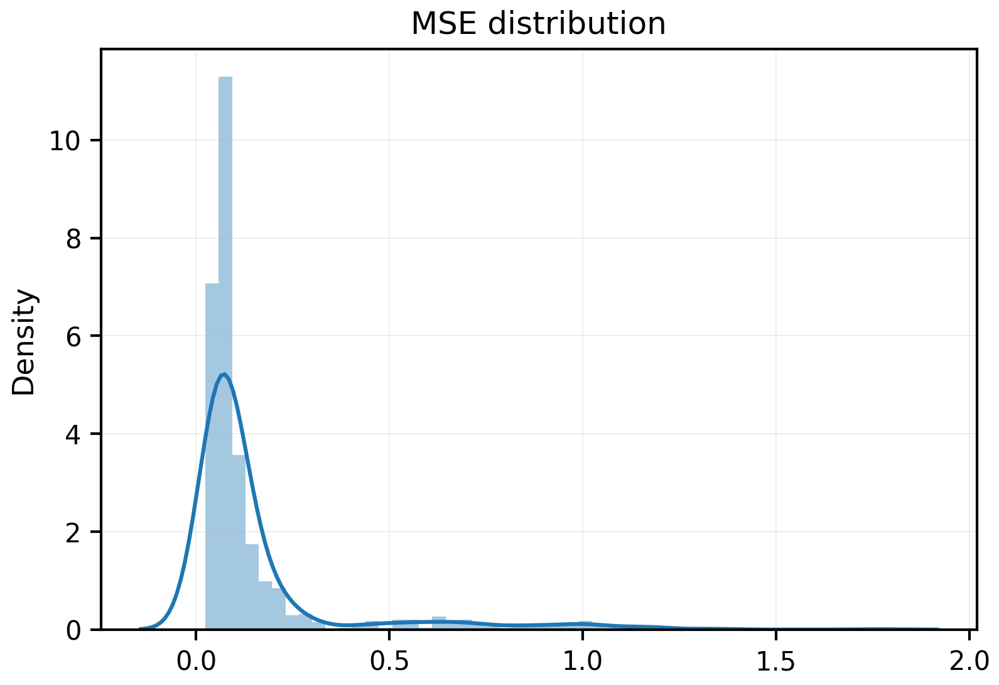

In [257]:
sns.distplot(per_traj_metrics["mse"]);
plt.title("MSE distribution");

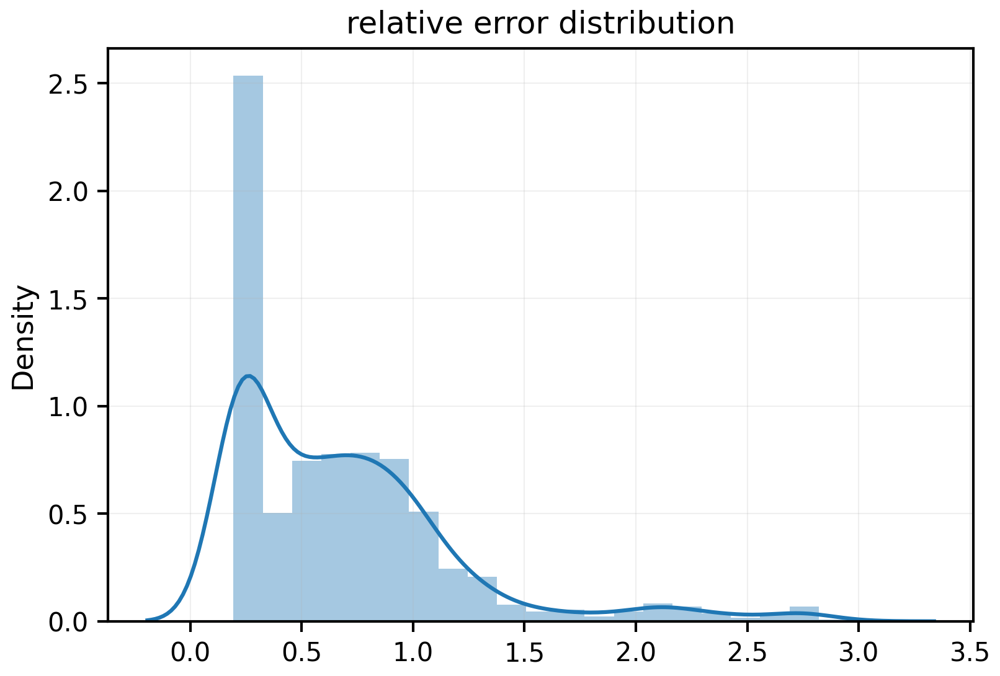

In [258]:
sns.distplot(per_traj_metrics["relative_error"]);
plt.title("relative error distribution");

## State

In [296]:
predictions  = model.classify_state(test_trajs.to("cuda"))

In [297]:
accuracy = accuracy_score(predictions["predictions"].cpu(), test_states)
precision = precision_score(predictions["predictions"].cpu(),  test_states, average='weighted')
recall = recall_score(predictions["predictions"].cpu(),  test_states, average='weighted')
f1 = f1_score(predictions["predictions"].cpu(),  test_states, average='weighted')

# Print the evaluation metrics
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

Accuracy: 0.9860
Precision: 0.9860
Recall: 0.9860
F1 Score: 0.9860


### Partial trajectory

In [298]:
part_predictions  = model.classify_state(test_trajs[:, :500, :].to("cuda"))

In [299]:
accuracy = accuracy_score(part_predictions["predictions"].cpu(), test_states)
precision = precision_score(part_predictions["predictions"].cpu(),  test_states, average='weighted')
recall = recall_score(part_predictions["predictions"].cpu(),  test_states, average='weighted')
f1 = f1_score(part_predictions["predictions"].cpu(),  test_states, average='weighted')

# Print the evaluation metrics
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

Accuracy: 0.9820
Precision: 0.9823
Recall: 0.9820
F1 Score: 0.9820


In [300]:
seg_length = 500
mean_acc, acc_by_pos, pred_states = evaluate_segments(test_trajs.to("cuda"), test_states, model, segment_length=seg_length,
                                                      n_segments=1000 // seg_length)
print(f"Mean accuracy: {mean_acc:.3f}")

Mean accuracy: 0.858


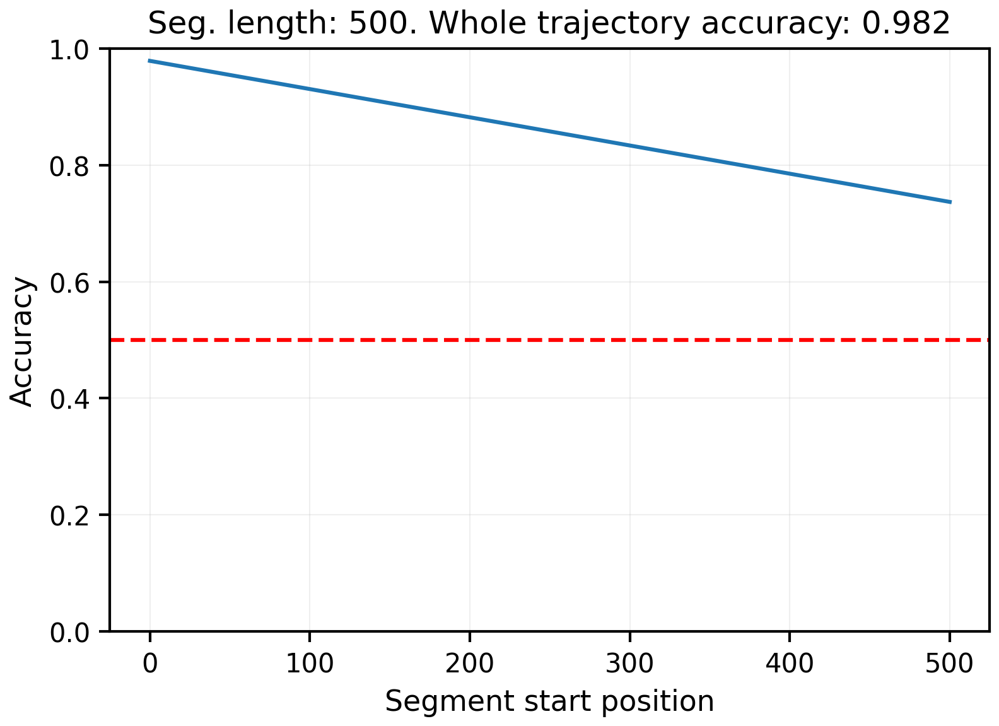

In [301]:
# Plot accuracy vs position
plt.plot(acc_by_pos.keys(), acc_by_pos.values())
plt.xlabel("Segment start position");
plt.ylabel("Accuracy");
plt.ylim((0, 1));
plt.axhline(0.5, c="r", ls="--");
plt.title(f"Seg. length: {seg_length}. Whole trajectory accuracy: {accuracy:.3f}");

In [302]:
seg_length = 250
mean_acc, acc_by_pos, pred_states = evaluate_segments(test_trajs.to("cuda"), test_states, model, segment_length=seg_length,
                                                      n_segments=1000 // seg_length)
print(f"Mean accuracy: {mean_acc:.3f}")

Mean accuracy: 0.765


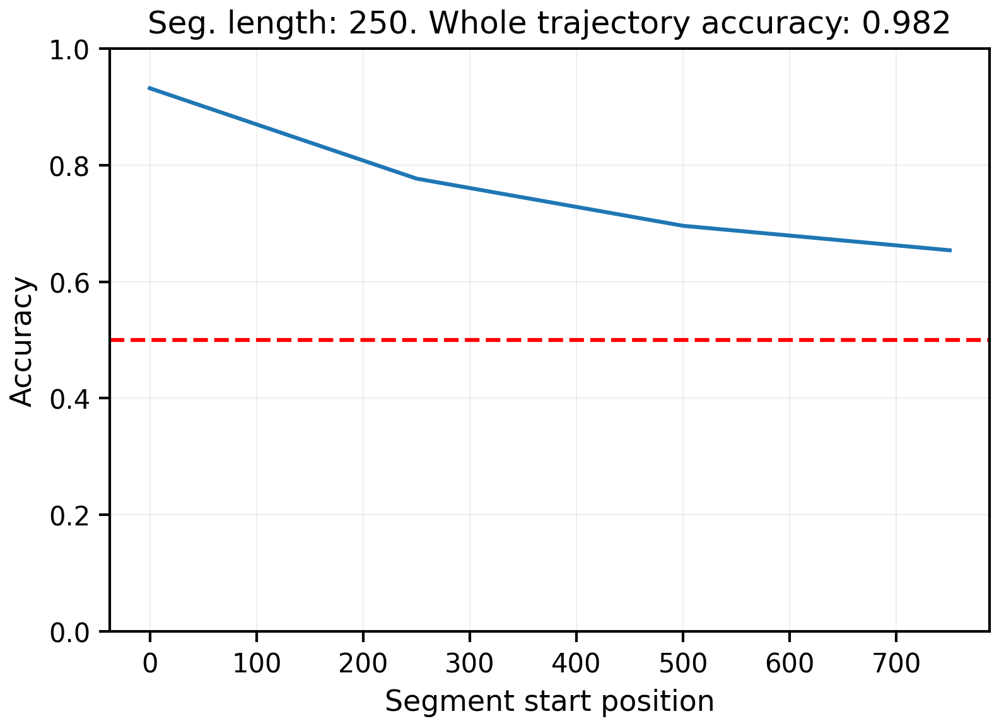

In [303]:
# Plot accuracy vs position
plt.plot(acc_by_pos.keys(), acc_by_pos.values())
plt.xlabel("Segment start position");
plt.ylabel("Accuracy");
plt.ylim((0, 1));
plt.axhline(0.5, c="r", ls="--");
plt.title(f"Seg. length: {seg_length}. Whole trajectory accuracy: {accuracy:.3f}");

In [304]:
seg_length = 100
mean_acc, acc_by_pos, pred_states = evaluate_segments(test_trajs.to("cuda"), test_states, model,
                                                      segment_length=seg_length,
                                                      n_segments=1000 // seg_length)
print(f"Mean accuracy: {mean_acc:.3f}")

Mean accuracy: 0.689


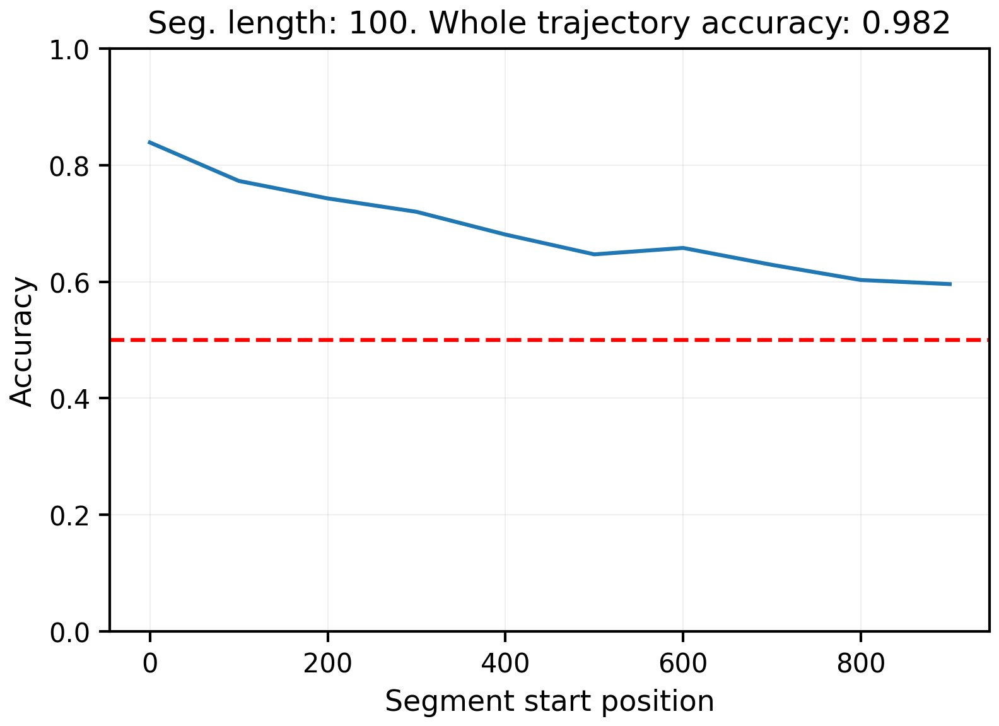

In [305]:
# Plot accuracy vs position
plt.plot(acc_by_pos.keys(), acc_by_pos.values())
plt.xlabel("Segment start position");
plt.ylabel("Accuracy");
plt.ylim((0, 1));
plt.axhline(0.5, c="r", ls="--");
plt.title(f"Seg. length: {seg_length}. Whole trajectory accuracy: {accuracy:.3f}");

## Embeddings

In [306]:
# More detailed analysis
attention_data = get_attention_maps(model, trajs[0, :, :], return_hiddens=True)

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


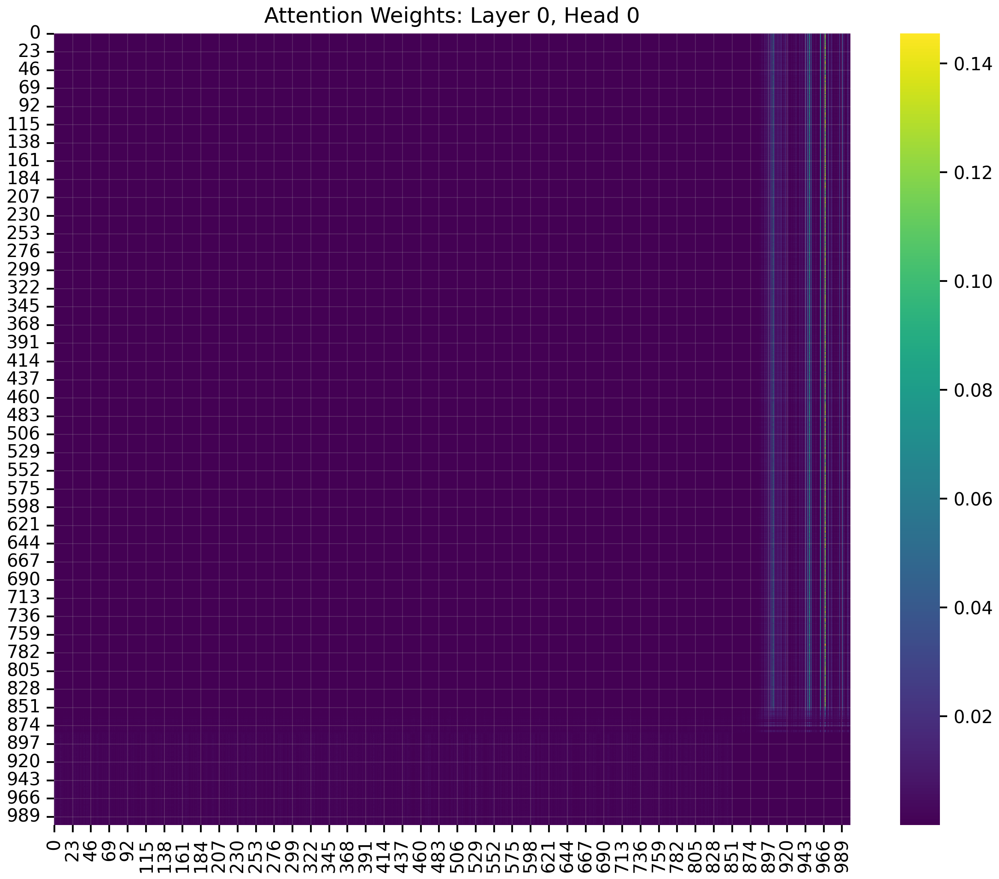

In [307]:
# Examine specific layer and head
layer_idx = 0  # First layer
head_idx = 0   # First attention head
attention_weights = attention_data['all_head_outputs']['attn'][layer_idx][0, head_idx]

# Can also create custom visualizations with the attention weights
import seaborn as sns
plt.figure(figsize=(10, 8))
sns.heatmap(attention_weights, cmap='viridis')
plt.title(f'Attention Weights: Layer {layer_idx}, Head {head_idx}')
plt.show()

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


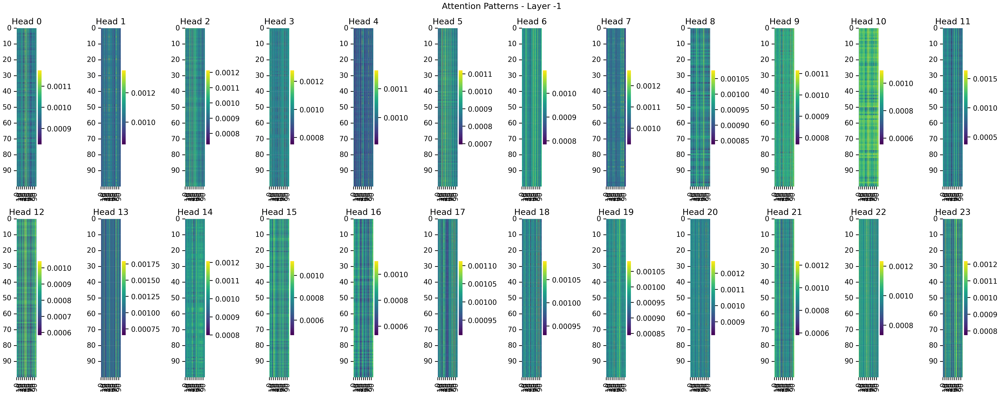

In [308]:
# View all attention heads for a section
visualize_attention(model, trajs[0, :, :], window_size=100, start_idx=0, layer_id=-1);

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


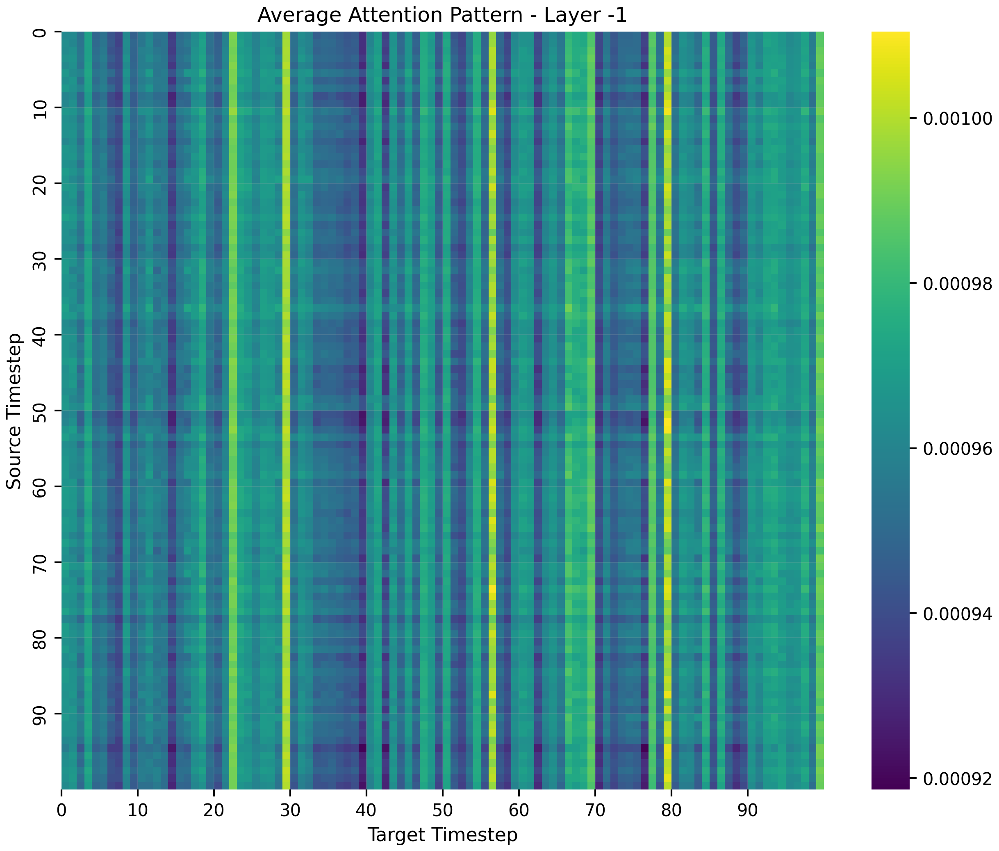

In [309]:
# View average attention pattern
plot_average_attention(model, trajs[0, :, :], window_size=100, start_idx=0, layer_id=-1);

Layer 0
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


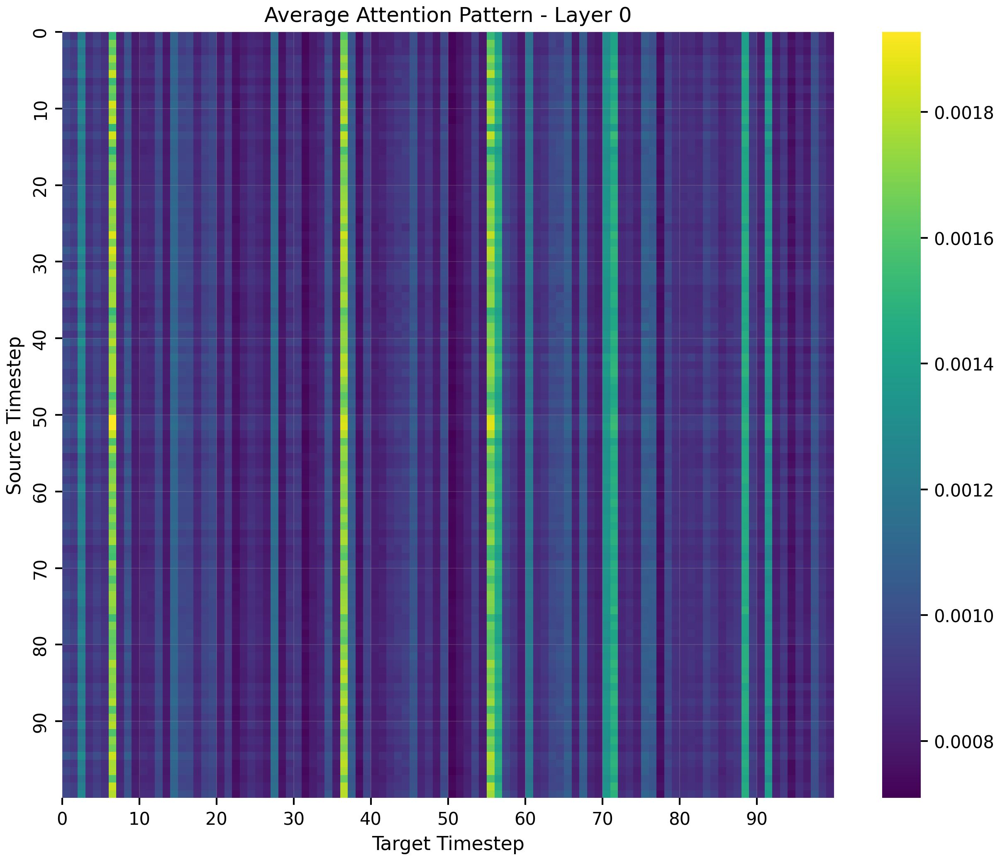

Layer 1
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


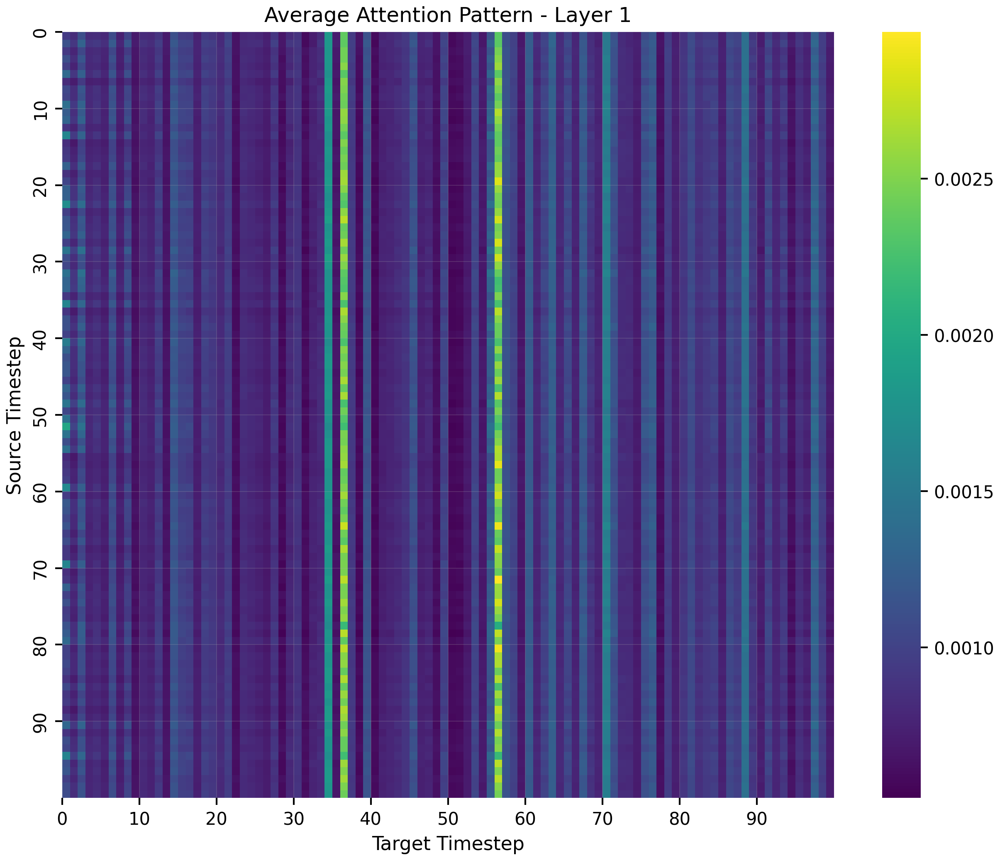

Layer 2
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


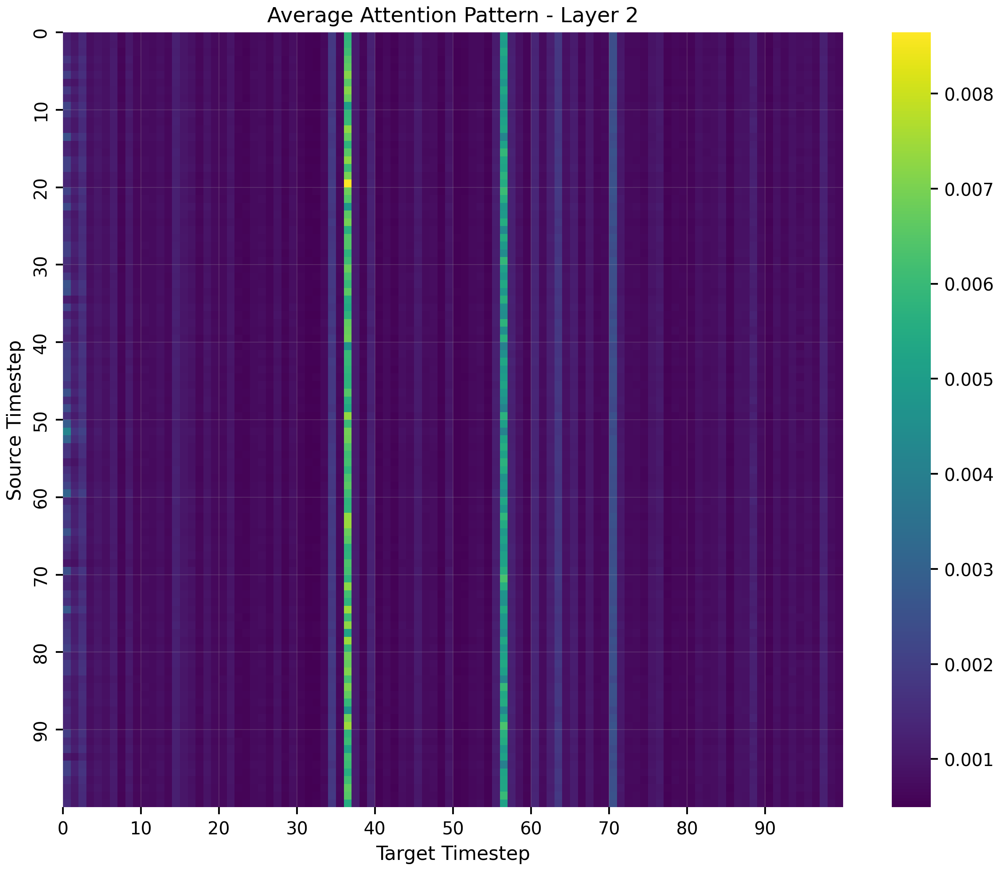

Layer 3
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


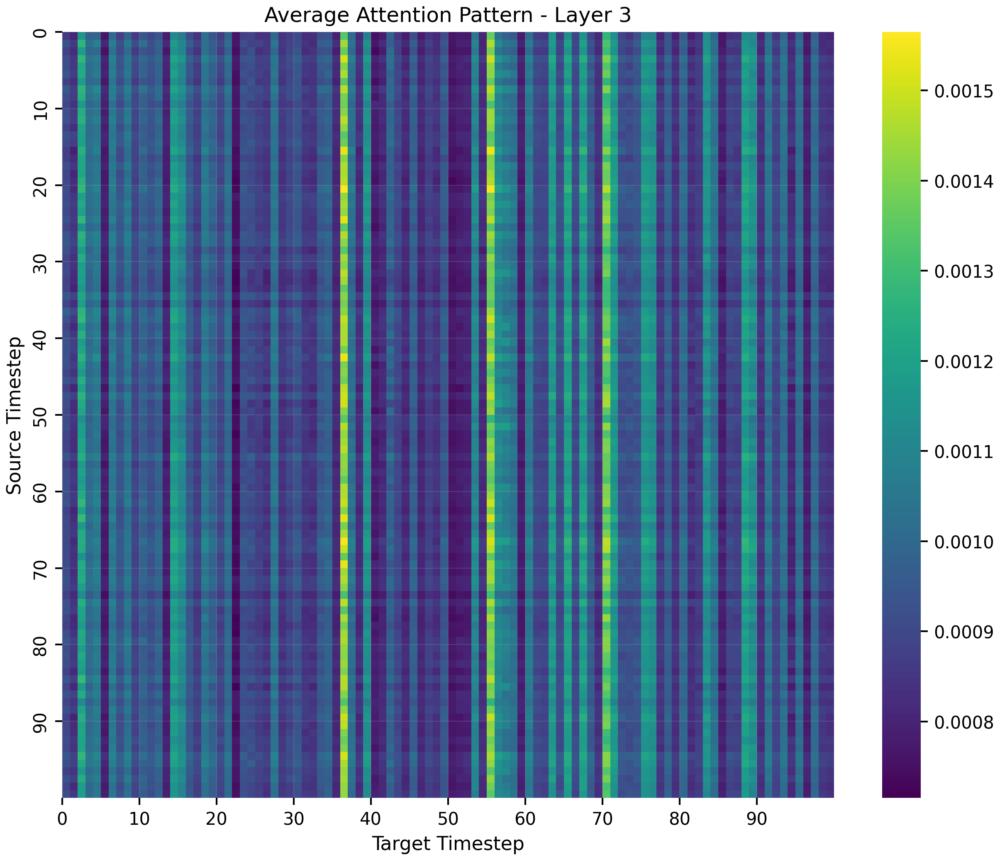

Layer 4
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


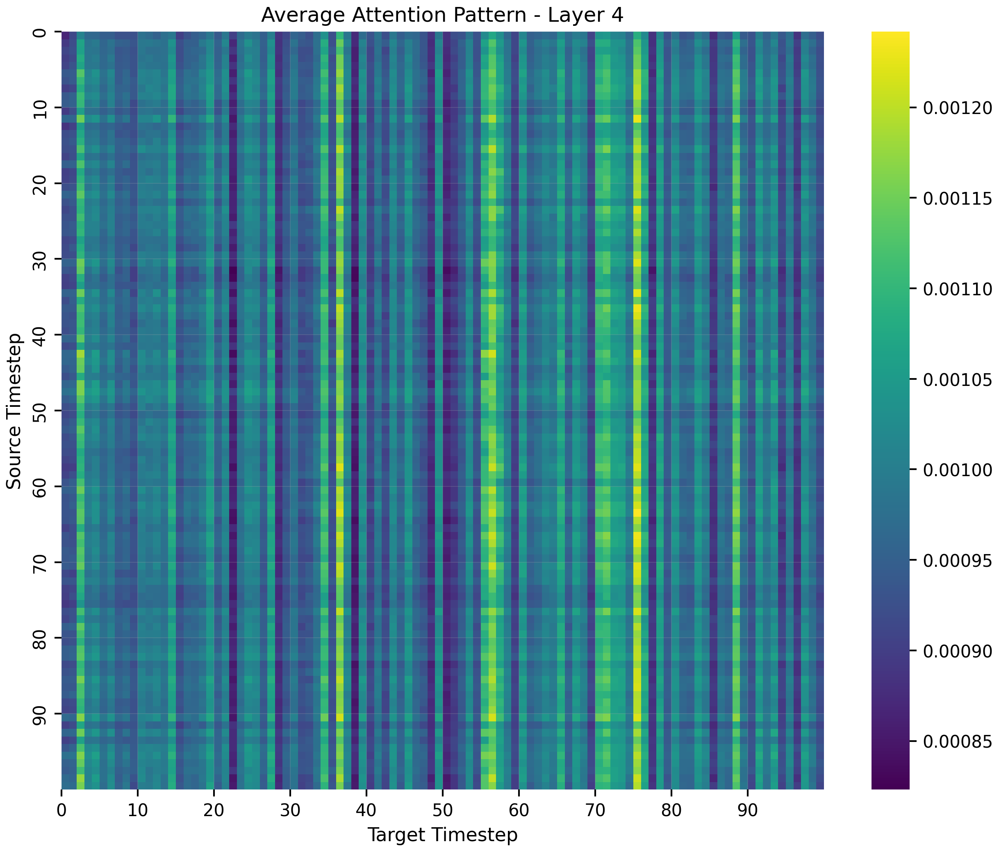

Layer 5
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


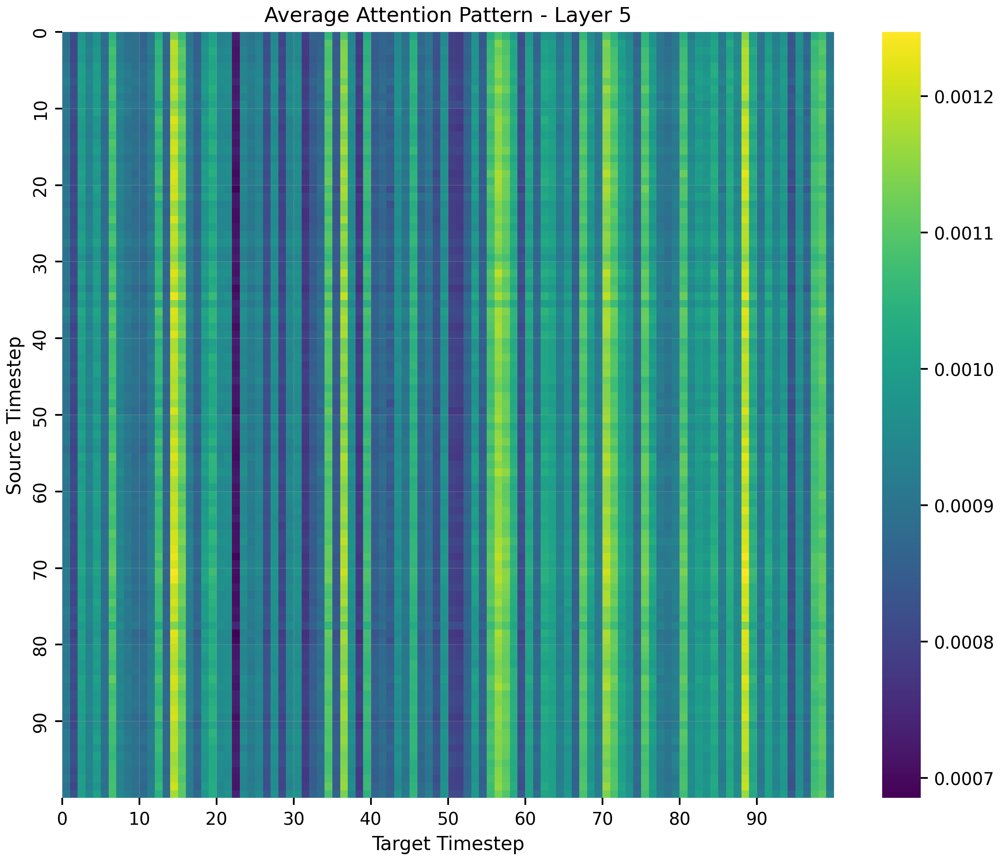

Layer 6
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


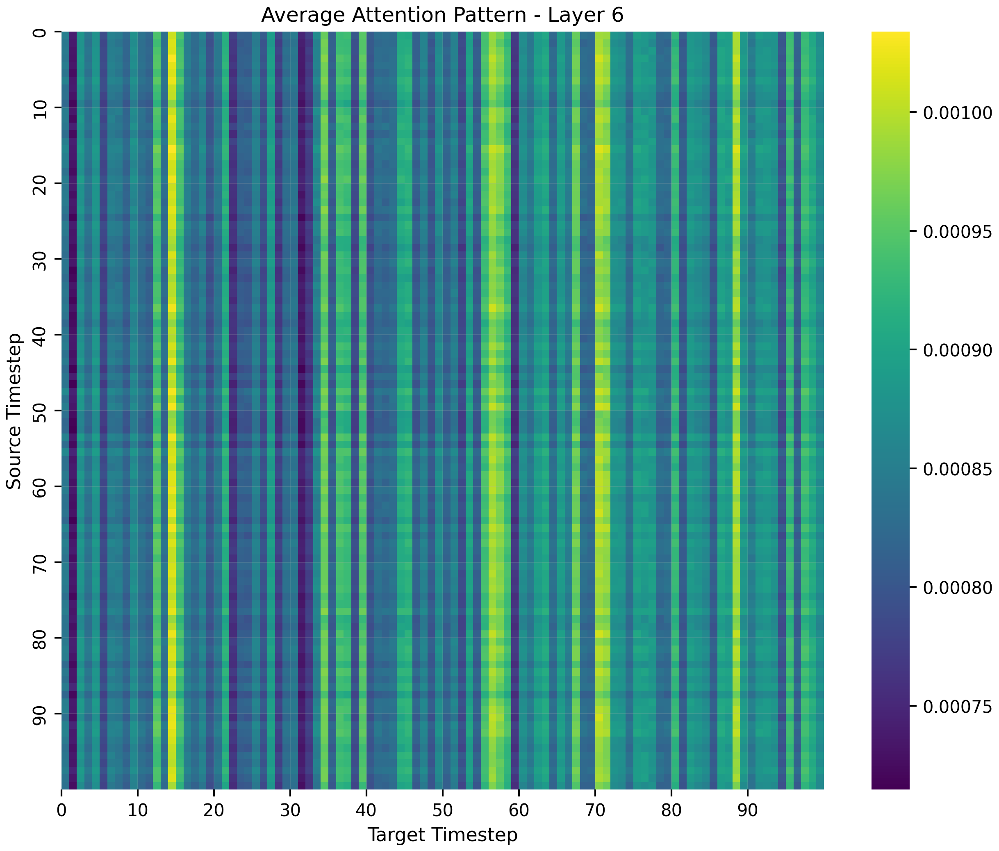

Layer 7
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


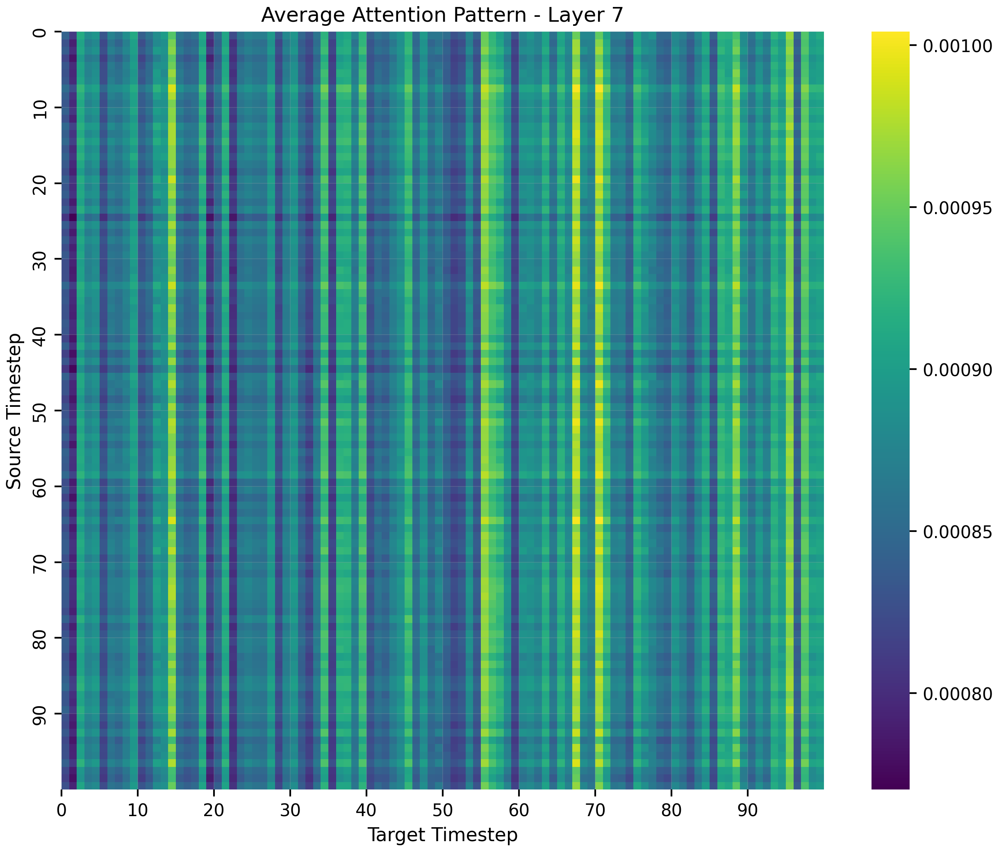

Layer 8
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


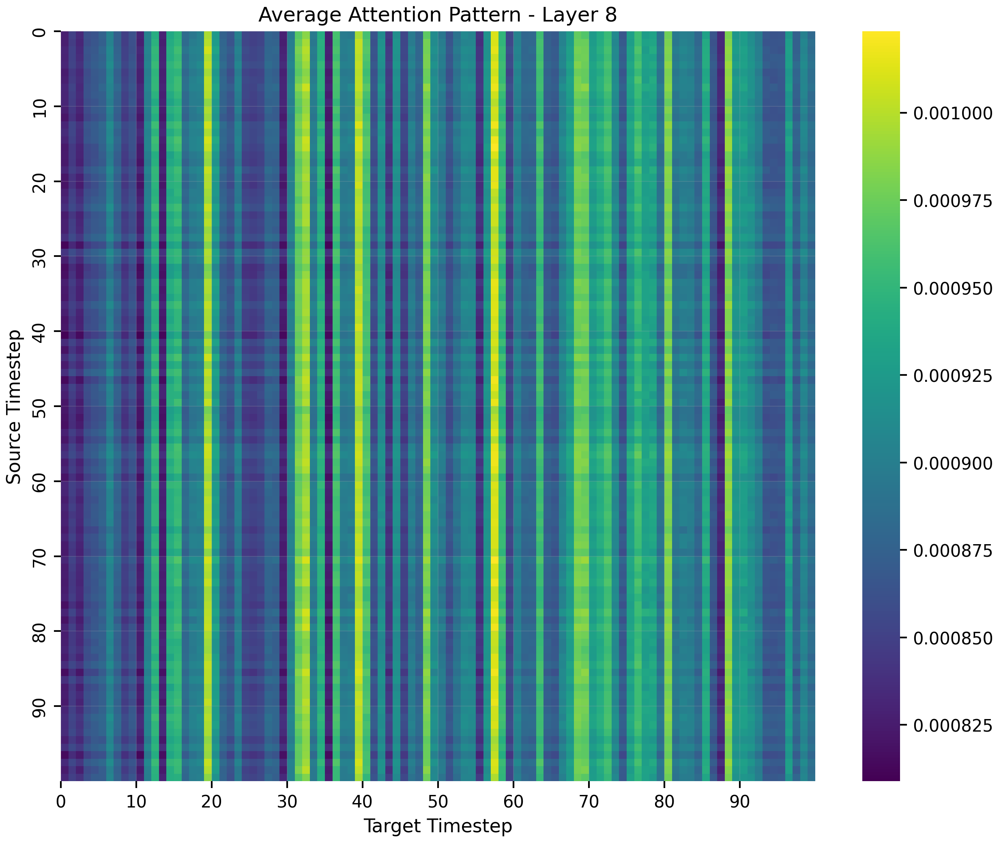

Layer 9
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


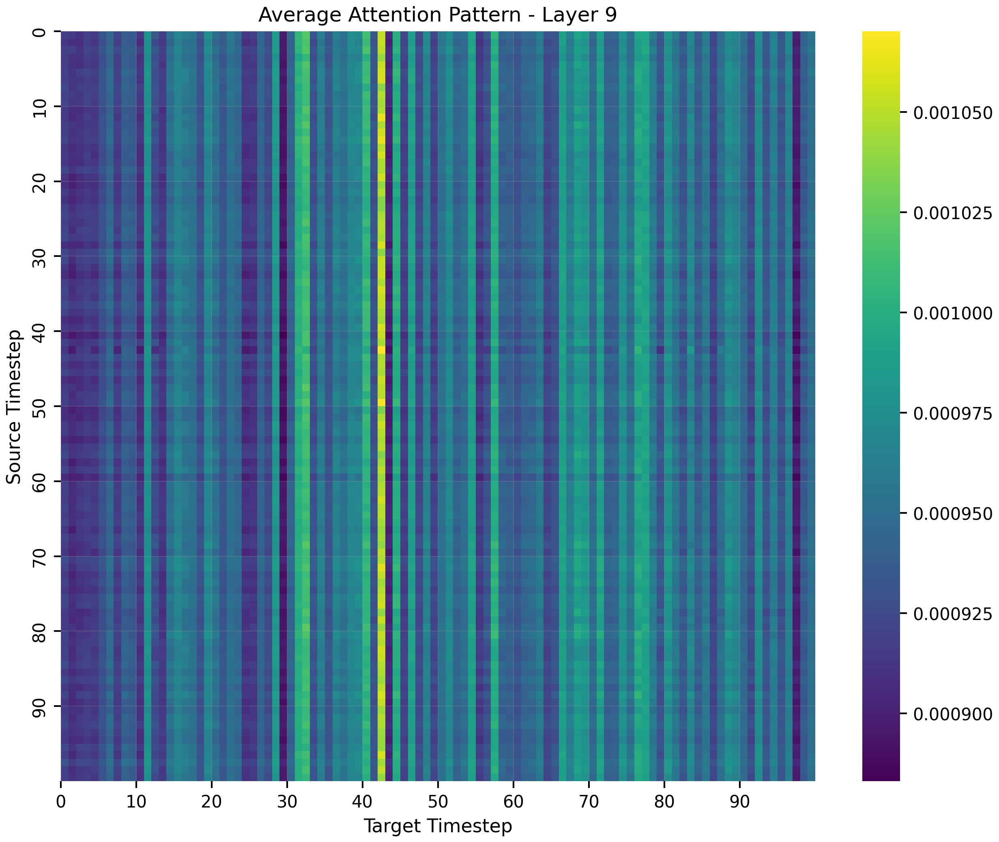

Layer 10
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


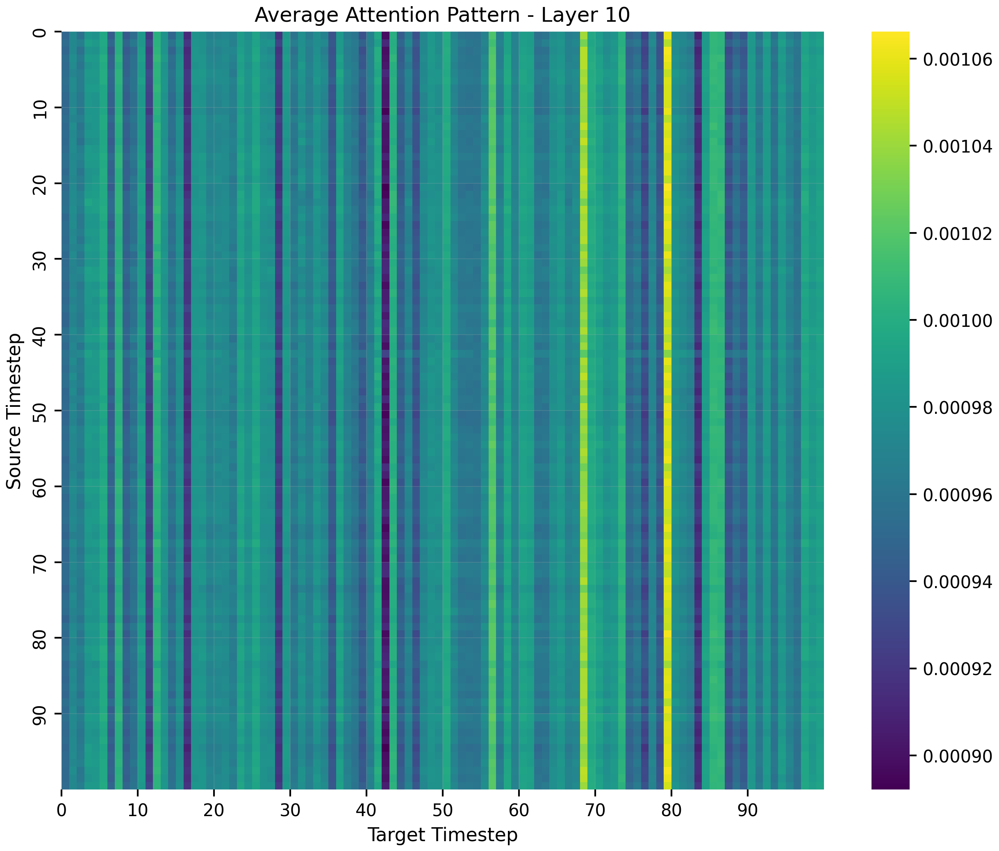

Layer 11
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


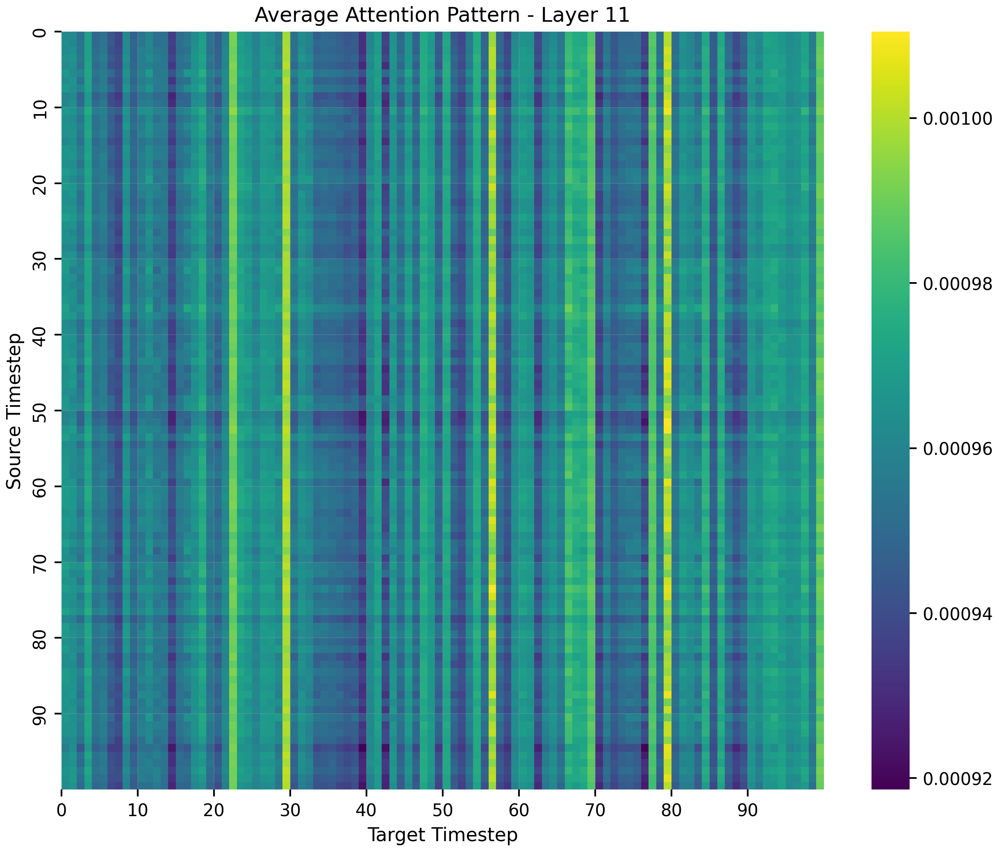

In [310]:
# Look at different layers
for layer in range(model.config.num_hidden_layers):  # Assuming 4 layers
    print(f"Layer {layer}")
    plot_average_attention(model, trajs[0, :, :], window_size=100, start_idx=0, layer_id=layer)

all layers, all heads



Layer 0
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


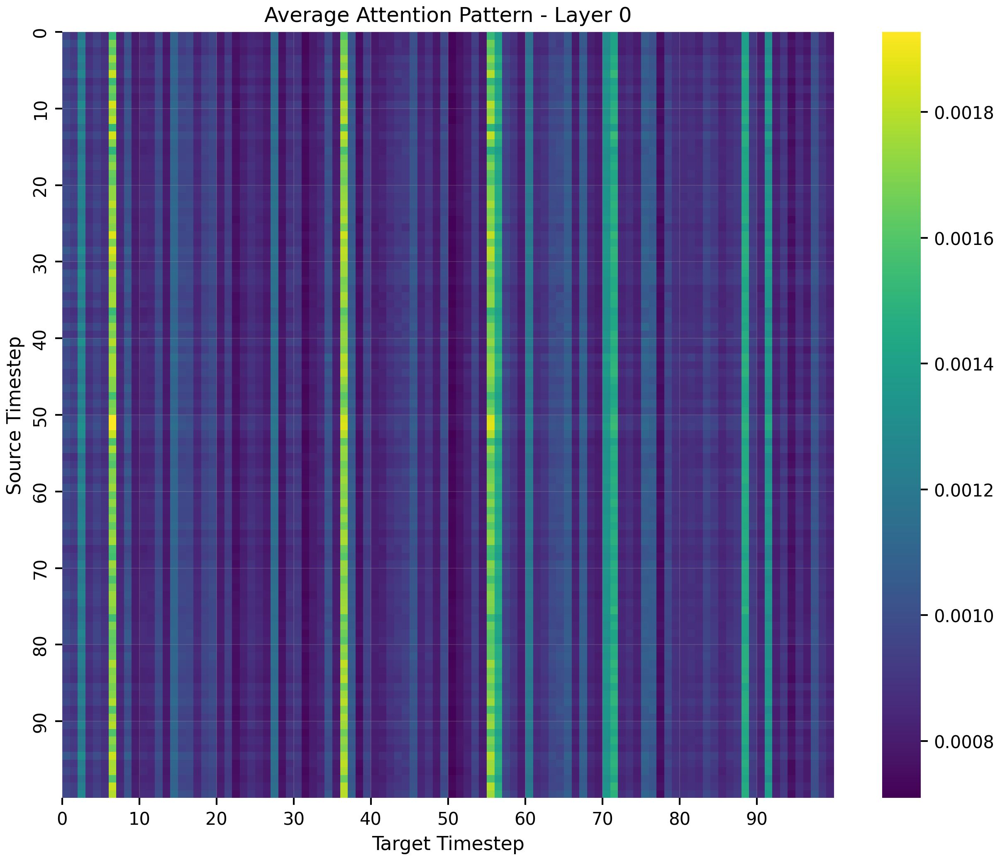

Layer 1
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


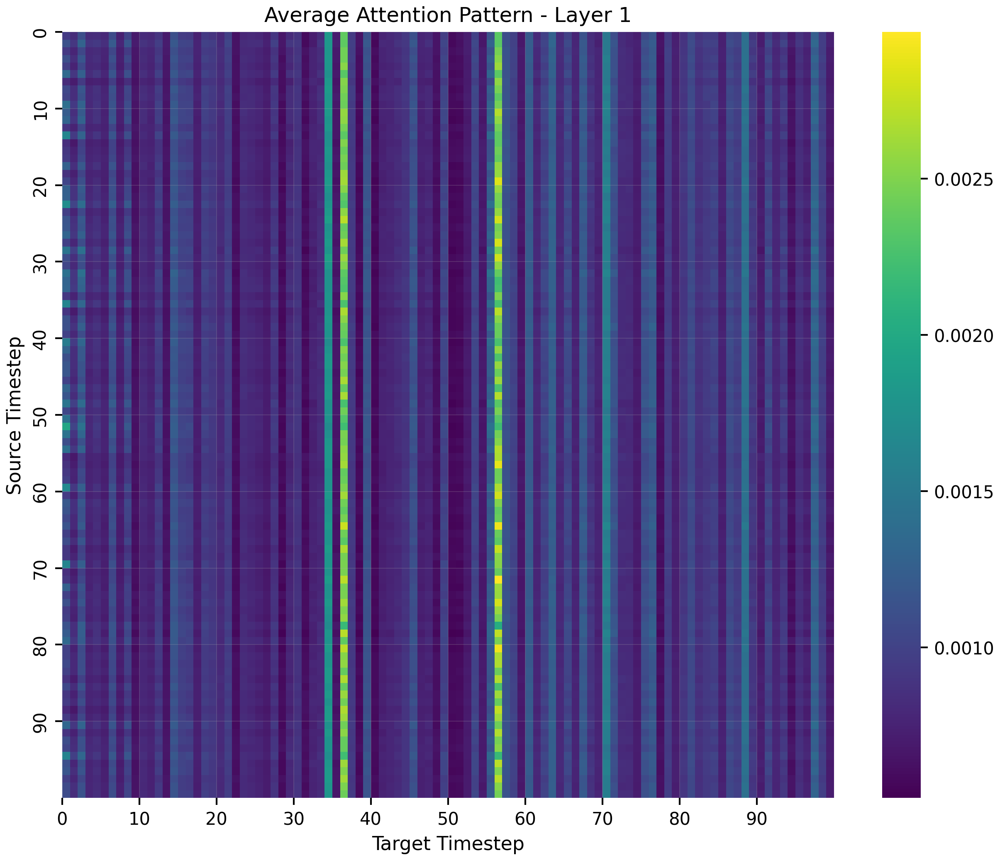

Layer 2
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


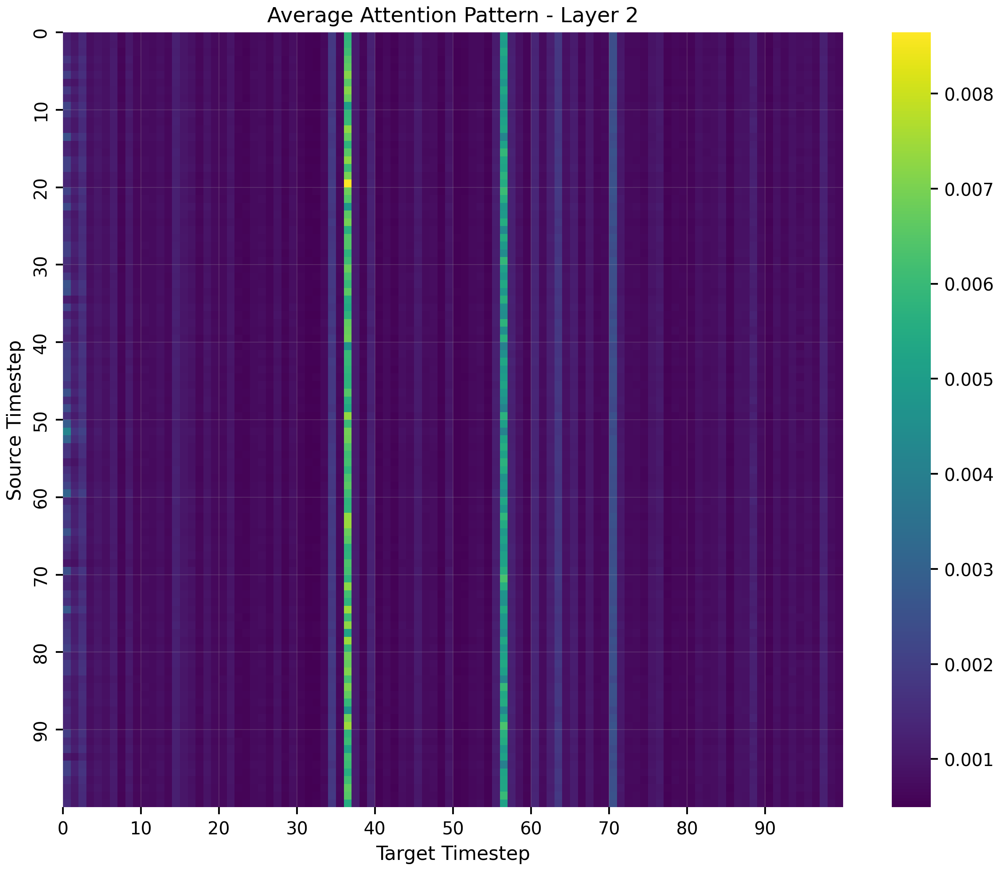

Layer 3
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


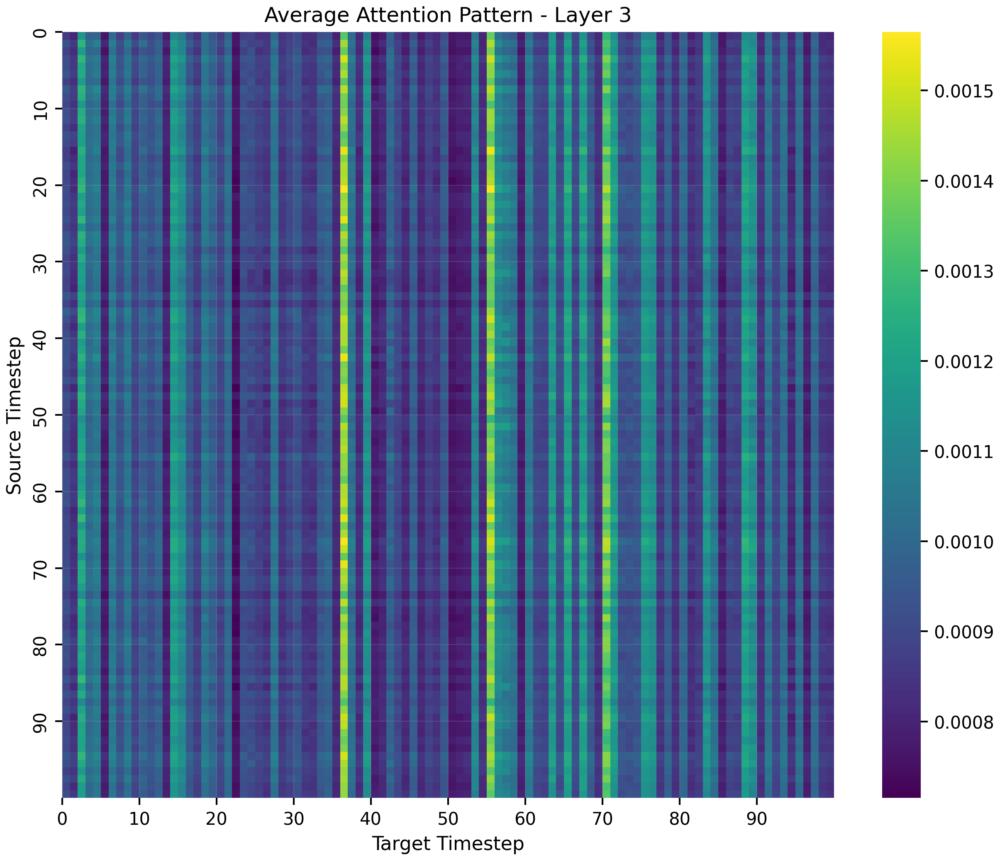

Layer 4
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


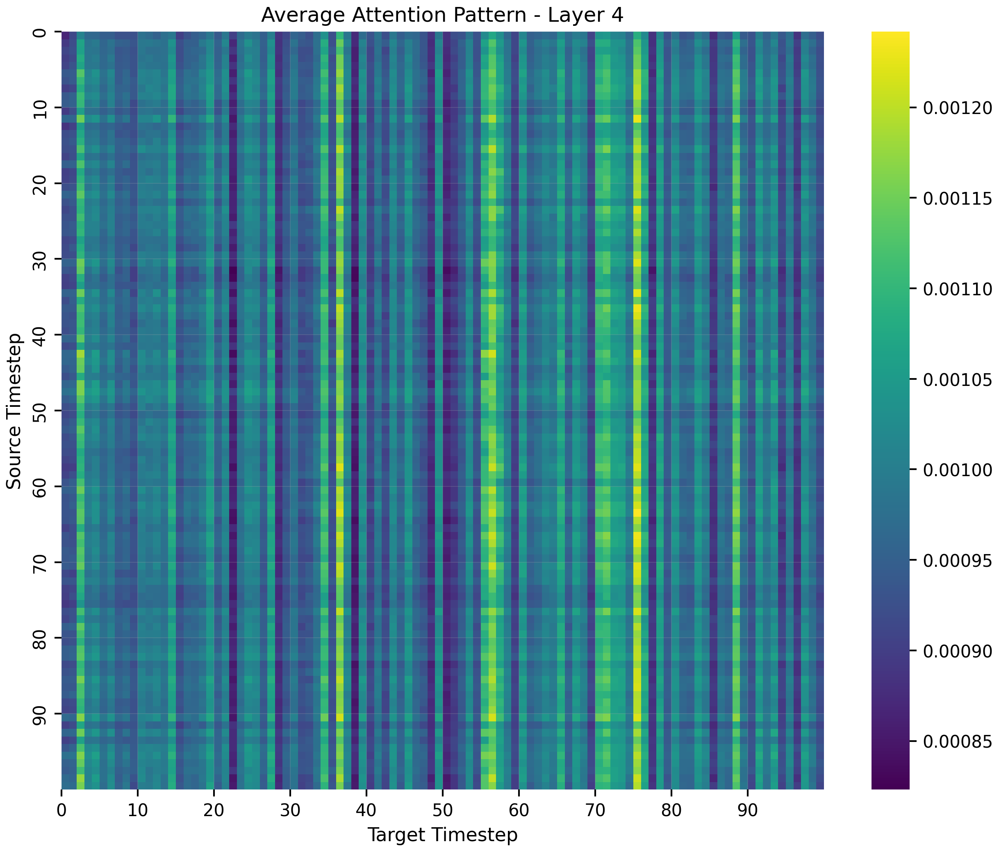

Layer 5
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


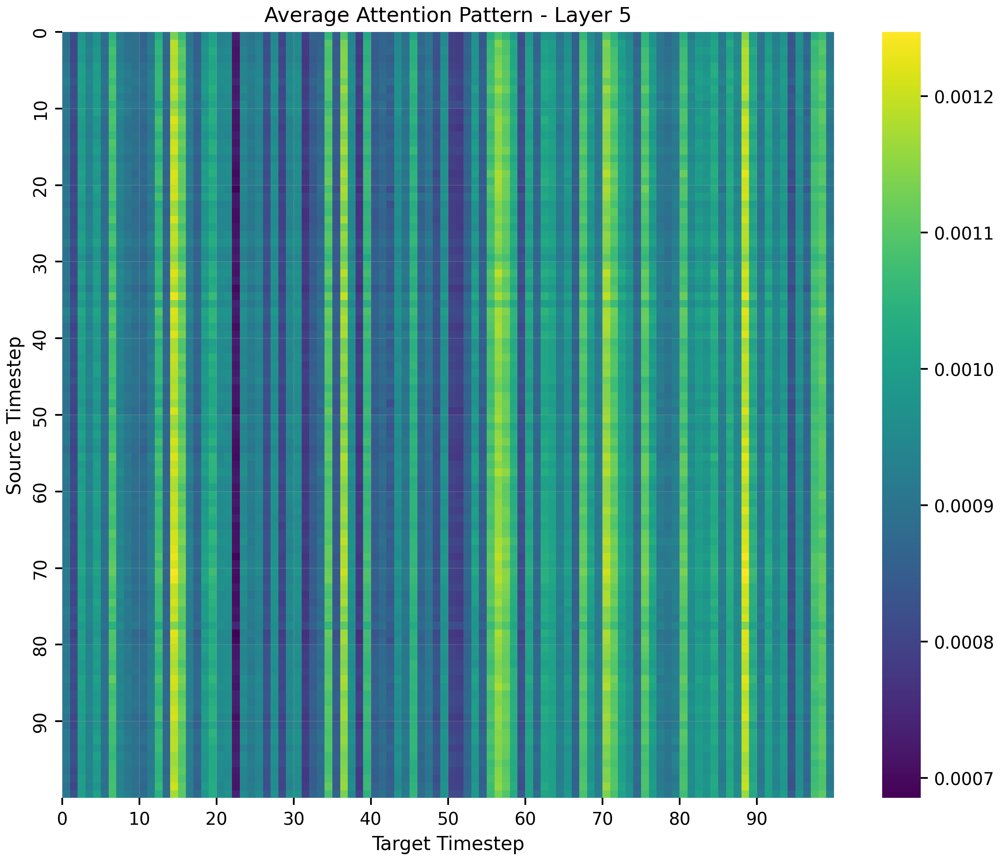

Layer 6
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


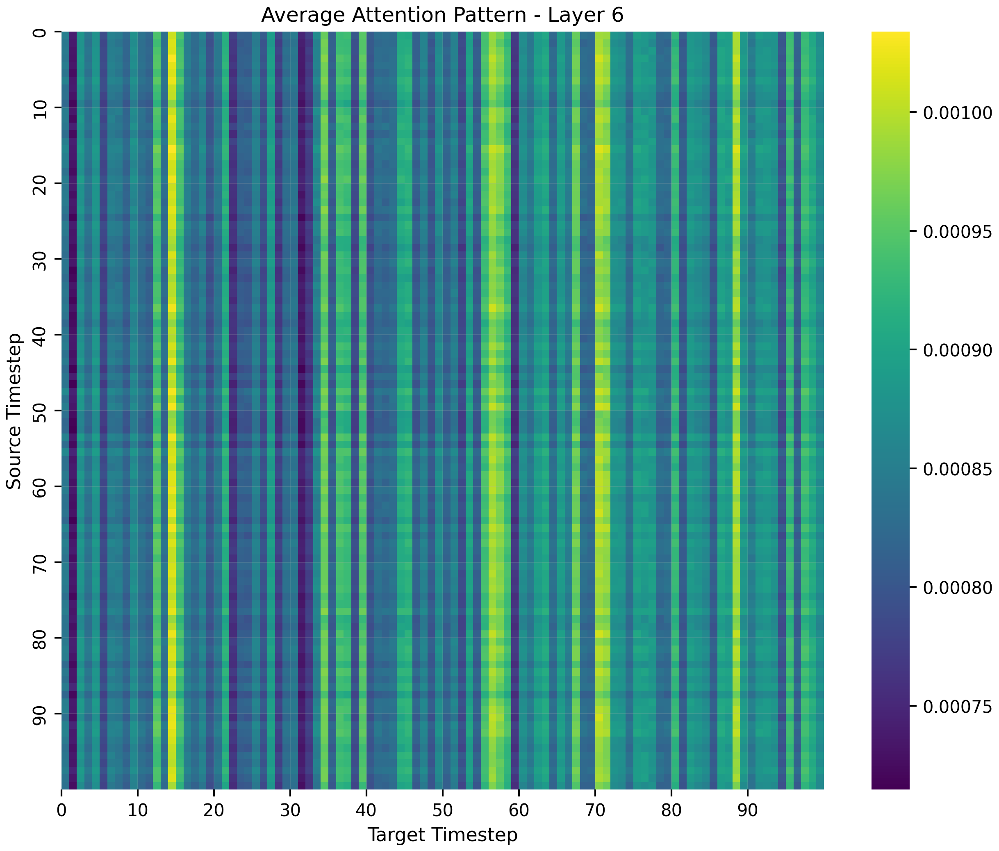

Layer 7
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


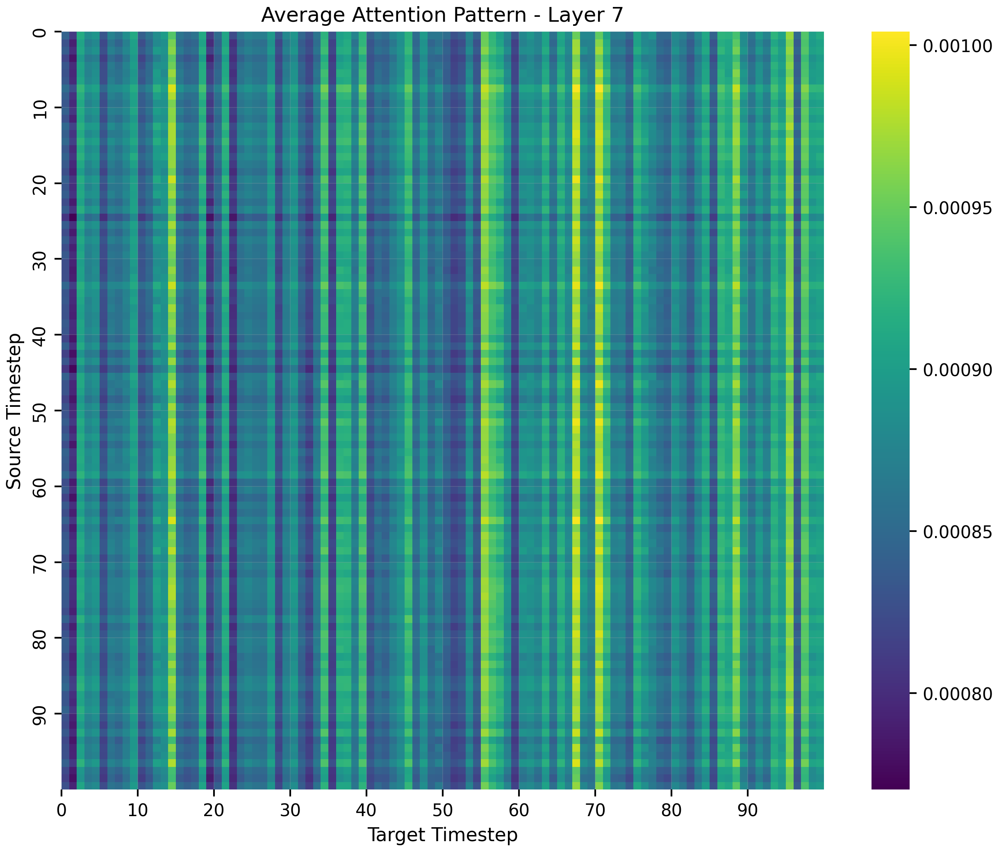

Layer 8
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


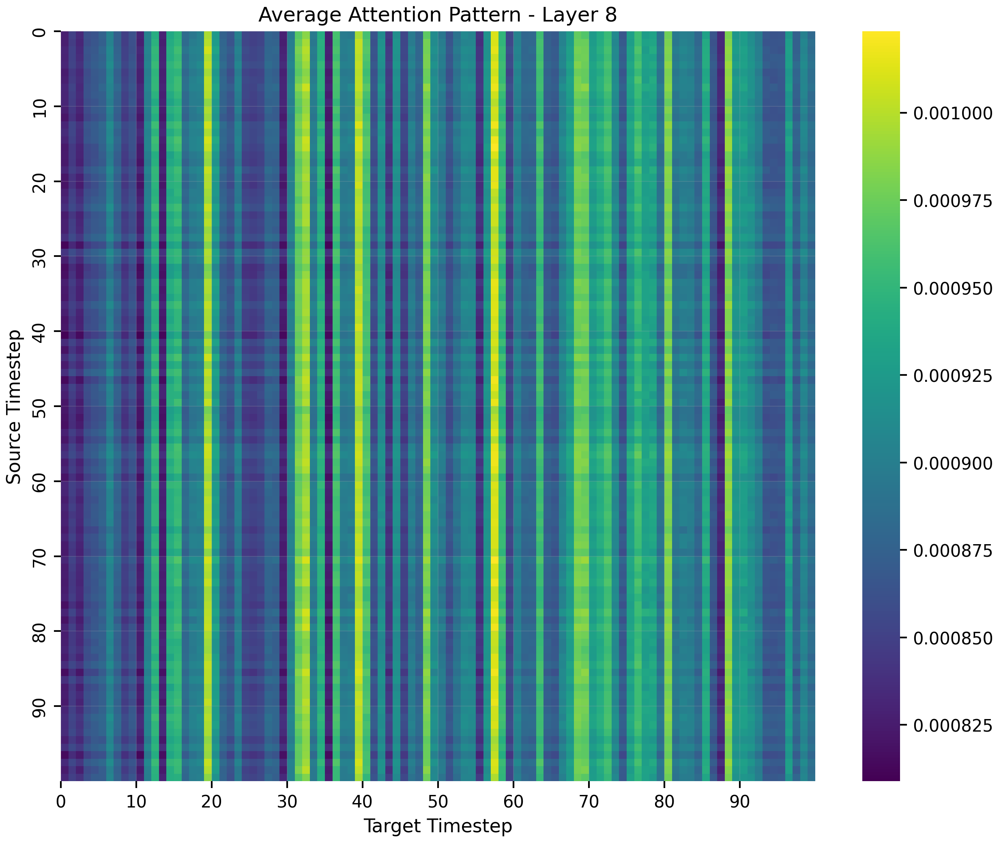

Layer 9
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


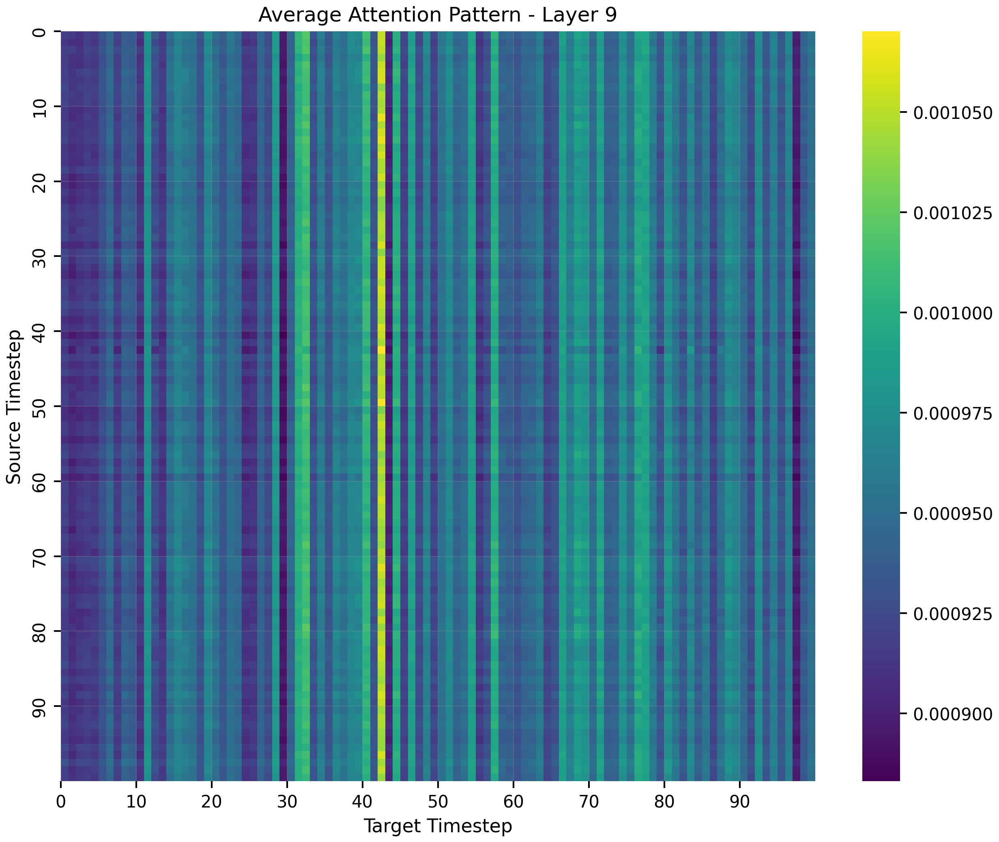

Layer 10
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


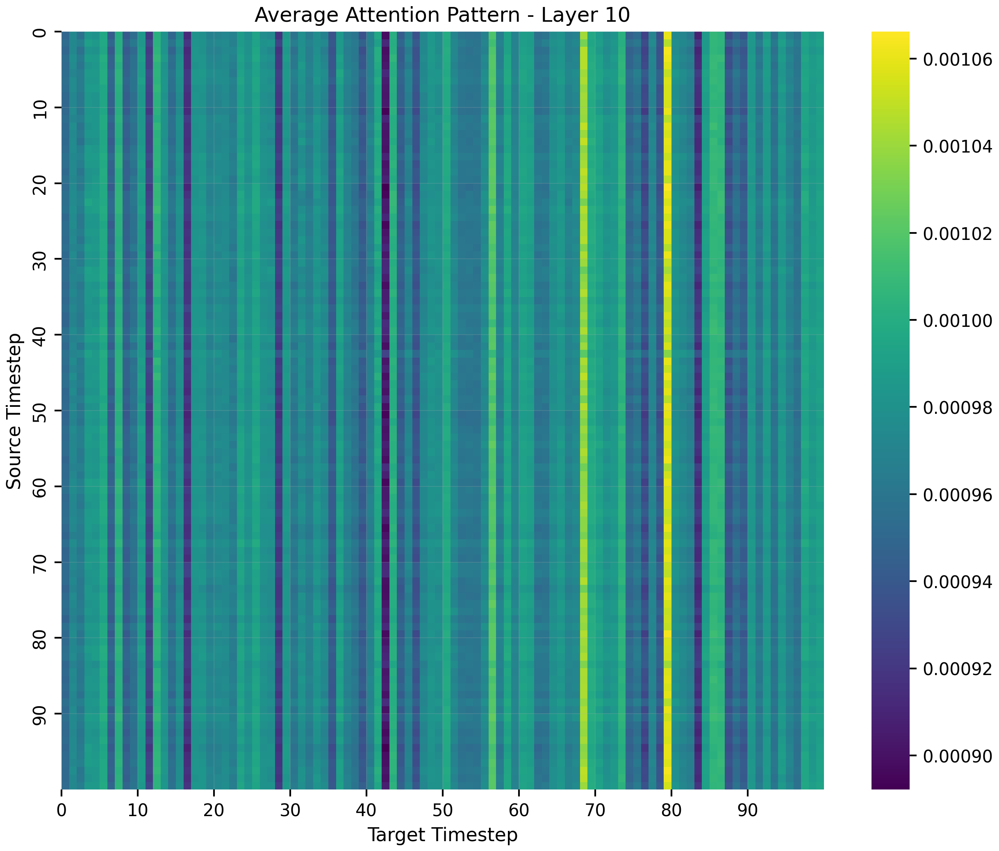

Layer 11
Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


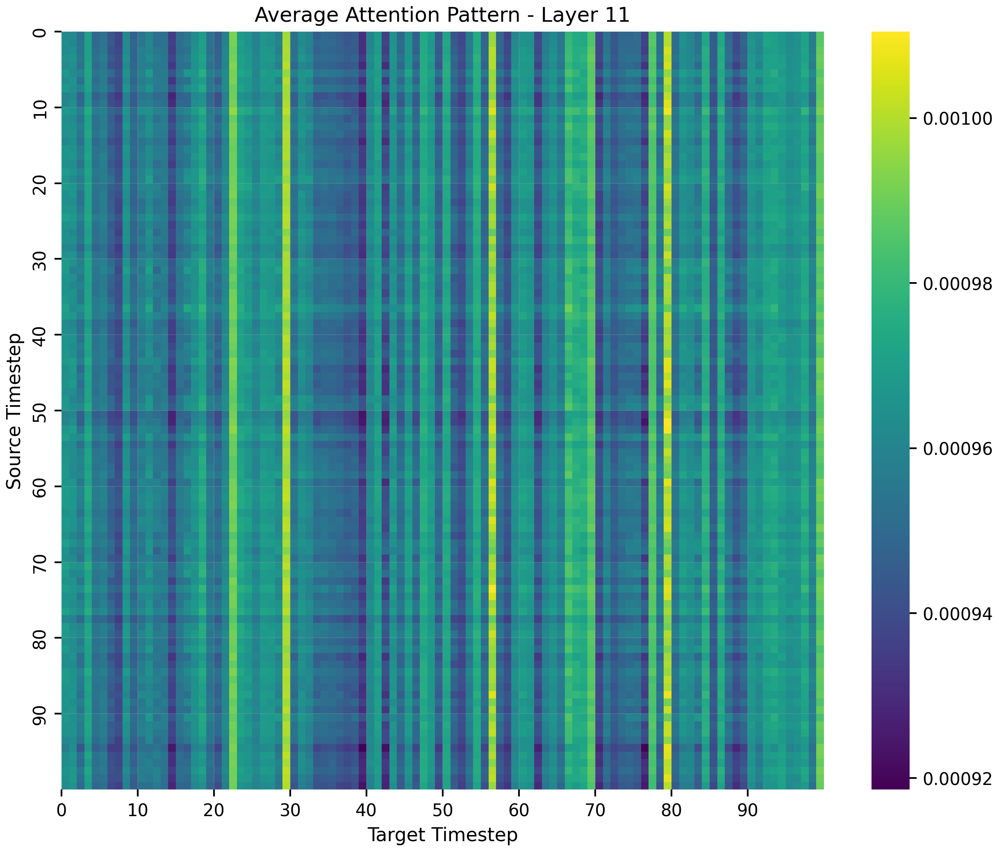

In [311]:
avg_attns = []
for layer in range(model.config.num_hidden_layers):  # Assuming 4 layers
    print(f"Layer {layer}")
    avg_attns.append(plot_average_attention(model, trajs[0, :, :], window_size=100,
                                            start_idx=0, layer_id=layer))

In [312]:
avg_attn = np.mean(avg_attns, axis=0)

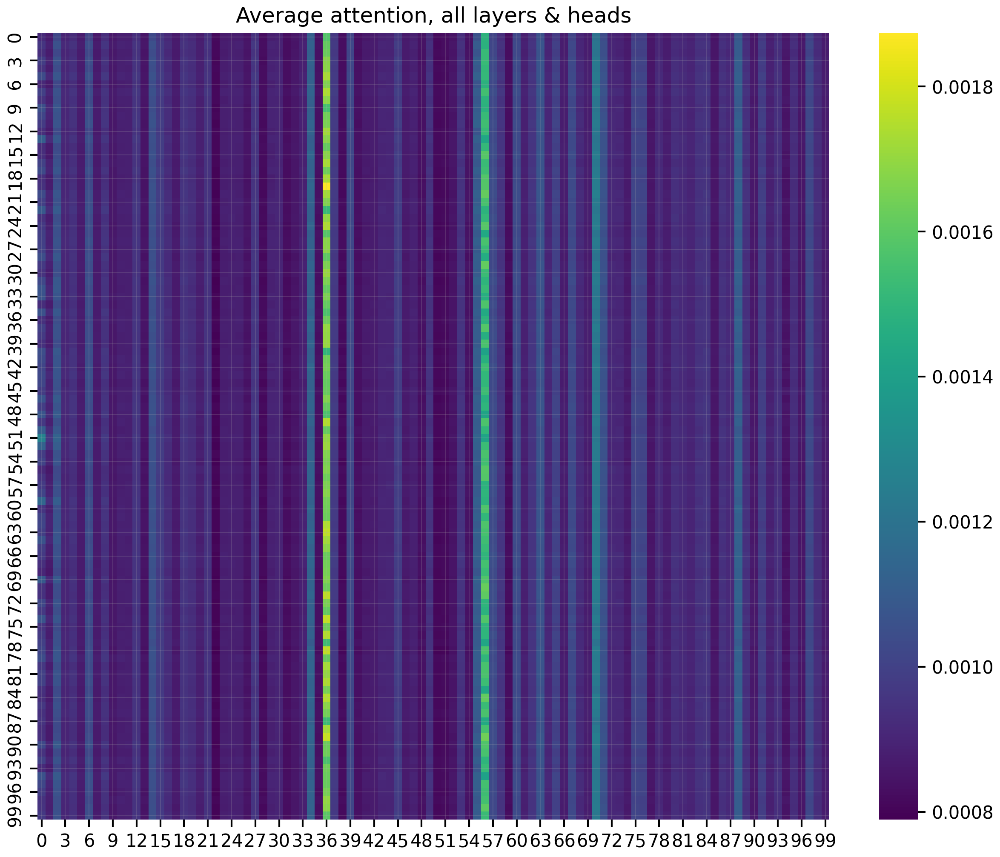

In [313]:
plt.figure(figsize=(10, 8))
sns.heatmap(avg_attn, cmap='viridis')
plt.title(f'Average attention, all layers & heads')
plt.show()

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]


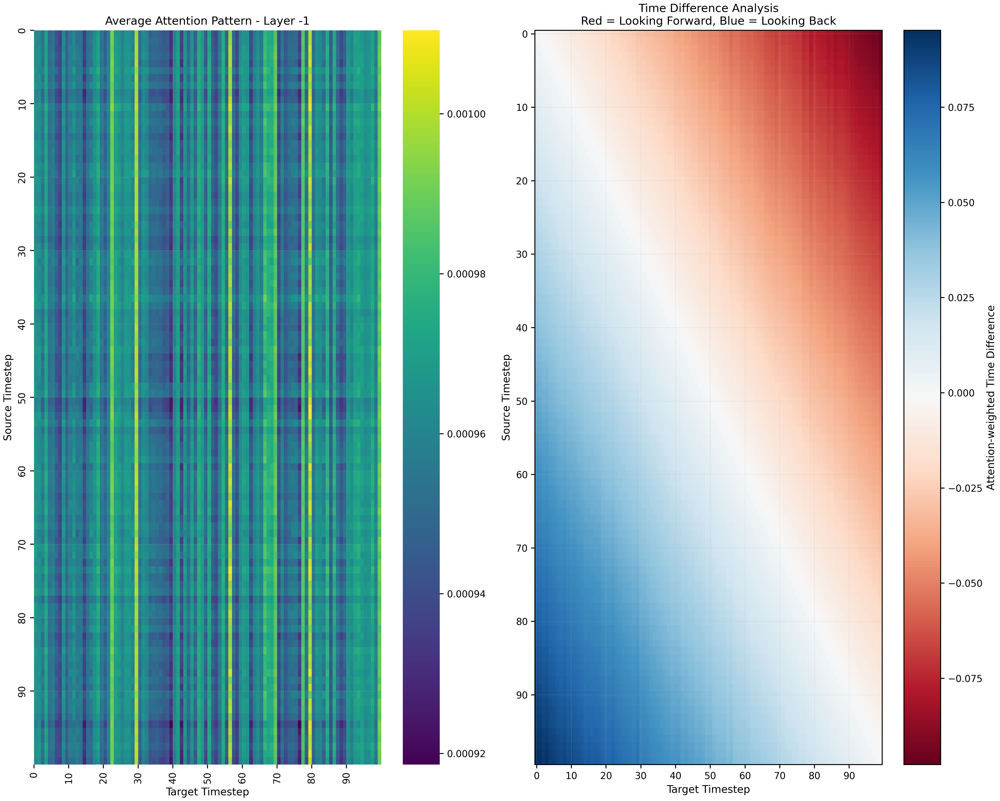

In [314]:
# Look at a single section with time differences
plot_attention_with_time_diff(
    model, 
    trajs[0, :, :],
    window_size=100,
    start_idx=0,
    layer_id=-1
)

Output keys: dict_keys(['trajectory', 'last_hidden_state', 'attentions', 'state'])
Attention tensor shape: [torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000]), torch.Size([1, 24, 1000, 1000])]

Attention Pattern Statistics Across Trajectory:

Time Difference Stats:

Section 0 (timesteps 0-50):
  Mean absolute time difference: 0.016
  Std of time differences: 0.020
  Max looking backward: -0.058
  Max looking forward: 0.073

Section 1 (timesteps 316-366):
  Mean absolute time difference: 0.015
  Std of time differences: 0.019
  Max looking backward: -0.055
  Max looking forward: 0.050

Section 2 (timesteps 633-683):
  Mean absolute time difference: 0.016
  Std of time differences: 

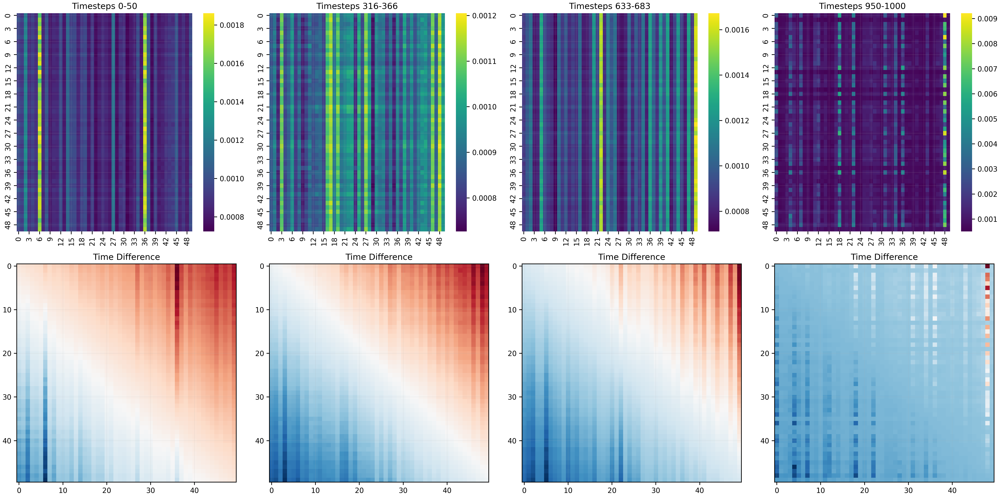

In [315]:
# Compare patterns across the trajectory
analyze_attention_across_trajectory(
    model,
    trajs[0, :, :],
    n_sections=4,
    window_size=50,
    layer_id=0
)